# Capstone Project - Computer Vision Pneumonia Detection Challenge

    Opacity is a term healthcare professionals use in reference to a lung CT scan.

    This is a radiological term that refers to the hazy gray areas on images made by CT scans or X-rays.

    Typically, the lungs appear black on a CT scan or X-ray. This shows that they are free of blockages. When gray areas are visible instead, 
    it means that something is partially filling this area inside the lungs.

    These gray areas are referred to as ground-glass opacity. Ground-glass opacity can be a sign of:

        - fluid, pus, or cells filling the air space
        - walls of the alveoli thickening
        - space between the lungs thickening

    Opacities in the lungs can be caused by a variety of both acute and chronic concerns. Some potential reasons for lung opacity 
    include:

        - pneumonia
        - COVID-19
        - pneumonitis
        - EVALI
        - interstitial lung disease
        - pulmonary edema
        - alveolar hemorrhage
        - lung cancer

    Pneumonia is an infection in one or both lungs caused by bacteria, viruses, or fungi. The infection leads to inflammation in the air sacs 
    of the lungs, which are called alveoli. The alveoli fill with fluid or pus, making it difficult to breathe.

    An X-ray helps your doctor look for signs of inflammation in your chest. If inflammation is present, the X-ray can also inform your doctor 
    about its location and extent.

    CT scans provide a clearer and more detailed picture of your lungs.


    Medical images are stored in a special format called DICOM files (*.dcm). They contain a combination of header metadata as well as 
    underlying raw image arrays for pixel data.

# Printing Machine Information:

In [1]:
import platform
import socket
import psutil

print("\n\nAVAILABLE SYSTEM RESOURCES FOR CAPSTONE PROJECT:\n")
print("***************************************************************************\n\n")
print("PLATFORM - ",platform.system())
print("")
print("PLATFORM - RELEASE - ",platform.release())
print("")
print("PLATFORM - VERSION - ",platform.version())
print("")
print("ARCHITECTURE - ",platform.machine())
print("")
print("HOST NAME - ",socket.gethostname())
print("")
print("PROCESSOR - ",platform.processor())
print("")
print("RAM - ",str(round(psutil.virtual_memory().total / (1024.0 **3)))+" GB")
print("\n\n***************************************************************************\n\n")



AVAILABLE SYSTEM RESOURCES FOR CAPSTONE PROJECT:

***************************************************************************


PLATFORM -  Windows

PLATFORM - RELEASE -  10

PLATFORM - VERSION -  10.0.22621

ARCHITECTURE -  AMD64

HOST NAME -  MSI

PROCESSOR -  Intel64 Family 6 Model 141 Stepping 1, GenuineIntel

RAM -  8 GB


***************************************************************************




# Project Objective: Design a DL based algorithm for detecting pneumonia

# 1. Milestone 1:

## Step 1: Import the data. 

In [136]:
# Import all the necessary libraries

import numpy as np
import pandas as pd


%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.gridspec as gridspec
import seaborn as sns
from PIL import Image
from IPython.display import display


import os
import shutil
from pathlib import Path
import pathlib
from zipfile import ZipFile
from glob import glob
import six.moves.urllib as urllib
import sys
import tarfile

from collections import defaultdict
from io import StringIO

import cv2
import pydicom as dicom
from pydicom.pixel_data_handlers import convert_color_space
from pydicom.pixel_data_handlers.util import apply_color_lut

from fastai.basics import *
from fastai.callback.all import *
from fastai.vision.all import *
from fastai.medical.imaging import *

from tqdm import tqdm

import pickle as pkl

from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential  # initial NN
from tensorflow.keras.layers import Activation, Dense, Dropout, BatchNormalization # construct each layer
from tensorflow.keras.layers import Conv2D, SeparableConv2D 
from tensorflow.keras.layers import MaxPooling2D # swipe across by pool size
from tensorflow.keras.layers import Flatten, GlobalAveragePooling2D, GlobalMaxPooling2D
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.preprocessing import image
from tensorflow.keras.metrics import Precision, Recall, SparseCategoricalAccuracy
from tensorflow.keras.applications.vgg16 import preprocess_input,decode_predictions
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.densenet import DenseNet169
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Reshape

from keras.callbacks import EarlyStopping
from keras.utils.vis_utils import plot_model
from keras.models import model_from_json
from keras.preprocessing.image import ImageDataGenerator
from keras.applications.imagenet_utils import preprocess_input
from keras.callbacks import ModelCheckpoint
from keras.callbacks import ReduceLROnPlateau
from keras.applications.vgg16 import VGG16
from keras.layers import Input
from keras.callbacks import EarlyStopping,ReduceLROnPlateau

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

import warnings 
warnings.filterwarnings('ignore')

    * Loading the Label and Class info and merging them together

In [7]:
train_label = pd.read_csv("stage_2_train_labels.csv")

In [8]:
train_class = pd.read_csv("stage_2_detailed_class_info.csv")

In [28]:
train_label.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,nan,nan,nan,nan,0
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,nan,nan,nan,nan,0
2,00322d4d-1c29-4943-afc9-b6754be640eb,nan,nan,nan,nan,0
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,nan,nan,nan,nan,0
4,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1
5,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1
6,00569f44-917d-4c86-a842-81832af98c30,nan,nan,nan,nan,0
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,nan,nan,nan,nan,0
8,00704310-78a8-4b38-8475-49f4573b2dbb,323.000000,577.000000,160.000000,104.000000,1
9,00704310-78a8-4b38-8475-49f4573b2dbb,695.000000,575.000000,162.000000,137.000000,1


In [29]:
train_label.duplicated().sum()

0

In [30]:
train_class.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity
5,00436515-870c-4b36-a041-de91049b9ab4,Lung Opacity
6,00569f44-917d-4c86-a842-81832af98c30,No Lung Opacity / Not Normal
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,No Lung Opacity / Not Normal
8,00704310-78a8-4b38-8475-49f4573b2dbb,Lung Opacity
9,00704310-78a8-4b38-8475-49f4573b2dbb,Lung Opacity


In [31]:
train_final = pd.merge(train_label, train_class, on ='patientId')

In [32]:
train_final.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,nan,nan,nan,nan,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1,Lung Opacity
5,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1,Lung Opacity
6,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1,Lung Opacity
7,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1,Lung Opacity
8,00569f44-917d-4c86-a842-81832af98c30,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
9,006cec2e-6ce2-4549-bffa-eadfcd1e9970,nan,nan,nan,nan,0,No Lung Opacity / Not Normal


    *Importing the Submission data

In [33]:
test_submission = pd.read_csv("stage_2_sample_submission.csv")

In [34]:
test_submission.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,PredictionString
0,0000a175-0e68-4ca4-b1af-167204a7e0bc,0.5 0 0 100 100
1,0005d3cc-3c3f-40b9-93c3-46231c3eb813,0.5 0 0 100 100
2,000686d7-f4fc-448d-97a0-44fa9c5d3aa6,0.5 0 0 100 100
3,000e3a7d-c0ca-4349-bb26-5af2d8993c3d,0.5 0 0 100 100
4,00100a24-854d-423d-a092-edcf6179e061,0.5 0 0 100 100
5,0015597f-2d69-4bc7-b642-5b5e01534676,0.5 0 0 100 100
6,001b0c51-c7b3-45c1-9c17-fa7594cab96e,0.5 0 0 100 100
7,0022bb50-bf6c-4185-843e-403a9cc1ea80,0.5 0 0 100 100
8,00271e8e-aea8-4f0a-8a34-3025831f1079,0.5 0 0 100 100
9,0028450f-5b8e-4695-9416-8340b6f686b0,0.5 0 0 100 100


In [35]:
test_submission.duplicated().sum()

0

In [36]:
train_final.shape

(37629, 7)

In [37]:
train_final.describe()

,x,y,width,height,Target
count,16957.000000,16957.000000,16957.000000,16957.000000,37629.000000
mean,398.980008,360.443121,219.266675,337.799552,0.450636
std,204.869392,149.202409,59.195268,158.986899,0.497564
min,2.000000,2.000000,40.000000,45.000000,0.000000
25%,209.000000,243.000000,178.000000,210.000000,0.000000
50%,343.000000,355.000000,218.000000,309.000000,0.000000
75%,596.000000,472.000000,259.000000,452.000000,1.000000
max,835.000000,881.000000,528.000000,942.000000,1.000000


In [38]:
train_duplicates_count = train_final.duplicated().sum()

In [39]:
train_duplicates_count

7402

In [40]:
train_duplicates = train_final[train_final.duplicated()]

In [41]:
train_duplicates.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,class
5,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1,Lung Opacity
7,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1,Lung Opacity
11,00704310-78a8-4b38-8475-49f4573b2dbb,323.000000,577.000000,160.000000,104.000000,1,Lung Opacity
13,00704310-78a8-4b38-8475-49f4573b2dbb,695.000000,575.000000,162.000000,137.000000,1,Lung Opacity
19,00aecb01-a116-45a2-956c-08d2fa55433f,288.000000,322.000000,94.000000,135.000000,1,Lung Opacity
21,00aecb01-a116-45a2-956c-08d2fa55433f,547.000000,299.000000,119.000000,165.000000,1,Lung Opacity
23,00c0b293-48e7-4e16-ac76-9269ba535a62,306.000000,544.000000,168.000000,244.000000,1,Lung Opacity
25,00c0b293-48e7-4e16-ac76-9269ba535a62,650.000000,511.000000,206.000000,284.000000,1,Lung Opacity
28,00f08de1-517e-4652-a04f-d1dc9ee48593,181.000000,184.000000,206.000000,506.000000,1,Lung Opacity
30,00f08de1-517e-4652-a04f-d1dc9ee48593,571.000000,275.000000,230.000000,476.000000,1,Lung Opacity


In [42]:
train_final_non_dups = train_final.drop_duplicates(keep='first')

In [43]:
train_final_non_dups = train_final_non_dups.reset_index(drop=True)

In [44]:
train_final.shape

(37629, 7)

In [45]:
train_final_non_dups.shape

(30227, 7)

In [46]:
37629-30227

7402

In [47]:
train_meta_df = train_final_non_dups.copy()

In [48]:
train_meta_df.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,nan,nan,nan,nan,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1,Lung Opacity
5,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1,Lung Opacity
6,00569f44-917d-4c86-a842-81832af98c30,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
8,00704310-78a8-4b38-8475-49f4573b2dbb,323.000000,577.000000,160.000000,104.000000,1,Lung Opacity
9,00704310-78a8-4b38-8475-49f4573b2dbb,695.000000,575.000000,162.000000,137.000000,1,Lung Opacity


In [49]:
train_meta_df.dtypes

patientId     object
x            float64
y            float64
width        float64
height       float64
Target         int64
class         object
dtype: object

In [50]:
train_Lung_Opacity = train_meta_df[train_meta_df["class"] == "Lung Opacity"]
train_Normal = train_meta_df[train_meta_df["class"] == "Normal"]
train_Not_Normal = train_meta_df[train_meta_df["class"] == "No Lung Opacity / Not Normal"]

In [51]:
print("len of Lung opacity",len(train_Lung_Opacity))
print("len of Normal",len(train_Normal))
print("len of Not Normal",len(train_Not_Normal))
print("")

len of Lung opacity 9555
len of Normal 8851
len of Not Normal 11821



In [52]:
Lung_Opacity_Unique = train_Lung_Opacity["patientId"].unique()
Normal_Unique = train_Normal["patientId"].unique()
Not_Normal_Unique = train_Not_Normal["patientId"].unique()

In [53]:
print("No. of Unique Pneumonia PatientIds",len(Lung_Opacity_Unique))
print("No. of Unique Normal PatientIds",len(Normal_Unique))
print("No. of Unique Not Normal",len(Not_Normal_Unique))

No. of Unique Pneumonia PatientIds 6012
No. of Unique Normal PatientIds 8851
No. of Unique Not Normal 11821


In [54]:
print(6012+8851+11821)

26684


    26684 are the Unique rows we get and this exactly matches with the training_images provided to us

In [55]:
print(Lung_Opacity_Unique[:5])
print("")
print(Normal_Unique[:5])
print("")
print(Not_Normal_Unique[:5])
print("")

['00436515-870c-4b36-a041-de91049b9ab4'
 '00704310-78a8-4b38-8475-49f4573b2dbb'
 '00aecb01-a116-45a2-956c-08d2fa55433f'
 '00c0b293-48e7-4e16-ac76-9269ba535a62'
 '00f08de1-517e-4652-a04f-d1dc9ee48593']

['003d8fa0-6bf1-40ed-b54c-ac657f8495c5'
 '009482dc-3db5-48d4-8580-5c89c4f01334'
 '009eb222-eabc-4150-8121-d5a6d06b8ebf'
 '00a85be6-6eb0-421d-8acf-ff2dc0007e8a'
 '00f87de5-5fe0-4921-93ea-914d7e683266']

['0004cfab-14fd-4e49-80ba-63a80b6bddd6'
 '00313ee0-9eaa-42f4-b0ab-c148ed3241cd'
 '00322d4d-1c29-4943-afc9-b6754be640eb'
 '00569f44-917d-4c86-a842-81832af98c30'
 '006cec2e-6ce2-4549-bffa-eadfcd1e9970']



## Step 2: Map training and testing images to its classes.

    Unzipping the Training and Testing Images

In [ ]:
with ZipFile('stage_2_train_images.zip', 'r') as z:
  z.extractall()

In [ ]:
with ZipFile('stage_2_test_images.zip', 'r') as z:
  z.extractall()

    Segregating the Training Images into 3 different folders under "Training" as

        - Lung Opacity
        - Normal
        - Not Normal

In [ ]:
dst1 = "Training"
dst2 = "Lung Opacity"
dst3 = "Normal"
dst4 = "Not Normal"

os.mkdir(dst1)
path1 = os.path.join(dst1,dst2)
path2 = os.path.join(dst1,dst3)
path3 = os.path.join(dst1,dst4)

mode = 0o777

os.mkdir(path1, mode)
os.mkdir(path2, mode)
os.mkdir(path3, mode)

       Copying Pneumonia images to "Training/Lung Opacity" folder

In [ ]:
# Source path
source = "stage_2_train_images"
 
# Destination path
destination = "Training/Lung Opacity"

for item in Lung_Opacity_Unique:
    file = item+".dcm"
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    print("src_file",src_file)
    print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

    Copying Normal Images to "Training/Normal" folder

In [ ]:
# Source path
source = "stage_2_train_images"
 
# Destination path
destination = "Training/Normal"

for item in Normal_Unique:
    file = item+".dcm"
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    print("src_file",src_file)
    print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

    Copying Not Normal images to "Training/Not Normal" folder

In [ ]:
# Source path
source = "stage_2_train_images"
 
# Destination path
destination = "Training/Not Normal"

for item in Not_Normal_Unique:
    file = item+".dcm"
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    print("src_file",src_file)
    print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

    Cross checking the "Training/Lung Opacity" and "Training/Normal" folders to see how many images are available

In [56]:
Lung_opa_list = os.listdir("Training/Lung Opacity") # your directory path
Lung_opa_number_files = len(Lung_opa_list)
print('\nNumber of images in Lung Opacity class after seggregation:',Lung_opa_number_files)

Normal_list = os.listdir("Training/Normal") # your directory path
Normal_number_files = len(Normal_list)
print('\nNumber of images in Normal class after seggregation:',Normal_number_files)

Not_Normal_list = os.listdir("Training/Not Normal") # your directory path
Not_Normal_number_files = len(Not_Normal_list)
print('\nNumber of images in Not Normal class after seggregation:',Not_Normal_number_files)


Number of images in Lung Opacity class after seggregation: 6012

Number of images in Normal class after seggregation: 8851

Number of images in Not Normal class after seggregation: 11821


In [57]:
print("\nNo. of Unique Pneumonia PatientIds :",len(Lung_Opacity_Unique))
print("\nNo. of Unique Normal PatientIds    :",len(Normal_Unique))
print("\nNo. of Unique Not Normal           :",len(Not_Normal_Unique))


No. of Unique Pneumonia PatientIds : 6012

No. of Unique Normal PatientIds    : 8851

No. of Unique Not Normal           : 11821


    All the Unique Pneumonia data rows, Normal & Not Normal data rows are matching with the corresponding Images in the folder

    Maping Training images to folders and corresponding class.

In [58]:
image_dir_path = "Training"

paths = [path.parts[-3:] for path in
         Path(image_dir_path).rglob('*.dcm')]
Images_df = pd.DataFrame(data=paths, columns=['Folder', 'Image_Class', 'Image_file'])

In [59]:
Images_df.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file
0,Training,Lung Opacity,000db696-cf54-4385-b10b-6b16fbb3f985.dcm
1,Training,Lung Opacity,000fe35a-2649-43d4-b027-e67796d412e0.dcm
2,Training,Lung Opacity,001031d9-f904-4a23-b3e5-2c088acd19c6.dcm
3,Training,Lung Opacity,001916b8-3d30-4935-a5d1-8eaddb1646cd.dcm
4,Training,Lung Opacity,0022073f-cec8-42ec-ab5f-bc2314649235.dcm
5,Training,Lung Opacity,002cb550-2e31-42f1-a29d-fbc279977e71.dcm
6,Training,Lung Opacity,00436515-870c-4b36-a041-de91049b9ab4.dcm
7,Training,Lung Opacity,00704310-78a8-4b38-8475-49f4573b2dbb.dcm
8,Training,Lung Opacity,0087bd3a-55a7-4045-b111-b018fa52d361.dcm
9,Training,Lung Opacity,00a05408-8291-4231-886e-13763e103161.dcm


In [60]:
Images_df.tail(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file
26664,Training,Not Normal,ffb8998b-f262-4330-820d-bf48a4d8fec1.dcm
26665,Training,Not Normal,ffc01e64-ba14-4620-8016-235fc1609767.dcm
26666,Training,Not Normal,ffcfe8c1-5641-4dc3-910c-573e3227f536.dcm
26667,Training,Not Normal,ffd0c212-bfb6-41e3-b17b-b927b99d1730.dcm
26668,Training,Not Normal,ffd2bc74-f9d6-49fb-84d7-de060ee22583.dcm
26669,Training,Not Normal,ffd670a5-b6dc-4f54-928a-69b7a04662eb.dcm
26670,Training,Not Normal,ffdc771e-1f1a-47f7-b732-3e06e48c24e8.dcm
26671,Training,Not Normal,ffdc957e-6239-427d-8a54-fdf8ced3a356.dcm
26672,Training,Not Normal,ffde3879-241c-4b03-9d91-625cae6b49e8.dcm
26673,Training,Not Normal,ffde3e7e-849c-4077-bfd0-4e4498ee8817.dcm


In [61]:
Images_df["Full_filename"] = Images_df["Folder"]+"/"+Images_df["Image_Class"]+"/"+Images_df["Image_file"]

In [62]:
Images_df.head(25).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file,Full_filename
0,Training,Lung Opacity,000db696-cf54-4385-b10b-6b16fbb3f985.dcm,Training/Lung Opacity/000db696-cf54-4385-b10b-6b16fbb3f985.dcm
1,Training,Lung Opacity,000fe35a-2649-43d4-b027-e67796d412e0.dcm,Training/Lung Opacity/000fe35a-2649-43d4-b027-e67796d412e0.dcm
2,Training,Lung Opacity,001031d9-f904-4a23-b3e5-2c088acd19c6.dcm,Training/Lung Opacity/001031d9-f904-4a23-b3e5-2c088acd19c6.dcm
3,Training,Lung Opacity,001916b8-3d30-4935-a5d1-8eaddb1646cd.dcm,Training/Lung Opacity/001916b8-3d30-4935-a5d1-8eaddb1646cd.dcm
4,Training,Lung Opacity,0022073f-cec8-42ec-ab5f-bc2314649235.dcm,Training/Lung Opacity/0022073f-cec8-42ec-ab5f-bc2314649235.dcm
5,Training,Lung Opacity,002cb550-2e31-42f1-a29d-fbc279977e71.dcm,Training/Lung Opacity/002cb550-2e31-42f1-a29d-fbc279977e71.dcm
6,Training,Lung Opacity,00436515-870c-4b36-a041-de91049b9ab4.dcm,Training/Lung Opacity/00436515-870c-4b36-a041-de91049b9ab4.dcm
7,Training,Lung Opacity,00704310-78a8-4b38-8475-49f4573b2dbb.dcm,Training/Lung Opacity/00704310-78a8-4b38-8475-49f4573b2dbb.dcm
8,Training,Lung Opacity,0087bd3a-55a7-4045-b111-b018fa52d361.dcm,Training/Lung Opacity/0087bd3a-55a7-4045-b111-b018fa52d361.dcm
9,Training,Lung Opacity,00a05408-8291-4231-886e-13763e103161.dcm,Training/Lung Opacity/00a05408-8291-4231-886e-13763e103161.dcm


In [63]:
Images_df.describe()

,Folder,Image_Class,Image_file,Full_filename
count,26684,26684,26684,26684
unique,1,3,26684,26684
top,Training,Not Normal,000db696-cf54-4385-b10b-6b16fbb3f985.dcm,Training/Lung Opacity/000db696-cf54-4385-b10b-6b16fbb3f985.dcm
freq,26684,11821,1,1


In [64]:
# creating instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values and storing in another column
Images_df['Image_Class_Category'] = labelencoder.fit_transform(Images_df['Image_Class'])

In [65]:
Images_df['Image_Target'] = Images_df['Image_Class'].apply(lambda x: 1 if x == 'Lung Opacity' else 0)

In [66]:
Images_df.dtypes

Folder                  object
Image_Class             object
Image_file              object
Full_filename           object
Image_Class_Category     int32
Image_Target             int64
dtype: object

    Pickling Images_df dataframe for future reference

In [67]:
Images_df.to_pickle("Images_df.pkl") 

    Unpickling Images_dataframe

In [68]:
unpickled_df = pd.read_pickle("Images_df.pkl")

In [69]:
Images_df = unpickled_df.copy()

In [70]:
Images_df.dtypes

Folder                  object
Image_Class             object
Image_file              object
Full_filename           object
Image_Class_Category     int32
Image_Target             int64
dtype: object

In [71]:
Images_df.head(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file,Full_filename,Image_Class_Category,Image_Target
0,Training,Lung Opacity,000db696-cf54-4385-b10b-6b16fbb3f985.dcm,Training/Lung Opacity/000db696-cf54-4385-b10b-6b16fbb3f985.dcm,0,1
1,Training,Lung Opacity,000fe35a-2649-43d4-b027-e67796d412e0.dcm,Training/Lung Opacity/000fe35a-2649-43d4-b027-e67796d412e0.dcm,0,1
2,Training,Lung Opacity,001031d9-f904-4a23-b3e5-2c088acd19c6.dcm,Training/Lung Opacity/001031d9-f904-4a23-b3e5-2c088acd19c6.dcm,0,1
3,Training,Lung Opacity,001916b8-3d30-4935-a5d1-8eaddb1646cd.dcm,Training/Lung Opacity/001916b8-3d30-4935-a5d1-8eaddb1646cd.dcm,0,1
4,Training,Lung Opacity,0022073f-cec8-42ec-ab5f-bc2314649235.dcm,Training/Lung Opacity/0022073f-cec8-42ec-ab5f-bc2314649235.dcm,0,1
5,Training,Lung Opacity,002cb550-2e31-42f1-a29d-fbc279977e71.dcm,Training/Lung Opacity/002cb550-2e31-42f1-a29d-fbc279977e71.dcm,0,1
6,Training,Lung Opacity,00436515-870c-4b36-a041-de91049b9ab4.dcm,Training/Lung Opacity/00436515-870c-4b36-a041-de91049b9ab4.dcm,0,1
7,Training,Lung Opacity,00704310-78a8-4b38-8475-49f4573b2dbb.dcm,Training/Lung Opacity/00704310-78a8-4b38-8475-49f4573b2dbb.dcm,0,1
8,Training,Lung Opacity,0087bd3a-55a7-4045-b111-b018fa52d361.dcm,Training/Lung Opacity/0087bd3a-55a7-4045-b111-b018fa52d361.dcm,0,1
9,Training,Lung Opacity,00a05408-8291-4231-886e-13763e103161.dcm,Training/Lung Opacity/00a05408-8291-4231-886e-13763e103161.dcm,0,1


    Function to display randomly selected Images and its labels

In [72]:
def show_images(passed_value):
    show_df = Images_df.sample(n=passed_value)
    if passed_value/5 == 0:
        z = math.ceil(passed_value/5)
    else:
            z = math.ceil((passed_value)/5)

    fig, ax = plt.subplots(z,5,constrained_layout=True)
    fig.set_figheight(20)
    fig.set_figwidth(20)
    
    i = 0
    j = 0

    for index, row in show_df.iterrows():
        image_path = row['Full_filename']
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array

        height_1 = 224
        width_1 = 224
        dim = (width_1, height_1)
        img_resize = cv2.resize(img, dim, interpolation=cv2.INTER_LINEAR)

        ax[i][j].imshow(img_resize, cmap=plt.cm.bone)
        ax[i][j].set_title(row['Image_Class'])
        
        j = j+1
        if j == 5:
            i = i+1
            j = 0
    plt.figure().clear()
    plt.show()
    return(show_df)

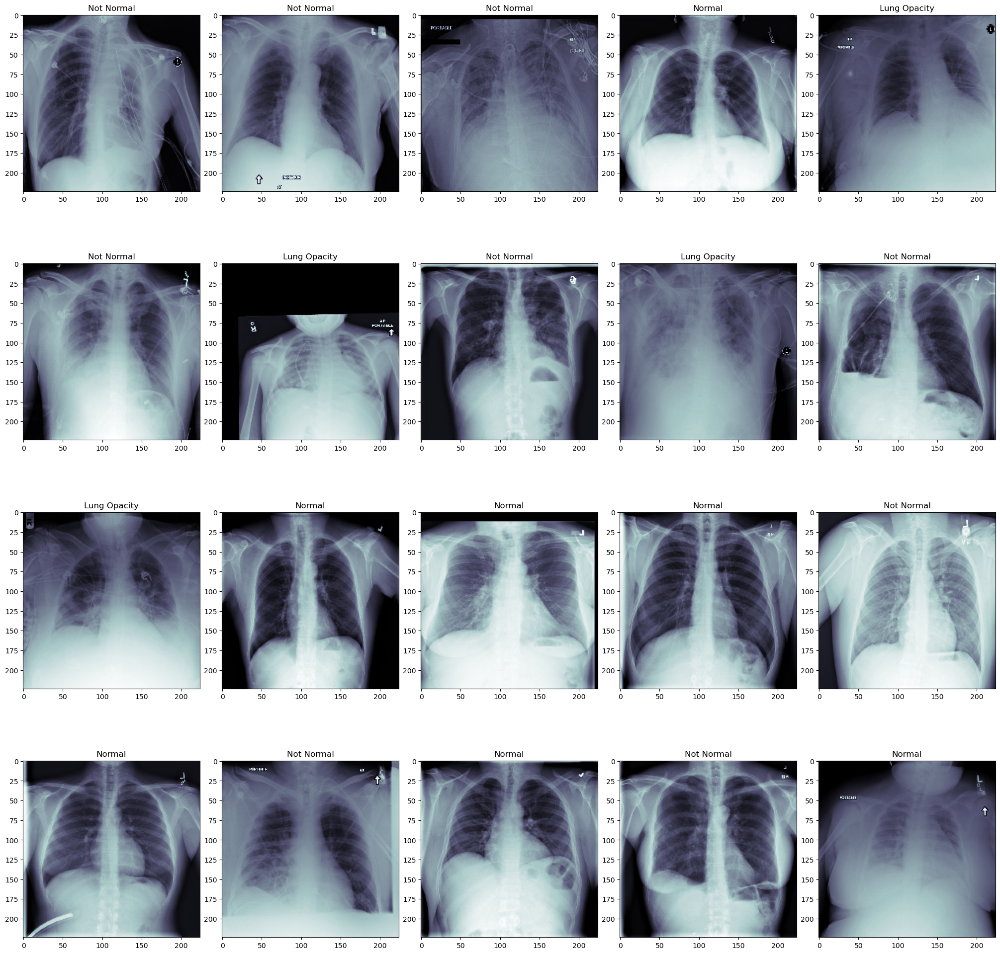

<Figure size 640x480 with 0 Axes>

,Folder,Image_Class,Image_file,Full_filename,Image_Class_Category,Image_Target
15613,Training,Not Normal,1f929e8d-0289-4712-806b-8894c2ba2f93.dcm,Training/Not Normal/1f929e8d-0289-4712-806b-8894c2ba2f93.dcm,2,0
21995,Training,Not Normal,a616c756-c1f4-4c3b-af81-cc51695d4fe4.dcm,Training/Not Normal/a616c756-c1f4-4c3b-af81-cc51695d4fe4.dcm,2,0
21703,Training,Not Normal,a03bf35b-b57b-4cd0-bac4-c5d7c13a168a.dcm,Training/Not Normal/a03bf35b-b57b-4cd0-bac4-c5d7c13a168a.dcm,2,0
6639,Training,Normal,197146c0-dfe6-4938-ab89-5fbef34150fc.dcm,Training/Normal/197146c0-dfe6-4938-ab89-5fbef34150fc.dcm,1,0
2660,Training,Lung Opacity,7860706e-b07d-4c69-b17c-03ca4f8e8a95.dcm,Training/Lung Opacity/7860706e-b07d-4c69-b17c-03ca4f8e8a95.dcm,0,1
18912,Training,Not Normal,6a17292a-fcef-423b-a7a2-046b6923d559.dcm,Training/Not Normal/6a17292a-fcef-423b-a7a2-046b6923d559.dcm,2,0
5445,Training,Lung Opacity,de304f9b-f407-43d5-89b9-bdb07f8308b1.dcm,Training/Lung Opacity/de304f9b-f407-43d5-89b9-bdb07f8308b1.dcm,0,1
23503,Training,Not Normal,cca50e52-2b44-40ba-84e7-430aa3ff3f98.dcm,Training/Not Normal/cca50e52-2b44-40ba-84e7-430aa3ff3f98.dcm,2,0
627,Training,Lung Opacity,1a2cef8e-99cb-43cc-b9b5-65fe5104037f.dcm,Training/Lung Opacity/1a2cef8e-99cb-43cc-b9b5-65fe5104037f.dcm,0,1
20246,Training,Not Normal,818a1ce8-68ef-4cdd-b92d-f09ba72c692b.dcm,Training/Not Normal/818a1ce8-68ef-4cdd-b92d-f09ba72c692b.dcm,2,0


In [73]:
show_images(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

## Step 3: Map training and testing images to its annotations.

    *Using fastai to read dcm images and extract Metadata

In [51]:
img = 'stage_2_train_images/0004cfab-14fd-4e49-80ba-63a80b6bddd6.dcm'

sample_md = dicom.filereader.dcmread(img)

sample_md

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 202
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Secondary Capture Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0002, 0010) Transfer Syntax UID                 UI: JPEG Baseline (Process 1)
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.0
(0002, 0013) Implementation Version Name         SH: 'OFFIS_DCMTK_360'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0016) SOP Class UID                       UI: Secondary Capture Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.276.0.7230010.3.1.4.8323329.28530.1517874485.775526
(0008, 0020) Study Date                          DA: '19010101'
(0008, 0030) Study Time      

In [45]:
items_train = get_dicom_files('stage_2_train_images/')

dicom_train = pd.DataFrame.from_dicoms(items_train).reset_index(drop = True)

In [ ]:
dicom_train.to_csv("dicom_train.csv", index = False)

In [50]:
dicom_train = pd.read_csv("dicom_train.csv")

dicom_train.columns

Index(['SpecificCharacterSet', 'SOPClassUID', 'SOPInstanceUID', 'StudyDate',
       'StudyTime', 'AccessionNumber', 'Modality', 'ConversionType',
       'ReferringPhysicianName', 'SeriesDescription', 'PatientName',
       'PatientID', 'PatientBirthDate', 'PatientSex', 'PatientAge',
       'BodyPartExamined', 'ViewPosition', 'StudyInstanceUID',
       'SeriesInstanceUID', 'StudyID', 'SeriesNumber', 'InstanceNumber',
       'PatientOrientation', 'SamplesPerPixel', 'PhotometricInterpretation',
       'Rows', 'Columns', 'MultiPixelSpacing', 'PixelSpacing', 'PixelSpacing1',
       'BitsAllocated', 'BitsStored', 'HighBit', 'PixelRepresentation',
       'LossyImageCompression', 'LossyImageCompressionMethod', 'fname',
       'img_min', 'img_max', 'img_mean', 'img_std', 'img_pct_window'],
      dtype='object')

In [51]:
dicom_train.sample(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,SpecificCharacterSet,SOPClassUID,SOPInstanceUID,StudyDate,StudyTime,AccessionNumber,Modality,ConversionType,ReferringPhysicianName,SeriesDescription,PatientName,PatientID,PatientBirthDate,PatientSex,PatientAge,BodyPartExamined,ViewPosition,StudyInstanceUID,SeriesInstanceUID,StudyID,SeriesNumber,InstanceNumber,PatientOrientation,SamplesPerPixel,PhotometricInterpretation,Rows,Columns,MultiPixelSpacing,PixelSpacing,PixelSpacing1,BitsAllocated,BitsStored,HighBit,PixelRepresentation,LossyImageCompression,LossyImageCompressionMethod,fname,img_min,img_max,img_mean,img_std,img_pct_window
10461,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.11678.1517874359.879033,19010101,0.000000,nan,CR,WSD,nan,view: AP,7200a1e9-eba0-4ced-bdd3-88544f162af0,7200a1e9-eba0-4ced-bdd3-88544f162af0,nan,M,22,CHEST,AP,1.2.276.0.7230010.3.1.2.8323329.11678.1517874359.879032,1.2.276.0.7230010.3.1.3.8323329.11678.1517874359.879031,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.139000,0.139000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\7200a1e9-eba0-4ced-bdd3-88544f162af0.dcm,0,-1,104.294415,60.594108,0.318659
16693,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.30440.1517874499.861241,19010101,0.000000,nan,CR,WSD,nan,view: AP,a8e8e360-1c06-4932-820f-cc0066da187e,a8e8e360-1c06-4932-820f-cc0066da187e,nan,F,66,CHEST,AP,1.2.276.0.7230010.3.1.2.8323329.30440.1517874499.861240,1.2.276.0.7230010.3.1.3.8323329.30440.1517874499.861239,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.139000,0.139000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\a8e8e360-1c06-4932-820f-cc0066da187e.dcm,0,-1,127.899700,53.511569,0.164686
9149,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.4081.1517874305.819620,19010101,0.000000,nan,CR,WSD,nan,view: PA,672a7b2f-f672-46c5-b876-bad17cd8a567,672a7b2f-f672-46c5-b876-bad17cd8a567,nan,F,34,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.4081.1517874305.819619,1.2.276.0.7230010.3.1.3.8323329.4081.1517874305.819618,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.194311,0.194311,8,8,7,0,1,ISO_10918_1,stage_2_train_images\672a7b2f-f672-46c5-b876-bad17cd8a567.dcm,0,-105,111.929241,28.378863,0.162151
18352,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.29517.1517874492.355669,19010101,0.000000,nan,CR,WSD,nan,view: PA,b7637d3c-fa05-45c1-816a-1bbb95f07af1,b7637d3c-fa05-45c1-816a-1bbb95f07af1,nan,F,48,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.29517.1517874492.355668,1.2.276.0.7230010.3.1.3.8323329.29517.1517874492.355667,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.194311,0.194311,8,8,7,0,1,ISO_10918_1,stage_2_train_images\b7637d3c-fa05-45c1-816a-1bbb95f07af1.dcm,0,-1,101.650616,42.187196,0.139111
7953,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.9763.1517874344.754173,19010101,0.000000,nan,CR,WSD,nan,view: PA,5d2bf120-562a-484a-a2db-65953e2fc734,5d2bf120-562a-484a-a2db-65953e2fc734,nan,M,70,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.9763.1517874344.754172,1.2.276.0.7230010.3.1.3.8323329.9763.1517874344.754171,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.168000,0.168000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\5d2bf120-562a-484a-a2db-65953e2fc734.dcm,5,-1,180.103366,49.422149,0.044318
25042,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.21164.1517874432.567653,19010101,0.000000,nan,CR,WSD,nan,view: PA,f1d6dbca-db29-41d4-9b6f-2b30fd6e9f69,f1d6dbca-db29-41d4-9b6f-2b30fd6e9f69,nan,M,20,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.21164.1517874432.567652,1.2.276.0.7230010.3.1.3.8323329.21164.1517874432.567651,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.143000,0.143000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\f1d6dbca-db29-41d4-9b6f-2b30fd6e9f69.dcm,0,-1,106.378491,71.737520,0.247437
9792,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.21830.1517874437.331503,19010101,0.000000,nan,CR,WSD,nan,view: PA,6c5b9330-09d6-4181-ba38-afcbbc00dc3b,6c5b9330-09d6-4181-ba38-afcbbc00dc3b,nan,F,56,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.21830.1517874437.331502,1.2.276.0.

In [52]:
len(dicom_train)

26684

    All the metadata for 26684 images have been extracted into dicom_train dataframe

In [53]:
train_meta_df.head(10).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,class
0,0004cfab-14fd-4e49-80ba-63a80b6bddd6,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
1,00313ee0-9eaa-42f4-b0ab-c148ed3241cd,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
2,00322d4d-1c29-4943-afc9-b6754be640eb,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
3,003d8fa0-6bf1-40ed-b54c-ac657f8495c5,nan,nan,nan,nan,0,Normal
4,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000,1,Lung Opacity
5,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000,1,Lung Opacity
6,00569f44-917d-4c86-a842-81832af98c30,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
7,006cec2e-6ce2-4549-bffa-eadfcd1e9970,nan,nan,nan,nan,0,No Lung Opacity / Not Normal
8,00704310-78a8-4b38-8475-49f4573b2dbb,323.000000,577.000000,160.000000,104.000000,1,Lung Opacity
9,00704310-78a8-4b38-8475-49f4573b2dbb,695.000000,575.000000,162.000000,137.000000,1,Lung Opacity


    This was the training dataframe with patientid, bounding boxes for Lung opacity, class and Target information 

In [54]:
print("length of train labels, class dataframe",len(train_meta_df))
print("length of metadata dataframe...........",len(dicom_train))

length of train labels, class dataframe 30227
length of metadata dataframe........... 26684


    we need to merge both these dataframes to have one single dataframe with all the following information
        - patientid
        - bounding box info
        - class
        - target
        - filname
        - Metadata information

In [55]:
# Merge the metadata with training data on PatientID / patientId
dicom_metadata_final = pd.merge(train_meta_df, dicom_train, left_on='patientId', right_on='PatientID')

In [56]:
len(dicom_metadata_final)

30227

In [57]:
dicom_metadata_final.duplicated().sum()

0

In [58]:
dicom_metadata_final = dicom_metadata_final.drop(columns = 'PatientID')

In [59]:
dicom_metadata_final.sample(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,class,SpecificCharacterSet,SOPClassUID,SOPInstanceUID,StudyDate,StudyTime,AccessionNumber,Modality,ConversionType,ReferringPhysicianName,SeriesDescription,PatientName,PatientBirthDate,PatientSex,PatientAge,BodyPartExamined,ViewPosition,StudyInstanceUID,SeriesInstanceUID,StudyID,SeriesNumber,InstanceNumber,PatientOrientation,SamplesPerPixel,PhotometricInterpretation,Rows,Columns,MultiPixelSpacing,PixelSpacing,PixelSpacing1,BitsAllocated,BitsStored,HighBit,PixelRepresentation,LossyImageCompression,LossyImageCompressionMethod,fname,img_min,img_max,img_mean,img_std,img_pct_window
9548,6850e324-6105-4e8e-961e-6ae2f5e71e66,nan,nan,nan,nan,0,Normal,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.11171.1517874356.976841,19010101,0.000000,nan,CR,WSD,nan,view: PA,6850e324-6105-4e8e-961e-6ae2f5e71e66,nan,F,48,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.11171.1517874356.976840,1.2.276.0.7230010.3.1.3.8323329.11171.1517874356.976839,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.143000,0.143000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\6850e324-6105-4e8e-961e-6ae2f5e71e66.dcm,0,-4,92.979630,72.874497,0.369698
1636,17aba977-7b64-47b0-acb0-d41abba1fcbc,nan,nan,nan,nan,0,Normal,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.10787.1517874354.42396,19010101,0.000000,nan,CR,WSD,nan,view: PA,17aba977-7b64-47b0-acb0-d41abba1fcbc,nan,F,27,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.10787.1517874354.42395,1.2.276.0.7230010.3.1.3.8323329.10787.1517874354.42394,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.139000,0.139000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\17aba977-7b64-47b0-acb0-d41abba1fcbc.dcm,0,-32,130.799788,54.465151,0.130149
17309,a5b3340e-0054-48c2-9966-fe9e2af21da7,nan,nan,nan,nan,0,No Lung Opacity / Not Normal,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.24477.1517874454.716740,19010101,0.000000,nan,CR,WSD,nan,view: PA,a5b3340e-0054-48c2-9966-fe9e2af21da7,nan,F,43,CHEST,PA,1.2.276.0.7230010.3.1.2.8323329.24477.1517874454.716739,1.2.276.0.7230010.3.1.3.8323329.24477.1517874454.716738,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.143000,0.143000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\a5b3340e-0054-48c2-9966-fe9e2af21da7.dcm,0,-7,150.781827,69.885828,0.174041
10714,71576c22-51ce-4510-98d8-6933e0b9b810,279.000000,301.000000,160.000000,297.000000,1,Lung Opacity,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.14071.1517874377.339450,19010101,0.000000,nan,CR,WSD,nan,view: AP,71576c22-51ce-4510-98d8-6933e0b9b810,nan,M,25,CHEST,AP,1.2.276.0.7230010.3.1.2.8323329.14071.1517874377.339449,1.2.276.0.7230010.3.1.3.8323329.14071.1517874377.339448,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.168000,0.168000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\71576c22-51ce-4510-98d8-6933e0b9b810.dcm,0,-1,95.796071,61.864365,0.230841
18086,ab9069f0-1511-414d-b37a-2920517004d4,48.000000,692.000000,240.000000,281.000000,1,Lung Opacity,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.1571.1517874291.616328,19010101,0.000000,nan,CR,WSD,nan,view: AP,ab9069f0-1511-414d-b37a-2920517004d4,nan,F,52,CHEST,AP,1.2.276.0.7230010.3.1.2.8323329.1571.1517874291.616327,1.2.276.0.7230010.3.1.3.8323329.1571.1517874291.616326,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.168000,0.168000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\ab9069f0-1511-414d-b37a-2920517004d4.dcm,0,-23,125.423249,49.520973,0.151056
20890,be03b6e9-e030-4491-b23e-ac1d7efc73bb,254.000000,150.000000,290.000000,272.000000,1,Lung Opacity,ISO_IR 100,1.2.840.10008.5.1.4.1.1.7,1.2.276.0.7230010.3.1.4.8323329.7469.1517874331.758564,19010101,0.000000,nan,CR,WSD,nan,view: AP,be03b6e9-e030-4491-b23e-ac1d7efc73bb,nan,M,63,CHEST,AP,1.2.276.0.7230010.3.1.2.8323329.7469.1517874331.758563,1.2.276.0.7230010.3.1.3.8323329.7469.1517874331.758562,nan,1,1,nan,1,MONOCHROME2,1024,1024,1,0.139000,0.139000,8,8,7,0,1,ISO_10918_1,stage_2_train_images\be03b6e9-e030-4491-b23e-ac1d7efc73bb.dcm,0,-1,132.337021,49.335950,0.149296


    Now this dicom_metadata_final dataframe has all the 30227 rows with all the information

        - patientid
        - bounding box co-ordinates
        - class
        - target
        - filename
        - metadata information

In [67]:
# Save the merged metadata file to a csv file for future reference
#dicom_metadata_final.to_csv('dicom_metadata_final.csv')
dicom_metadata_final.shape

(30227, 49)

## Step 4: Preprocessing and Visualisation of different classes 

    Pulling out randomly some Images with different classes 

        - Lung Opacity
        - Normal
        - Not Normal


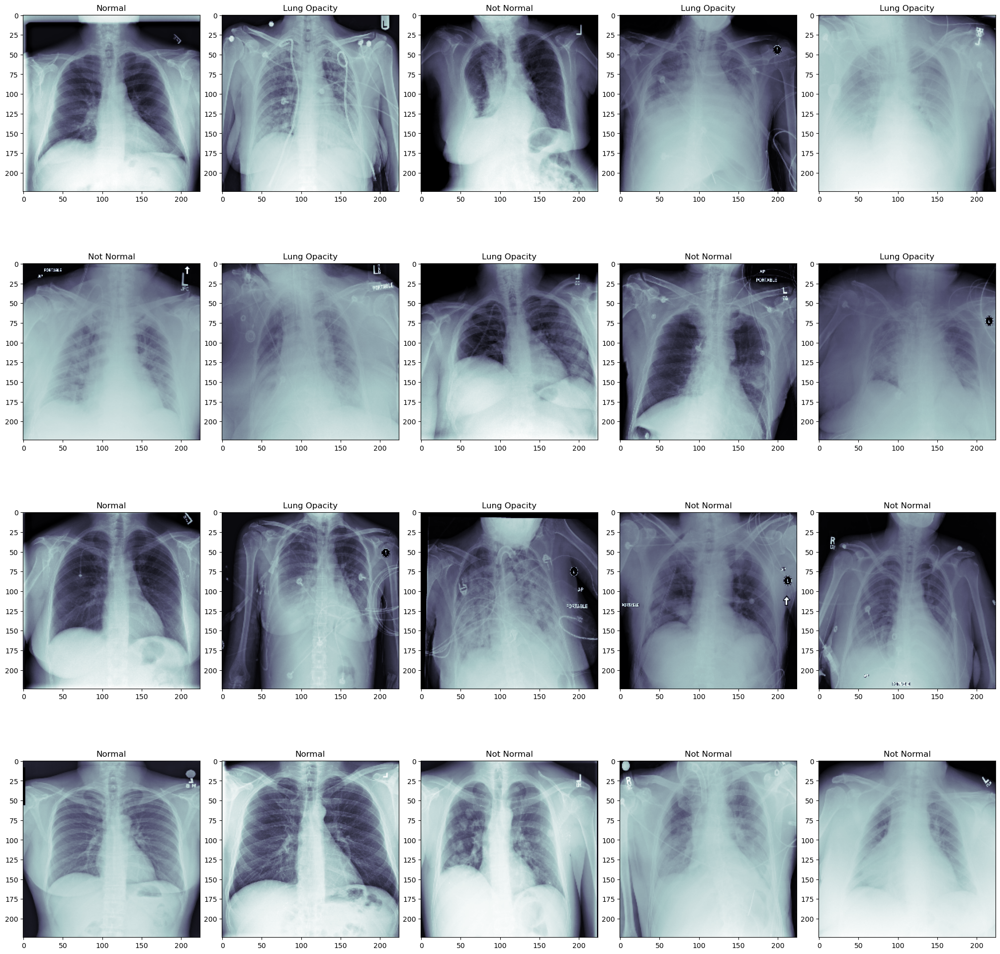

<Figure size 640x480 with 0 Axes>

,Folder,Image_Class,Image_file,Full_filename,Image_Class_Category,Image_Target
14756,Training,Normal,fd7047e2-1865-4f07-89fa-75a86c79409a.dcm,Training/Normal/fd7047e2-1865-4f07-89fa-75a86c79409a.dcm,1,0
1492,Training,Lung Opacity,3c4a89ed-4338-4410-8848-a0bf226f6e21.dcm,Training/Lung Opacity/3c4a89ed-4338-4410-8848-a0bf226f6e21.dcm,0,1
22238,Training,Not Normal,aa93c84b-e688-4e5e-a950-78dc063bcabc.dcm,Training/Not Normal/aa93c84b-e688-4e5e-a950-78dc063bcabc.dcm,2,0
5304,Training,Lung Opacity,d5be0945-b546-4640-b0a0-d2dd209122e8.dcm,Training/Lung Opacity/d5be0945-b546-4640-b0a0-d2dd209122e8.dcm,0,1
1441,Training,Lung Opacity,3b3d0da3-cfb5-42c8-a195-6ac03626a11f.dcm,Training/Lung Opacity/3b3d0da3-cfb5-42c8-a195-6ac03626a11f.dcm,0,1
18620,Training,Not Normal,654b2bfc-5d84-42f8-8f8c-61288c661242.dcm,Training/Not Normal/654b2bfc-5d84-42f8-8f8c-61288c661242.dcm,2,0
4811,Training,Lung Opacity,be2a8801-3cc0-4c24-a73a-a1e13ff94948.dcm,Training/Lung Opacity/be2a8801-3cc0-4c24-a73a-a1e13ff94948.dcm,0,1
5480,Training,Lung Opacity,e0af96b5-9e91-4cc7-84c7-a3d04d4c9405.dcm,Training/Lung Opacity/e0af96b5-9e91-4cc7-84c7-a3d04d4c9405.dcm,0,1
23480,Training,Not Normal,cc548ac0-8784-4430-86af-02e1c6bc36c1.dcm,Training/Not Normal/cc548ac0-8784-4430-86af-02e1c6bc36c1.dcm,2,0
3243,Training,Lung Opacity,9341907e-9b62-4197-a0b3-3ddd3c55a884.dcm,Training/Lung Opacity/9341907e-9b62-4197-a0b3-3ddd3c55a884.dcm,0,1


In [80]:
show_images(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

In [70]:
plt.show()

    Randomly picking up and showcasing them

        - 5 Lung Opacity class images
        - 5 Normal class Images
        - 5 Not Normal class Images

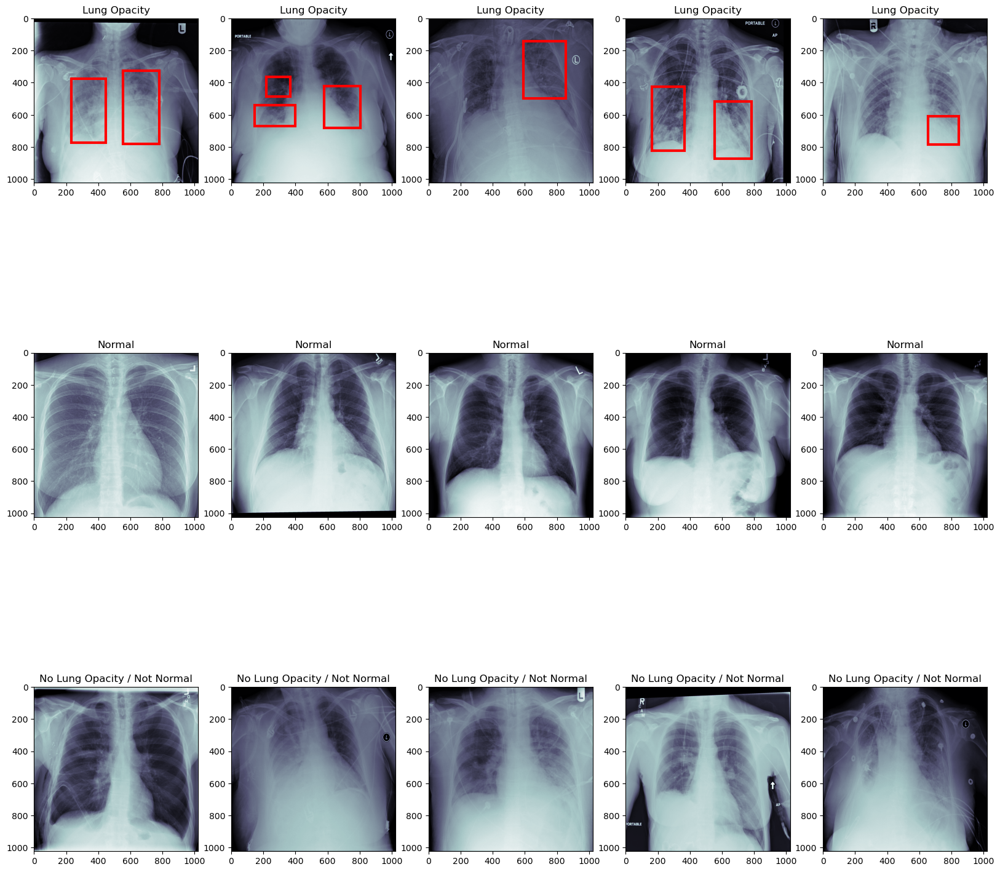

<Figure size 640x480 with 0 Axes>

In [64]:
import random

sample_data1 = random.sample(list(Lung_Opacity_Unique), 5)
sample_data2 = random.sample(list(Normal_Unique), 5)
sample_data3 = random.sample(list(Not_Normal_Unique), 5)

samples = sample_data1+sample_data2+sample_data3

fig, ax = plt.subplots(3,5)
fig.set_figheight(20)
fig.set_figwidth(20)
i = 0
j = 0

for loop_1 in samples:
    pat_id_1 = loop_1
    no_ind = train_meta_df[train_meta_df['patientId'] == pat_id_1].index.values
    l_ind = len(no_ind)
    fname = pat_id_1+".dcm"
    image_path = "stage_2_train_images/"+fname
    ds = dicom.dcmread(image_path)
    img = ds.pixel_array
    
    X = 0
    Y = 0
    width = 0
    height = 0
    rect = []

    ax[i][j].imshow(img, cmap=plt.cm.bone)
    for k in range(l_ind):
        X = train_meta_df.iloc[no_ind[k],1]
        Y = train_meta_df.iloc[no_ind[k],2]
        width = train_meta_df.iloc[no_ind[k],3]
        height = train_meta_df.iloc[no_ind[k],4]
        title = train_meta_df.iloc[no_ind[k],6]
        rect.append(patches.Rectangle((X, Y), width, height,linewidth = 3,edgecolor = 'r',facecolor = 'none'))
        ax[i][j].add_patch(rect[k])
        ax[i][j].set_title(title)
    j = j+1
    if j == 5:
        i = i+1
        j = 0
plt.figure().clear()
plt.show()

    Exploratory Data Analysis and Visualization of Metadata

    Univariate analysis

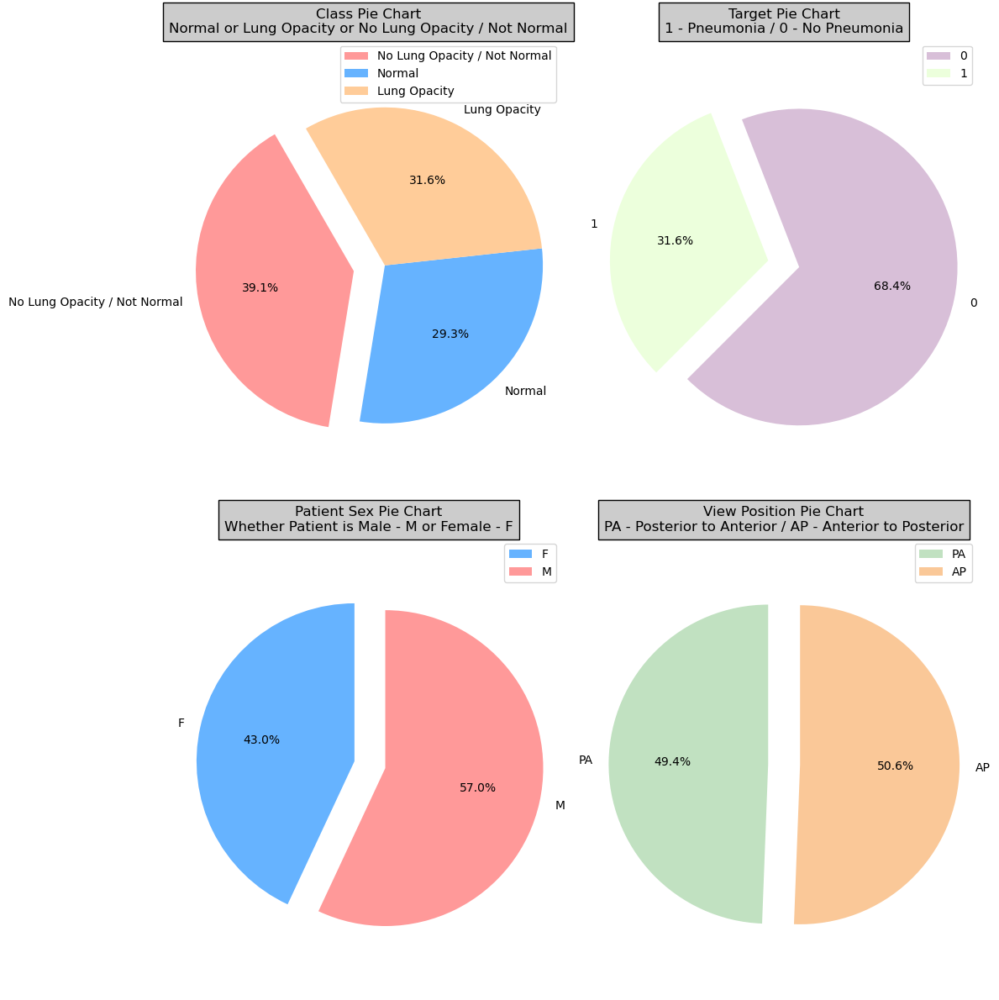

In [81]:
fig, ax = plt.subplots(2,2)
fig.set_figheight(12)
fig.set_figwidth(12)

# UNIVARIATE ANALYSIS
#1. CLASS - NORMAL, LUNG OPACITY, NO LUNG OPACITY / NOT NORMAL
my_labels1 = dicom_metadata_final['class'].unique()
colors1 = ['#ff9999','#66b3ff','#ffcc99']
my_explode1 = [0.2,0,0]
ax[0][0].pie(dicom_metadata_final['class'].value_counts(sort = False),startangle=120,autopct='%1.1f%%',
        colors = colors1,explode = my_explode1,labels = my_labels1)
ax[0][0].set_title("Class Pie Chart\n" + "Normal or Lung Opacity or No Lung Opacity / Not Normal", bbox={'facecolor':'0.8', 'pad':5})
ax[0][0].legend(labels = my_labels1, loc="best")
ax[0][0].axis('equal')

#2. TARGET - 0 - NO PNEUMONIA / 1 - PNEUMONIA
my_labels2 = dicom_metadata_final['Target'].unique()
colors2 = ['#D8BFD8','#ECFFDC']
my_explode2 = [0,0.2]
ax[0][1].pie(dicom_metadata_final['Target'].value_counts(sort = False),startangle=225,autopct='%1.1f%%',
        labels = my_labels2,colors = colors2,explode = my_explode2)
ax[0][1].set_title("Target Pie Chart\n" + "1 - Pneumonia / 0 - No Pneumonia", bbox={'facecolor':'0.8', 'pad':5})
ax[0][1].legend(labels = my_labels2, loc="best")
ax[0][1].axis('equal')

#3. PATIENT SEX - M - MALE / F - FEMALE
my_labels3 = dicom_metadata_final['PatientSex'].unique()
colors3 = ['#66b3ff','#ff9999']
my_explode3 = [0,0.2]
ax[1][0].pie(dicom_metadata_final['PatientSex'].value_counts(sort = False),startangle=90,autopct='%1.1f%%',
        labels = my_labels3,colors = colors3,explode = my_explode3)
ax[1][0].set_title("Patient Sex Pie Chart\n" + "Whether Patient is Male - M or Female - F", bbox={'facecolor':'0.8', 'pad':5})
ax[1][0].legend(labels = my_labels3, loc="best")
ax[1][0].axis('equal')

#4. VIEW POSITION - PA - POSTERIOR TO ANTERIOR / AP - ANTERIOR TO POSTERIOR
my_labels4 = dicom_metadata_final['ViewPosition'].unique()
colors4 = ['#C1E1C1','#FAC898']
my_explode4 = [0,0.2]
ax[1][1].pie(dicom_metadata_final['ViewPosition'].value_counts(sort = False),startangle=90,autopct='%1.1f%%',
        labels = my_labels4,colors = colors4,explode = my_explode4)
ax[1][1].set_title("View Position Pie Chart\n" + "PA - Posterior to Anterior / AP - Anterior to Posterior", bbox={'facecolor':'0.8', 'pad':5})
ax[1][1].legend(labels = my_labels4, loc="best")
ax[1][1].axis('equal')

fig.tight_layout()
plt.show()

    Observations:

        - Pneumonia is about 1/3 of the cases and Non-Pneumonia are 2/3 of the cases
        - More Males have got themselves checked than Females
        - There is almost equal proportions of ViewPositions

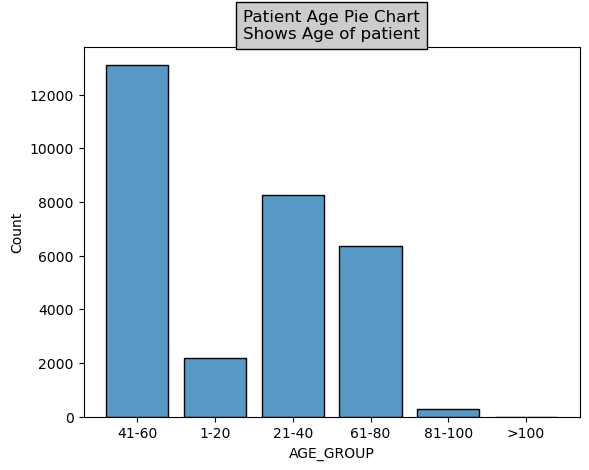

In [82]:
# CREATE A NEW COLUMN "AGE GROUP" AND ADD TO dicom_metadata_df

# ASSIGN THE VALUE BASED ON PATIENT AGE. FOR EX: 1-20, 21-40, 41-60, 61-80, 81-100, >100

AGE = []

dicom_metadata_final['PatientAge'] = dicom_metadata_final['PatientAge'].astype("int64")

for i in np.arange(0, dicom_metadata_final['PatientAge'].value_counts().sum(),1):
    if (dicom_metadata_final['PatientAge'][i] > 0) and (dicom_metadata_final['PatientAge'][i] <= 20):
        AGE.append('1-20')
    elif (dicom_metadata_final['PatientAge'][i] > 20) and (dicom_metadata_final['PatientAge'][i] <= 40):
        AGE.append('21-40')
    elif (dicom_metadata_final['PatientAge'][i] > 40) and (dicom_metadata_final['PatientAge'][i] <= 60):
        AGE.append('41-60')
    elif (dicom_metadata_final['PatientAge'][i] > 60) and (dicom_metadata_final['PatientAge'][i] <= 80):
        AGE.append('61-80')
    elif (dicom_metadata_final['PatientAge'][i] > 80) and (dicom_metadata_final['PatientAge'][i] <= 100):
        AGE.append('81-100')
    else :
        AGE.append('>100')
        
AGE = pd.Series(AGE)

dicom_metadata_final['AGE_GROUP'] = AGE.values



# AGE GROUP - PATIENT AGE GROUP - [1-20, 21-40, 41-60, 61-80, 81-100, >100]

sns.histplot(data = dicom_metadata_final, x = "AGE_GROUP",multiple="dodge", shrink=.8,palette = "Spectral")

plt.title("Patient Age Pie Chart\n" + "Shows Age of patient", bbox={'facecolor':'0.8', 'pad':5})

plt.show()

        There seems to be some issues while collecting Age information, there are quite a few age reported above 100,
        which might not be true, there was one number even reported as 155.  I guess those are mistakes hence converting Age into bins of 

        - 01 - 20
        - 21 - 40
        - 41 - 60
        - 61 - 80
        - 81 - 100
        - greater than 100

    when observed there are large number of patients between 41-60 followed by 21-40, 61-80 and relatively lesser number of patients
    between 1 - 20, 81 - 100 and > 100

    this observation looks logically correct since there will be very less patients in the largest age category 81-100 and > 100 and also 
    in the smallest age group of 1-20 (since there are greater probabilities of young people being hale and healthy)

    Bi-variate analysis

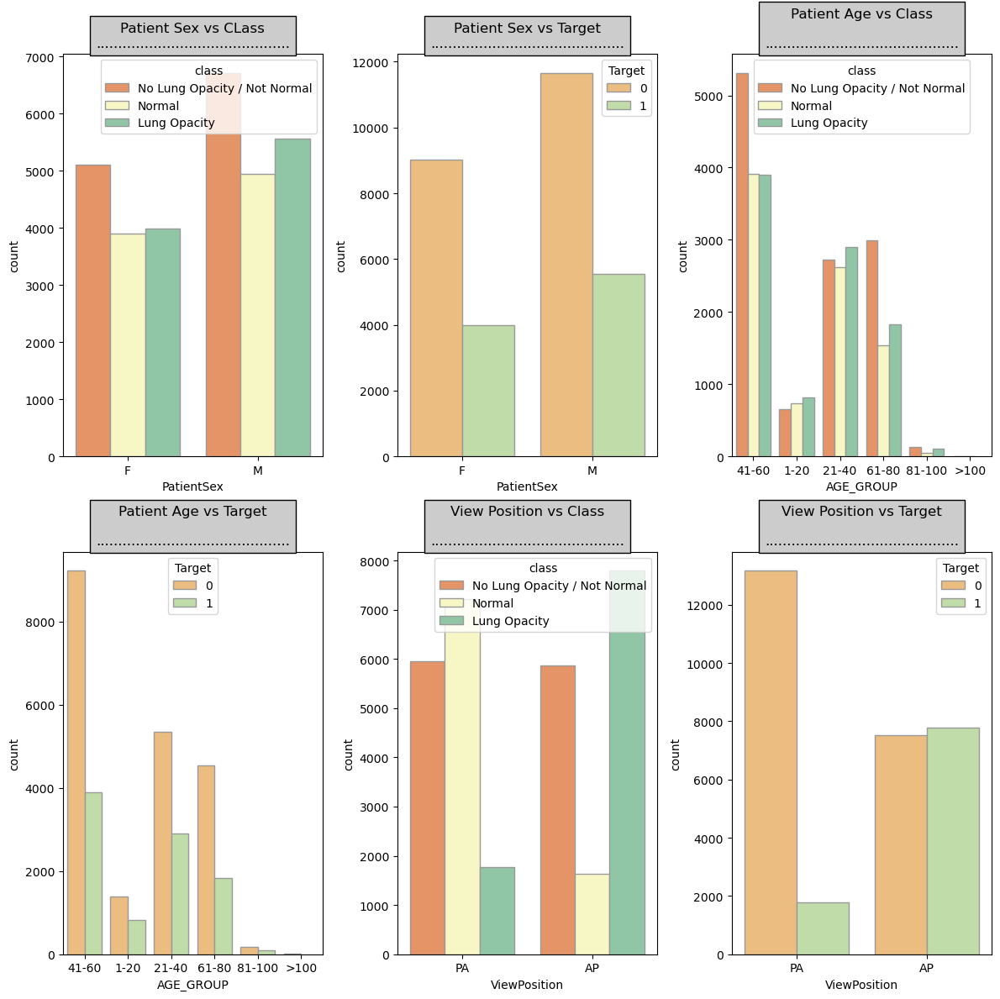

In [83]:
fig, ax = plt.subplots(2,3)
fig.set_figheight(12)
fig.set_figwidth(12)

# BI-VARIATE ANALYSIS

#1. PATIENT SEX AND CLASS
ax[0][0].set_title("Patient Sex vs CLass" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})
sns.countplot(data = dicom_metadata_final, x = "PatientSex",hue = "class", edgecolor = ".6",palette = "Spectral",ax = ax[0][0])

#2. PATIENT SEX AND TARGET
sns.countplot(data = dicom_metadata_final, x = "PatientSex",hue = "Target", edgecolor = ".6",palette = "Spectral",ax = ax[0][1])
ax[0][1].set_title("Patient Sex vs Target" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})

#3. PATIENT AGE GROUP AND CLASS
sns.countplot(data = dicom_metadata_final, x = "AGE_GROUP",hue = "class", edgecolor = ".6",palette = "Spectral",ax = ax[0][2])
ax[0][2].set_title("Patient Age vs Class\n"  + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})

#4. PATIENT AGE GROUP AND TARGET
sns.countplot(data = dicom_metadata_final, x = "AGE_GROUP",hue = "Target", edgecolor = ".6",palette = "Spectral",ax = ax[1][0])
ax[1][0].set_title("Patient Age vs Target\n" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})

#5. VIEW POSITION AND CLASS
sns.countplot(data = dicom_metadata_final, x = "ViewPosition",hue = "class", edgecolor = ".6",palette = "Spectral",ax = ax[1][1])
ax[1][1].set_title("View Position vs Class\n" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})

#6. VIEW POSITION AND TARGET
sns.countplot(data = dicom_metadata_final, x = "ViewPosition",hue = "Target", edgecolor = ".6",palette = "Spectral",ax = ax[1][2])
ax[1][2].set_title("View Position vs Target\n" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})

fig.tight_layout()
plt.show()

    Observations:

    1. Sex Vs Class

    - Since there are Male patients than Female patients as observed earlier the proportion of Classes also seem to be almost \
    similar between the genders

    2. Sex Vs Target

    - Again since there are more Male patients, the number of Pneumonia cases are also higher in them than in the Female patients.
    But more or less the proportions seem to be almost similar between the genders

    3. Age group Vs Class

    - As observed earlier since the number of patients are very high in the 41-60 age category, the classes are also very high in that 
    category. Normal cases and Lung opacity cases are almost the same in the 41-60 category with the Not normal cases being very high

    - Again since 21-40 age category patients are next highest after 41-60, the number of classes are also high there.  Interestingly all the 
    3 classes are almost similar in this age category

    - 61-80 age has higher Not Normal cases than 21-40 Not normal cases

    4. Age group Vs Target

    - Age group 41-60 has the highest Pneumonia cases followed by 21-40 then 61-80 and then 1-20

    5. View Position Vs Class

    - PA - Posterior to Anterior means X-ray source passes through the back of the patient with the chest facing the Film

    - AP - Anterior to Posterior means X-ray source passes through the front of the patient with the back facing the Film

    - More Normal Classes are found in PA than in AP view
    - Nor normal / No Lung opacity classes are almost similar in both PA and AP views

    6. View Position Vs Target

    - Huge number of Pneumonia cases found in AP views than in PA views

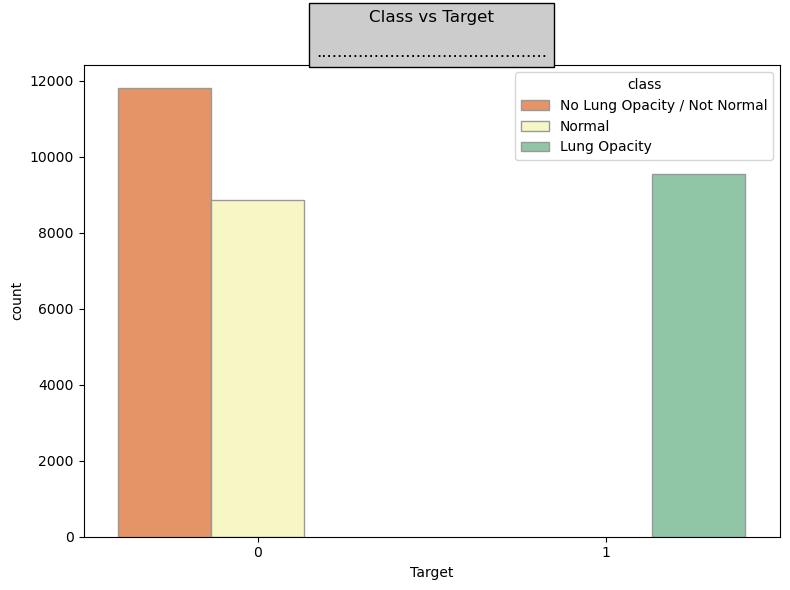

In [84]:
#6. Class & TARGET

fig, ax = plt.subplots(1,1)
fig.set_figheight(6)
fig.set_figwidth(8)
sns.countplot(data = dicom_metadata_final, x = "Target", hue = "class", edgecolor = ".6",palette = "Spectral",ax=ax)
ax.set_title("Class vs Target\n" + "\n............................................", bbox={'facecolor':'0.8', 'pad':5})
fig.tight_layout()
plt.show()

    Observation:  

    - It looks pretty obvious that Lung Opacity class is shown only in Target=1 
      while Normal and Not Normal classes are only observed in Target = 0

In [85]:
dicom_metadata_final.describe(include='object').transpose().style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,count,unique,top,freq
patientId,30227,26684,3239951b-6211-4290-b237-3d9ad17176db,4
class,30227,3,No Lung Opacity / Not Normal,11821
SpecificCharacterSet,30227,1,ISO_IR 100,30227
SOPClassUID,30227,1,1.2.840.10008.5.1.4.1.1.7,30227
SOPInstanceUID,30227,26684,1.2.276.0.7230010.3.1.4.8323329.2740.1517874298.197769,4
Modality,30227,1,CR,30227
ConversionType,30227,1,WSD,30227
SeriesDescription,30227,2,view: AP,15297
PatientName,30227,26684,3239951b-6211-4290-b237-3d9ad17176db,4
PatientSex,30227,2,M,17216


In [86]:
dicom_metadata_final.describe().transpose().style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,count,mean,std,min,25%,50%,75%,max
x,9555.000000,394.047724,204.574172,2.000000,207.000000,324.000000,594.000000,835.000000
y,9555.000000,366.839560,148.940488,2.000000,249.000000,365.000000,478.500000,881.000000
width,9555.000000,218.471376,59.289475,40.000000,177.000000,217.000000,259.000000,528.000000
height,9555.000000,329.269702,157.750755,45.000000,203.000000,298.000000,438.000000,942.000000
Target,30227.000000,0.316108,0.464963,0.000000,0.000000,0.000000,1.000000,1.000000
StudyDate,30227.000000,19010101.000000,0.000000,19010101.000000,19010101.000000,19010101.000000,19010101.000000,19010101.000000
StudyTime,30227.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AccessionNumber,0.000000,nan,nan,nan,nan,nan,nan,nan
ReferringPhysicianName,0.000000,nan,nan,nan,nan,nan,nan,nan
PatientBirthDate,0.000000,nan,nan,nan,nan,nan,nan,nan


    There are lots of columns in the metadata which have 

        - Nulls in all the rows
        - the same values repeating in all the rows
        - unique values in each row

    All these columns will be of no importance during the Multi-variance analysis, hence picking up only the required 20 columns from
    the 50 total columns 

In [87]:
dicom_required_df = dicom_metadata_final[["patientId","x","y","width","height","Target","class","SOPInstanceUID",
                                          "PatientSex","PatientAge","ViewPosition","StudyInstanceUID","SeriesInstanceUID","PixelSpacing",
                                          "PixelSpacing1","img_min","img_max","img_mean","img_std","img_pct_window"]]

In [88]:
dicom_required_df.dtypes

patientId             object
x                    float64
y                    float64
width                float64
height               float64
Target                 int64
class                 object
SOPInstanceUID        object
PatientSex            object
PatientAge             int64
ViewPosition          object
StudyInstanceUID      object
SeriesInstanceUID     object
PixelSpacing         float64
PixelSpacing1        float64
img_min                int64
img_max                int64
img_mean             float64
img_std              float64
img_pct_window       float64
dtype: object

In [89]:
print("dicom_metadata_final shape",dicom_metadata_final.shape)
print("dicom_required_df shape",dicom_required_df.shape)

dicom_metadata_final shape (30227, 49)
dicom_required_df shape (30227, 20)


    dicom_required_df dataframe has the required 20 columns for Multi-variante analysis

In [90]:
dicom_eda_df = dicom_required_df[["patientId", "Target", "class", "PatientSex", "PatientAge", "ViewPosition"]]

In [91]:
dicom_eda_df.dtypes

patientId       object
Target           int64
class           object
PatientSex      object
PatientAge       int64
ViewPosition    object
dtype: object

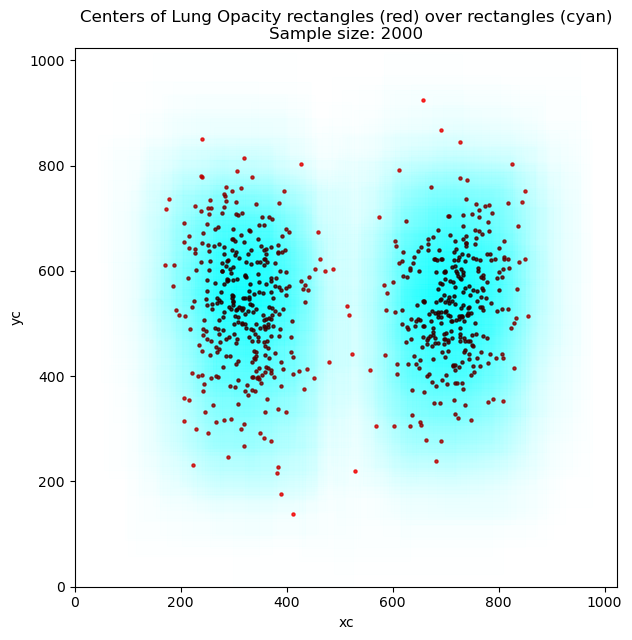

In [92]:
fig, ax = plt.subplots(1,1,figsize=(7,7))
target_sample = dicom_required_df.sample(2000)
target_sample['xc'] = target_sample['x'] + target_sample['width'] / 2
target_sample['yc'] = target_sample['y'] + target_sample['height'] / 2
plt.title("Centers of Lung Opacity rectangles (red) over rectangles (cyan)\nSample size: 2000")
target_sample.plot.scatter(x='xc', y='yc', xlim=(0,1024), ylim=(0,1024), ax=ax, alpha=0.8, marker=".", color="red")
for i, crt_sample in target_sample.iterrows():
    ax.add_patch(patches.Rectangle(xy=(crt_sample['x'], crt_sample['y']),
                width=crt_sample['width'],height=crt_sample['height'],alpha=3.5e-3, color="cyan"))
plt.show()

    Multi-Variate Analysis

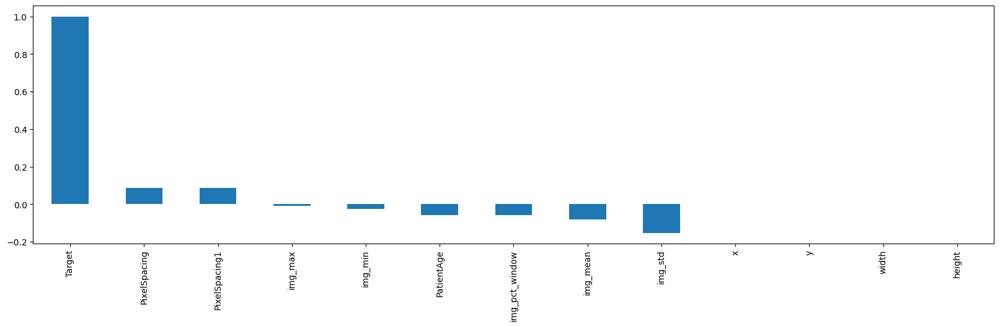

In [93]:
# MULTI VARIATE ANALYSIS

#1. CORRELATION PLOT ON dicom_required_df

def CORR_PLOT(df):
    plt.figure(figsize = (16,10))
    df.corr()['Target'].sort_values(ascending = False).plot(kind = 'bar', figsize = (20,5))
    plt.show()

CORR_PLOT(dicom_required_df)

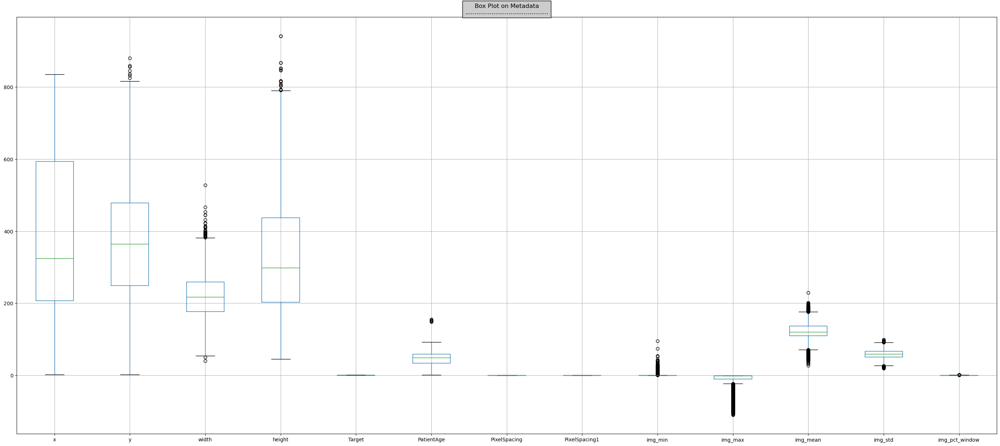

In [94]:
#2. BOX PLOT ON dicom_metadata_df

dicom_required_df.boxplot(figsize=(35,15))
plt.title("Box Plot on Metadata\n" + "............................................", bbox={'facecolor':'0.8', 'pad':5})
plt.show()

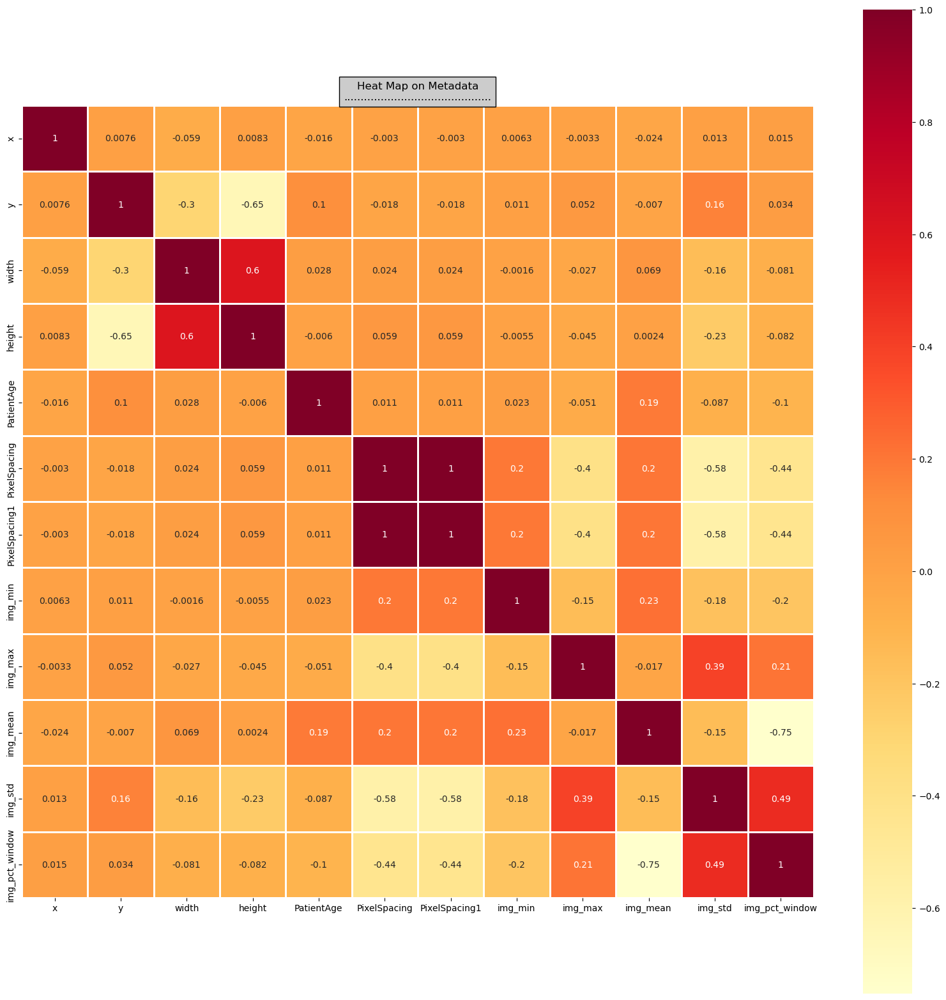

In [95]:
#3. HEAT MAP

plt.figure(figsize = (20,20))
sns.heatmap(dicom_required_df.drop(columns = 'Target').corr(), annot = True, linewidths = 1, square = True, cmap="YlOrRd")
plt.title("Heat Map on Metadata\n" + "............................................", bbox={'facecolor':'0.8', 'pad':5})
plt.show()


    There seems to be No Multi-Collinearity issues..........

## Step 5: Display images with bounding box.

In [80]:
# Reset Index of the DF before proceedig for bounding box
train_Lung_Opacity = train_Lung_Opacity.reset_index(drop = True)

def bound_box(passed_sample):
    # Take a random sample of 5 images and print bounding box patch on images
    sample_data = random.sample(list(Lung_Opacity_Unique), passed_sample)
    if passed_sample/5 == 0:
        z = math.ceil(passed_sample/5)
    else:
        z = math.ceil((passed_sample)/5)

    bounding_box_data = pd.DataFrame()

    fig, ax = plt.subplots(z,5,constrained_layout=True)
    fig.set_figheight(20)
    fig.set_figwidth(20)
    
    i = 0
    j = 0

    for loop_1 in sample_data:
        pat_id_1 = loop_1

        no_ind = train_Lung_Opacity[train_Lung_Opacity['patientId'] == pat_id_1].index.values
        l_ind = len(no_ind)

        fname = pat_id_1+".dcm"
        image_path = "Training/Lung Opacity/"+fname
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array

        X = 0
        Y = 0
        width = 0
        height = 0
        rect = []

        for k in range(l_ind):
            X = train_Lung_Opacity.iloc[no_ind[k],1]
            Y = train_Lung_Opacity.iloc[no_ind[k],2]
            width = train_Lung_Opacity.iloc[no_ind[k],3]
            height = train_Lung_Opacity.iloc[no_ind[k],4]
            bounding_box_data = bounding_box_data.append(pd.Series([pat_id_1, l_ind,X,Y,width,height]), ignore_index = True)
            rect.append(patches.Rectangle((X, Y), width, height,linewidth = 3,edgecolor = 'r',facecolor = 'none'))
            ax[i][j].imshow(img, cmap=plt.cm.bone)
            ax[i][j].add_patch(rect[k])

        j = j+1
        if j == 5:
            i = i+1
            j = 0
    plt.figure().clear()
    plt.show()
    bounding_box_data.columns = ['Image Name','No. Of Bounding Boxes','X','Y','Width','Height']
    return(bounding_box_data)

# Add columns to the bounding_box_data
# bounding_box_data.columns = ['Patient_ID','No. of Bounding Boxes','X','Y','Width','Height']
# Save the sample bounding_box_data to a csv file for reference
# bounding_box_data.to_csv(cap_path+'bounding_box_data.csv')

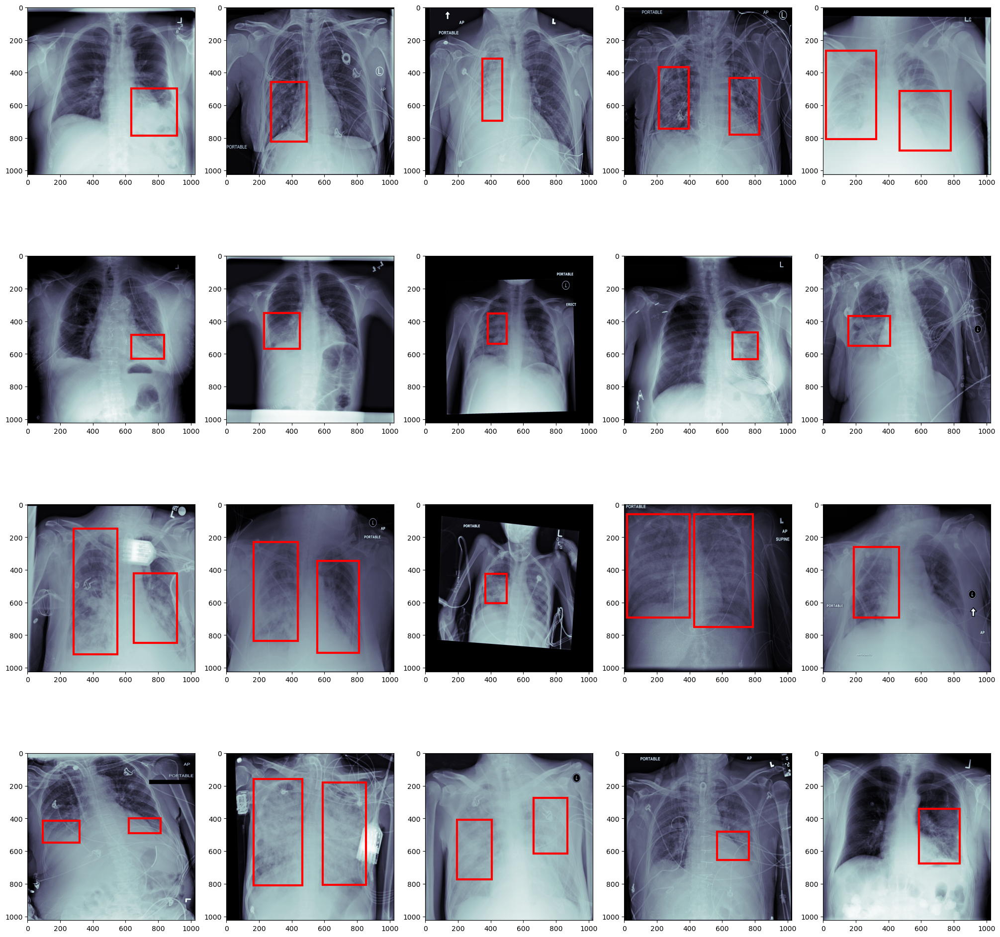

<Figure size 640x480 with 0 Axes>

Image Name,No. Of Bounding Boxes,X,Y,Width,Height
17d34b01-a492-4764-9ee7-1403ed7a3f97,1,636.000000,498.000000,278.000000,288.000000
ba29c8c8-c116-4b8e-b8d6-ec870ca9f9e5,1,272.000000,457.000000,219.000000,364.000000
1b7f9ebf-bd1c-4195-9186-d6adb65945ee,1,348.000000,313.000000,122.000000,383.000000
ee8a4128-a907-475b-a363-9cd60d65e46e,2,644.000000,434.000000,182.000000,347.000000
ee8a4128-a907-475b-a363-9cd60d65e46e,2,212.000000,365.000000,184.000000,378.000000
9ded4d8b-5e88-4470-bb20-1d55d76d6658,2,467.000000,513.000000,315.000000,363.000000
9ded4d8b-5e88-4470-bb20-1d55d76d6658,2,18.000000,264.000000,306.000000,542.000000
617d8a06-9de7-4b9e-b7c8-a9c234a44602,1,634.000000,483.000000,201.000000,147.000000
9d82f9f6-b84d-48d0-9ce5-68329990d7fa,1,229.000000,348.000000,221.000000,221.000000
750d6b01-4273-43b2-8de8-500e738cb257,1,383.000000,351.000000,115.000000,186.000000


In [81]:
bound_box(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

## Step 6: Design, train and test basic CNN models for classification.

In [96]:
Images_df.sample(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file,Full_filename,Image_Class_Category,Image_Target
9063,Training,Normal,6927a615-8ec4-4219-aa92-e368d628cb2e.dcm,Training/Normal/6927a615-8ec4-4219-aa92-e368d628cb2e.dcm,1,0
13219,Training,Normal,d5011cb2-a146-4ca6-a055-2ec956315350.dcm,Training/Normal/d5011cb2-a146-4ca6-a055-2ec956315350.dcm,1,0
17121,Training,Not Normal,4c2749cb-7bb8-46d8-9d14-491d0035f891.dcm,Training/Not Normal/4c2749cb-7bb8-46d8-9d14-491d0035f891.dcm,2,0
17925,Training,Not Normal,58b049d6-b48c-4edc-ac83-753591aa359d.dcm,Training/Not Normal/58b049d6-b48c-4edc-ac83-753591aa359d.dcm,2,0
4927,Training,Lung Opacity,c04f9256-7358-42ef-b843-19dbf64ef287.dcm,Training/Lung Opacity/c04f9256-7358-42ef-b843-19dbf64ef287.dcm,0,1
24237,Training,Not Normal,d89f8d29-3832-4d89-8647-d16f9079c25a.dcm,Training/Not Normal/d89f8d29-3832-4d89-8647-d16f9079c25a.dcm,2,0
667,Training,Lung Opacity,1c44e0a4-4612-438f-9a83-8d5bf919cb67.dcm,Training/Lung Opacity/1c44e0a4-4612-438f-9a83-8d5bf919cb67.dcm,0,1
23130,Training,Not Normal,c76bb89f-781d-4c53-8685-58f981394a09.dcm,Training/Not Normal/c76bb89f-781d-4c53-8685-58f981394a09.dcm,2,0
8488,Training,Normal,5bfa4ba1-9ea6-42c5-b44f-1a58dfe648bf.dcm,Training/Normal/5bfa4ba1-9ea6-42c5-b44f-1a58dfe648bf.dcm,1,0
23058,Training,Not Normal,c648be1a-3426-414b-80af-fd4cbdffa7f2.dcm,Training/Not Normal/c648be1a-3426-414b-80af-fd4cbdffa7f2.dcm,2,0


In [97]:
Images_df.dtypes

Folder                  object
Image_Class             object
Image_file              object
Full_filename           object
Image_Class_Category     int32
Image_Target             int64
dtype: object

In [98]:
Images_sample1_a = Images_df[Images_df["Image_Target"] == 0]
Images_sample2_a = Images_df[Images_df["Image_Target"] == 1]

In [5]:
print("No Pneumonia",len(Images_sample1_a))
print("\nImages Pneumonia",len(Images_sample2_a))

No Pneumonia 20672

Images Pneumonia 6012


In [86]:
sample1_a = Images_sample1_a.sample(n = 3000)
sample2_a = Images_sample2_a.sample(n = 3000)

In [87]:
sams_1a = [sample1_a, sample2_a]

In [88]:
result_1a = pd.concat(sams_1a)
print(result_1a.shape)
print(result_1a["Image_Target"].value_counts())

(6000, 6)
0    3000
1    3000
Name: Image_Target, dtype: int64


In [89]:
Images_6000_Target = result_1a.copy()

In [90]:
img_rows=224
img_cols=224
dim = (img_rows, img_cols)

X_target = []
brk = 0
i = 1 # initialisation
for img in tqdm(Images_6000_Target["Full_filename"].values): 
    
    ds_3 = dicom.dcmread(img)
    img_3 = ds_3.pixel_array
    rgb = apply_color_lut(img_3, palette='PET')
    train_img = rgb
    try:
        train_img_resize = cv2.resize(train_img, dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk +=1
        print("breaking out for",img)
        break
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|██████████████████████████████████████████████████████████████████████████████| 6000/6000 [02:41<00:00, 37.26it/s]


    Pickling 6000 sample 3 dimensional images based on Target (1 & 0)

In [91]:
fileName = "Images_X_3_target_6000.pkl"
fileObject = open(fileName, 'wb')

pkl.dump(X_target, fileObject)
fileObject.close()

    Pickling Images dataframe

In [92]:
Images_6000_Target.to_pickle("Images_6000_Target.pkl") # pickling the proportionate target from 6000 Images dataframe

    Unpickling the Images_6000_sample.pkl and creating the 6000 Images dataframe

In [75]:
image_pickle = open ("Images_6000_Target.pkl", "rb")
Images_6000_Target = pkl.load(image_pickle)
Images_6000_Target.sample(10).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,Folder,Image_Class,Image_file,Full_filename,Image_Class_Category,Image_Target
17686,Training,Not Normal,59cdf26b-d2de-436b-9d67-4c8317ea46be.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Not Normal/59cdf26b-d2de-436b-9d67-4c8317ea46be.dcm,2,0
18263,Training,Not Normal,6477a41c-821b-4c21-88cf-677f73d8bcd4.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Not Normal/6477a41c-821b-4c21-88cf-677f73d8bcd4.dcm,2,0
19141,Training,Not Normal,71ecae41-9818-4f71-a2c6-9e237efca012.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Not Normal/71ecae41-9818-4f71-a2c6-9e237efca012.dcm,2,0
3091,Training,Lung Opacity,9c0fbb4b-715d-43ad-ac16-3cd798caaab3.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Lung Opacity/9c0fbb4b-715d-43ad-ac16-3cd798caaab3.dcm,0,1
4958,Training,Lung Opacity,d60b0cba-c1bd-4741-86ef-c24760605b03.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Lung Opacity/d60b0cba-c1bd-4741-86ef-c24760605b03.dcm,0,1
14551,Training,Normal,0103fadb-1663-40a6-8a9e-09d626cd2091.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Normal/0103fadb-1663-40a6-8a9e-09d626cd2091.dcm,1,0
2617,Training,Lung Opacity,85f49d66-c50b-4f89-be34-2aee655583b3.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Lung Opacity/85f49d66-c50b-4f89-be34-2aee655583b3.dcm,0,1
16289,Training,Not Normal,43d0854c-a7f1-4901-addc-fa88cecf99d5.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Not Normal/43d0854c-a7f1-4901-addc-fa88cecf99d5.dcm,2,0
25559,Training,Not Normal,f36259c8-6751-4c6f-b9d4-44fd4f86e61b.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Not Normal/f36259c8-6751-4c6f-b9d4-44fd4f86e61b.dcm,2,0
4198,Training,Lung Opacity,b8d7b42e-8dc7-4330-a8f3-db52852f1714.dcm,/content/drive/MyDrive/Colab Notebooks/Project/Capstone Project//Training/Lung Opacity/b8d7b42e-8dc7-4330-a8f3-db52852f1714.dcm,0,1


    Unpickling the 3 dimensional X of 6000 samples

In [76]:
image_X_3 = open ("Images_X_3_target_6000.pkl", "rb")
X = pkl.load(image_X_3)
X[0:2]

[array([[[  0,  39,  38],
         [  0,  35,  35],
         [  0,  34,  33],
         ...,
         [  0,  40,  40],
         [  0,  45,  44],
         [  0,  34,  33]],
 
        [[  0,  36,  35],
         [  0,  34,  33],
         [  0,  31,  30],
         ...,
         [  0,  54,  53],
         [  0,  58,  56],
         [  0,  85,  83]],
 
        [[  0,  34,  33],
         [  0,  32,  32],
         [  0,  30,  29],
         ...,
         [  0,  25,  24],
         [  0,  17,  17],
         [  0,  20,  19]],
 
        ...,
 
        [[  0,  53,  52],
         [  0,  58,  57],
         [  0,  48,  47],
         ...,
         [ 44,  82, 170],
         [ 20, 107, 146],
         [  0, 118, 116]],
 
        [[  0,  52,  51],
         [  0,  55,  54],
         [  0,  49,  48],
         ...,
         [ 51,  76, 177],
         [ 24, 102, 150],
         [  1, 126, 127]],
 
        [[  0,  55,  53],
         [  0,  48,  47],
         [  0,  44,  43],
         ...,
         [ 57,  70, 183],
  

In [77]:
X_tar = np.array(X)

In [78]:
X_tar.shape

(6000, 224, 224, 3)

In [79]:
print(X_tar.max())
print(X_tar.min())

255
0


In [80]:
y1_tar = Images_6000_Target['Image_Target']

In [81]:
y1_tar.value_counts()

0    3000
1    3000
Name: Image_Target, dtype: int64

In [82]:
y1_tar_cat = to_categorical(y1_tar, num_classes=2)

print("Shape of y1_tar_cat:", y1_tar_cat.shape)

Shape of y1_tar_cat: (6000, 2)


In [83]:
y1_tar_cat[0:10]

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [84]:
print("X_tar shape",X_tar.shape)
print("y1_tar_cat shape",y1_tar_cat.shape)

X_tar shape (6000, 224, 224, 3)
y1_tar_cat shape (6000, 2)


    Splitting into Test and Validation

In [85]:
X_train, X_test, y_train, y_test = train_test_split(X_tar, y1_tar_cat, test_size=.20, stratify=y1_tar_cat, random_state=1)  # 80% Training and 20% Testing

In [86]:
print("X_train",X_train.shape)
print("y_train",y_train.shape)  

print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (4800, 224, 224, 3)
y_train (4800, 2)
X_test (1200, 224, 224, 3)
y_test (1200, 2)


In [87]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% Testing

In [88]:
print("X_train1",X_train1.shape)
print("y_train1",y_train1.shape)  

print("X_val",X_val.shape)
print("y_val",y_val.shape)

X_train1 (3840, 224, 224, 3)
y_train1 (3840, 2)
X_val (960, 224, 224, 3)
y_val (960, 2)


In [89]:
print(X_val[0])
print(y_val[0])

[[[  0 107 105]
  [  0  76  74]
  [  0  50  49]
  ...
  [  0  84  82]
  [  0  90  88]
  [  0 108 106]]

 [[  0 107 105]
  [  0  75  74]
  [  0  48  47]
  ...
  [  0  46  45]
  [  0  47  46]
  [  0  63  61]]

 [[  0 107 104]
  [  0  75  73]
  [  0  46  45]
  ...
  [  0  16  15]
  [  0  20  18]
  [  0  33  32]]

 ...

 [[  0  18  17]
  [  0   6   5]
  [  0  10   9]
  ...
  [  0  24  23]
  [  0  45  44]
  [  0  78  75]]

 [[  0  20  19]
  [  0  13  12]
  [  0  18  17]
  ...
  [  0  28  27]
  [  0  47  46]
  [  0  78  76]]

 [[  0  28  27]
  [  0  24  23]
  [  0  30  29]
  ...
  [  0  30  29]
  [  0  48  47]
  [  0  79  77]]]
[1. 0.]


    Creating a CNN Architecture

In [233]:
tf.keras.backend.clear_session()

# Initialize the model
model = Sequential()

# Add a Convolutional Layer with 32 filters of size 7X7, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=32, kernel_size=7, strides=(2, 2), activation="relu", input_shape=(224, 224, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(BatchNormalization())

# Add a Convolutional Layer with 64 filters of size 5X5, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Dropout(rate=0.3))

# model.add(GlobalMaxPooling2D())

# Apply Dropout with 0.2 probability 
# model.add(Dropout(rate=0.2))

# Add a Convolutional Layer with 64 filters of size 3X3 and activation function as 'relu' 
# model.add(Conv2D(filters=64, kernel_size=3, strides=(2, 2), activation="relu"))
# model.add(MaxPooling2D(pool_size=(2, 2)))
# model.add(BatchNormalization())

# Flatten the layer
model.add(Flatten())

# Add Fully Connected Layer with 128 units and activation function as 'relu'
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))

# model.add(Dropout(rate=0.3))

# model.add(BatchNormalization())

# model.add(Dense(128, activation="relu"))

#Add Fully Connected Layer with 3 units and activation function as 'softmax'
model.add(Dense(2, activation="sigmoid"))

In [21]:
optimizer = Adam(learning_rate=0.01)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 50, 50, 64)       256       
 hNormalization)                                                 
                                                        

In [22]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 34s 550ms/step - loss: 4.3237 - accuracy: 0.6383 - val_loss: 14.4939 - val_accuracy: 0.5354
Epoch 2/10
60/60 [==============================] - 37s 609ms/step - loss: 0.6385 - accuracy: 0.7107 - val_loss: 1.2404 - val_accuracy: 0.6750
Epoch 3/10
60/60 [==============================] - 36s 603ms/step - loss: 0.5882 - accuracy: 0.7247 - val_loss: 0.7027 - val_accuracy: 0.6833
Epoch 4/10
60/60 [==============================] - 36s 600ms/step - loss: 0.5466 - accuracy: 0.7294 - val_loss: 0.6329 - val_accuracy: 0.7052
Epoch 5/10
60/60 [==============================] - 36s 596ms/step - loss: 0.5267 - accuracy: 0.7479 - val_loss: 0.6261 - val_accuracy: 0.7188
Epoch 6/10
60/60 [==============================] - 36s 592ms/step - loss: 0.5200 - accuracy: 0.7443 - val_loss: 0.6133 - val_accuracy: 0.7292
Epoch 7/10
60/60 [==============================] - 36s 596ms/step - loss: 0.5267 - accuracy: 0.7487 - val_loss: 0.6255 - val_accuracy: 0.716

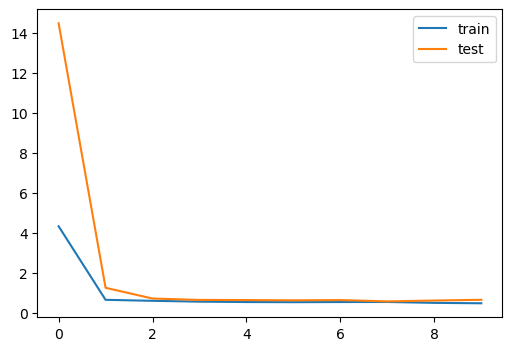

In [23]:
plt.figure(figsize=(6,4))
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

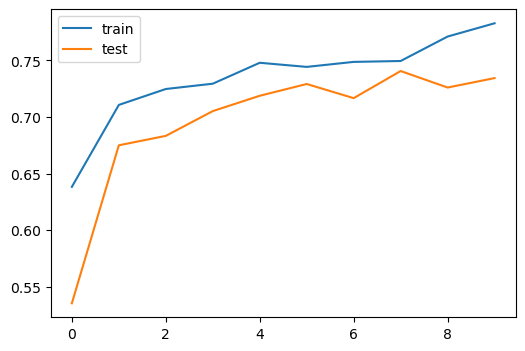

In [24]:
plt.figure(figsize=(6,4))
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [234]:
tf.keras.backend.clear_session()

# second model
model_2 = Sequential()

model_2.add(Conv2D(filters=32, kernel_size=7, strides=(2, 2), activation="relu", input_shape=(224, 224, 3)))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

model_2.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

#model_2.add(Dropout(rate=0.3))

model_2.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

model_2.add(Flatten())

model_2.add(Dense(128, activation="relu"))
# model_2.add(BatchNormalization())

model_2.add(Dense(84, activation="relu"))
# model_2.add(BatchNormalization())
model_2.add(Dense(42, activation="relu"))

model_2.add(Dense(2, activation="sigmoid"))

In [26]:
optimizer = Adam(learning_rate=0.001)
model_2.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 64)       0         
 2D)                                                             
                                                        

In [28]:
batch_size = 64
nb_epochs = 20
history_2 = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.0001)])

Epoch 1/20
60/60 [==============================] - 35s 576ms/step - loss: 0.6190 - accuracy: 0.6997 - val_loss: 1.3135 - val_accuracy: 0.5698
Epoch 2/20
60/60 [==============================] - 37s 610ms/step - loss: 0.5663 - accuracy: 0.7219 - val_loss: 0.6272 - val_accuracy: 0.6802
Epoch 3/20
60/60 [==============================] - 37s 611ms/step - loss: 0.5180 - accuracy: 0.7437 - val_loss: 0.5994 - val_accuracy: 0.7271
Epoch 4/20
60/60 [==============================] - 37s 609ms/step - loss: 0.4965 - accuracy: 0.7594 - val_loss: 0.6675 - val_accuracy: 0.6896
Epoch 5/20
60/60 [==============================] - 36s 607ms/step - loss: 0.4684 - accuracy: 0.7729 - val_loss: 0.6723 - val_accuracy: 0.6854
Epoch 6/20
60/60 [==============================] - 37s 612ms/step - loss: 0.4272 - accuracy: 0.7964 - val_loss: 0.7234 - val_accuracy: 0.6729


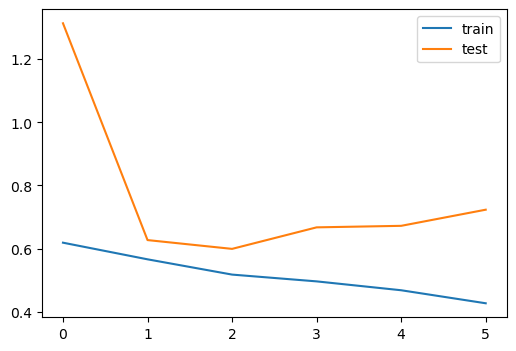

In [29]:
plt.figure(figsize=(6,4))
plt.plot(history_2.history['loss'], label='train')
plt.plot(history_2.history['val_loss'], label='test')
plt.legend()
plt.show()

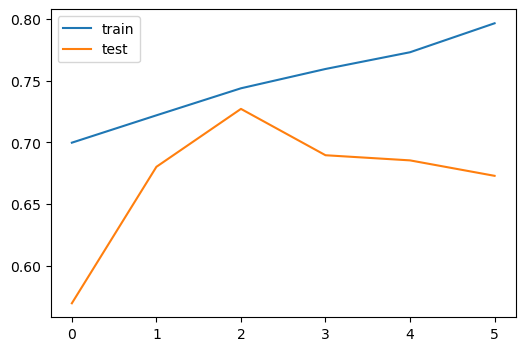

In [30]:
plt.figure(figsize=(6,4))
plt.plot(history_2.history['accuracy'], label='train')
plt.plot(history_2.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [57]:
tf.keras.backend.clear_session()

# second model
model_2a = Sequential()

model_2a.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), activation="relu", input_shape=(224, 224, 3)))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

model_2a.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

#model_2a.add(Conv2D(filters=512, kernel_size=3, strides=(1, 1), activation="relu"))
#model_2a.add(MaxPooling2D(pool_size=(2, 2)))
#model_2a.add(BatchNormalization())

model_2a.add(Flatten())

#model_2a.add(Dense(512, activation="relu"))
# model_2a.add(Dropout(rate=0.7))

model_2a.add(Dense(256, activation="relu"))
model_2a.add(Dropout(rate=0.25))

model_2a.add(Dense(128, activation="relu"))
# model_2a.add(Dropout(rate=0.3))

model_2a.add(Dense(64, activation="relu"))

model_2a.add(Dense(32, activation="relu"))

model_2a.add(Dense(2, activation="sigmoid"))

In [32]:
optimizer = Adam(learning_rate=0.0001)
model_2a.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [34]:
batch_size = 54
nb_epochs = 20
history_2a = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.01)])

Epoch 1/20
72/72 [==============================] - 174s 2s/step - loss: 0.6146 - accuracy: 0.6885 - val_loss: 0.6254 - val_accuracy: 0.6854
Epoch 2/20
72/72 [==============================] - 176s 2s/step - loss: 0.5556 - accuracy: 0.7232 - val_loss: 0.5876 - val_accuracy: 0.6875
Epoch 3/20
72/72 [==============================] - 175s 2s/step - loss: 0.5299 - accuracy: 0.7414 - val_loss: 0.5784 - val_accuracy: 0.6969
Epoch 4/20
72/72 [==============================] - 176s 2s/step - loss: 0.4800 - accuracy: 0.7680 - val_loss: 0.5746 - val_accuracy: 0.7240
Epoch 5/20
72/72 [==============================] - 176s 2s/step - loss: 0.4530 - accuracy: 0.7831 - val_loss: 0.5635 - val_accuracy: 0.7333
Epoch 6/20
72/72 [==============================] - 176s 2s/step - loss: 0.4168 - accuracy: 0.8057 - val_loss: 0.6096 - val_accuracy: 0.7104
Epoch 7/20
72/72 [==============================] - 176s 2s/step - loss: 0.3621 - accuracy: 0.8320 - val_loss: 0.6227 - val_accuracy: 0.7031
Epoch 8/20
72

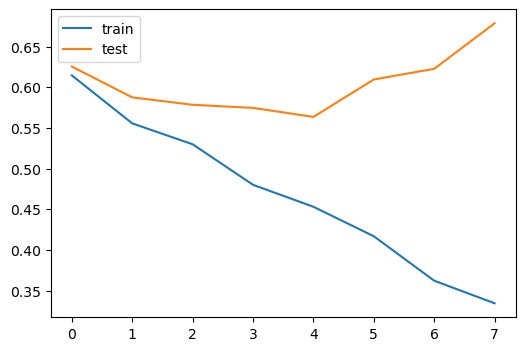

In [35]:
plt.figure(figsize=(6,4))
plt.plot(history_2a.history['loss'], label='train')
plt.plot(history_2a.history['val_loss'], label='test')
plt.legend()
plt.show()

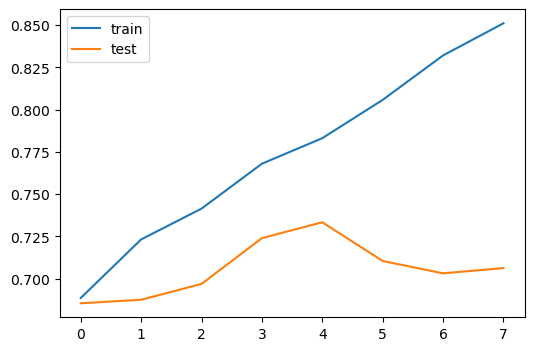

In [36]:
plt.figure(figsize=(6,4))
plt.plot(history_2a.history['accuracy'], label='train')
plt.plot(history_2a.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [236]:
tf.keras.backend.clear_session()

# second model
model_3 = Sequential()

model_3.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), activation="relu", input_shape=(224, 224, 3)))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(BatchNormalization())

model_3.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Dropout(rate=0.3))

model_3.add(Flatten())

model_3.add(Dense(128, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(84, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(42, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(2, activation="sigmoid"))

In [38]:
optimizer = Adam(learning_rate=0.0001)
model_3.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 51, 51, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 25, 25, 128)      0

In [39]:
batch_size = 64
nb_epochs = 20
history_3 = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.001)])

Epoch 1/20
60/60 [==============================] - 156s 3s/step - loss: 0.6527 - accuracy: 0.6594 - val_loss: 0.6083 - val_accuracy: 0.7031
Epoch 2/20
60/60 [==============================] - 160s 3s/step - loss: 0.5647 - accuracy: 0.7286 - val_loss: 0.5843 - val_accuracy: 0.7198
Epoch 3/20
60/60 [==============================] - 158s 3s/step - loss: 0.5501 - accuracy: 0.7260 - val_loss: 0.5555 - val_accuracy: 0.7385
Epoch 4/20
60/60 [==============================] - 158s 3s/step - loss: 0.5343 - accuracy: 0.7414 - val_loss: 0.5385 - val_accuracy: 0.7385
Epoch 5/20
60/60 [==============================] - 158s 3s/step - loss: 0.5088 - accuracy: 0.7625 - val_loss: 0.5368 - val_accuracy: 0.7375
Epoch 6/20
60/60 [==============================] - 158s 3s/step - loss: 0.4993 - accuracy: 0.7607 - val_loss: 0.5299 - val_accuracy: 0.7437
Epoch 7/20
60/60 [==============================] - 158s 3s/step - loss: 0.4814 - accuracy: 0.7734 - val_loss: 0.5503 - val_accuracy: 0.7281
Epoch 8/20
60

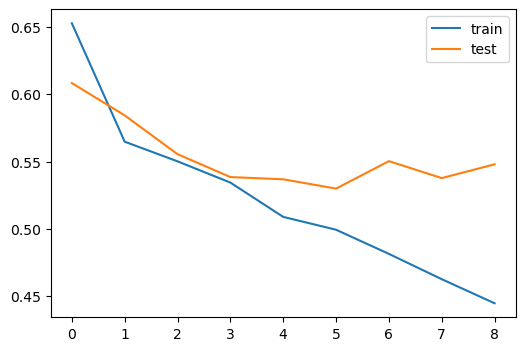

In [40]:
plt.figure(figsize=(6,4))
plt.plot(history_3.history['loss'], label='train')
plt.plot(history_3.history['val_loss'], label='test')
plt.legend()
plt.show()

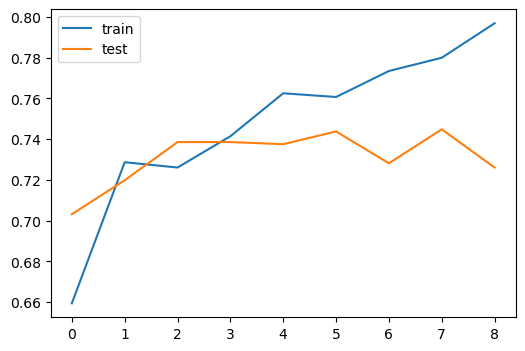

In [41]:
plt.figure(figsize=(6,4))
plt.plot(history_3.history['accuracy'], label='train')
plt.plot(history_3.history['val_accuracy'], label='test')
plt.legend()
plt.show()

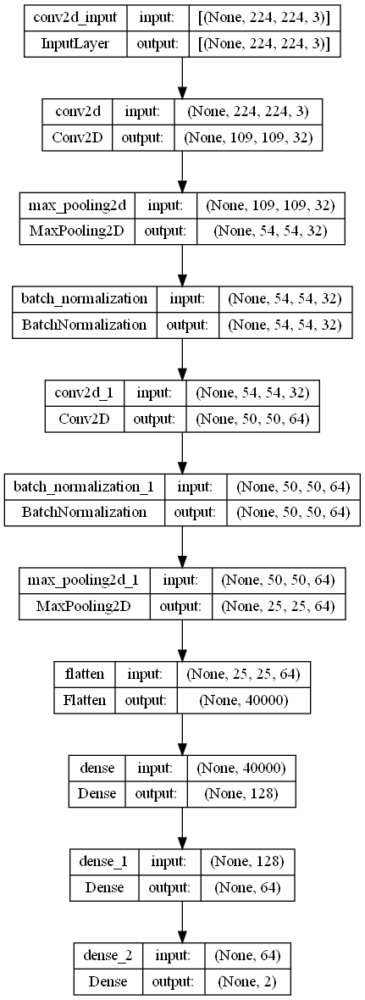

In [42]:
plot_model(model,to_file="model_0_plot.png", show_shapes = True, show_layer_names = True)

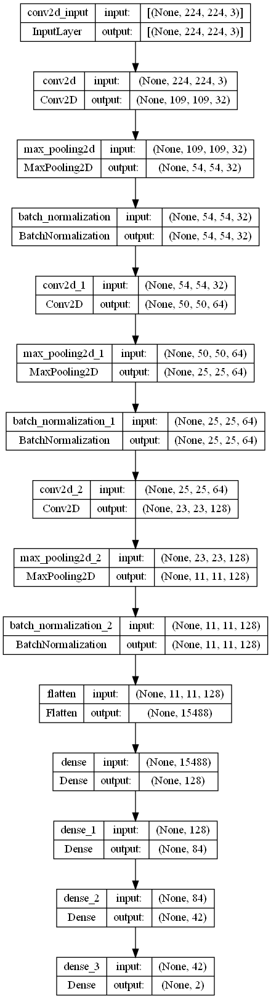

In [43]:
plot_model(model_2,to_file="model_2_plot.png", show_shapes = True, show_layer_names = True)

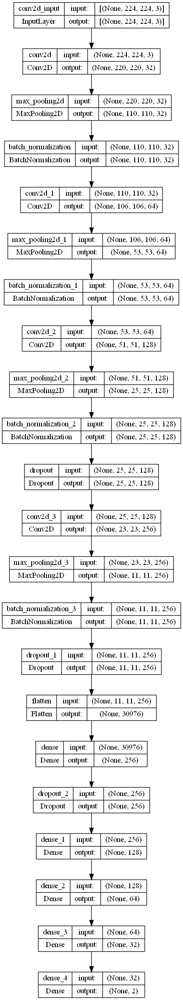

In [44]:
plot_model(model_2a,to_file="model_2a_plot.png", show_shapes = True, show_layer_names = True)

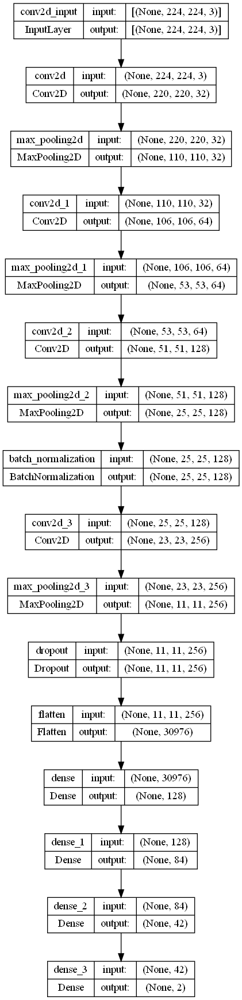

In [45]:
plot_model(model_3,to_file="model_3_plot.png", show_shapes = True, show_layer_names = True)

In [46]:
# serialize model to JSON
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("model.h5")
print("Saved model to disk")

Saved model to disk


In [47]:
# serialize model to JSON
model_json = model.to_json()
with open("model_2.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("model_2.h5")
print("Saved model to disk")

Saved model to disk


In [48]:
# serialize model to JSON
model_json = model.to_json()
with open("model_2a.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("model_2a.h5")
print("Saved model to disk")

Saved model to disk


In [49]:
# serialize model to JSON
model_json = model.to_json()
with open("model_3.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("model_3.h5")
print("Saved model to disk")

Saved model to disk


In [50]:
# load json and create model

json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("model.h5")
print("Loaded model from disk")

loaded_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 71.25%


In [51]:
# load json and create model
json_file = open('model_2.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("model_2.h5")
print("Loaded model from disk")

loaded_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 71.25%


In [52]:
# load json and create model
json_file = open('model_2a.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("model_2a.h5")
print("Loaded model from disk")

loaded_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 71.25%


In [53]:
# load json and create model
json_file = open('model_3.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
# load weights into new model
loaded_model.load_weights("model_3.h5")
print("Loaded model from disk")

loaded_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
score = loaded_model.evaluate(X_test, y_test, verbose=0)
print("%s: %.2f%%" % (loaded_model.metrics_names[1], score[1]*100))

Loaded model from disk
accuracy: 71.25%


In [54]:
loss_1, accuracy_1 = model.evaluate(X_test,y_test)

38/38 [==============================] - 2s 47ms/step - loss: 0.6716 - accuracy: 0.7125


In [55]:
y_pred_1 = model.predict(X_test)

38/38 [==============================] - 2s 47ms/step


In [56]:
y_test_arg=np.argmax(y_test,axis=1)
Y_pred_1 = np.argmax(y_pred_1,axis=1)

In [57]:
RESULTS = pd.DataFrame()

RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

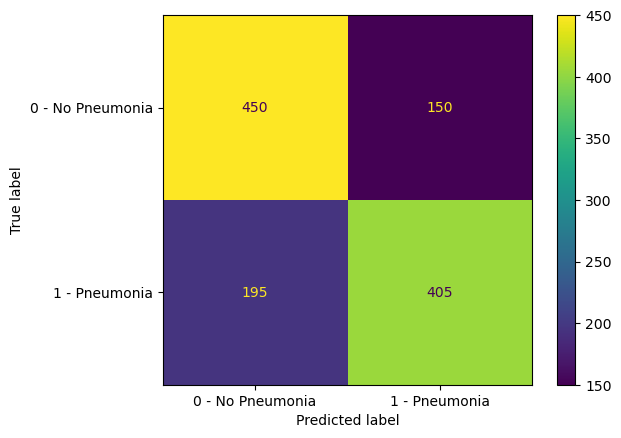

In [58]:
cm = confusion_matrix(y_test_arg, Y_pred_1)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [59]:
print(classification_report(y_test_arg, Y_pred_1))

              precision    recall  f1-score   support

           0       0.70      0.75      0.72       600
           1       0.73      0.68      0.70       600

    accuracy                           0.71      1200
   macro avg       0.71      0.71      0.71      1200
weighted avg       0.71      0.71      0.71      1200



In [60]:
loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)

38/38 [==============================] - 2s 47ms/step - loss: 0.7090 - accuracy: 0.6817


In [61]:
y_pred_2 = model_2.predict(X_test)

38/38 [==============================] - 2s 47ms/step


In [62]:
Y_pred_2 = np.argmax(y_pred_2,axis=1)

In [63]:
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

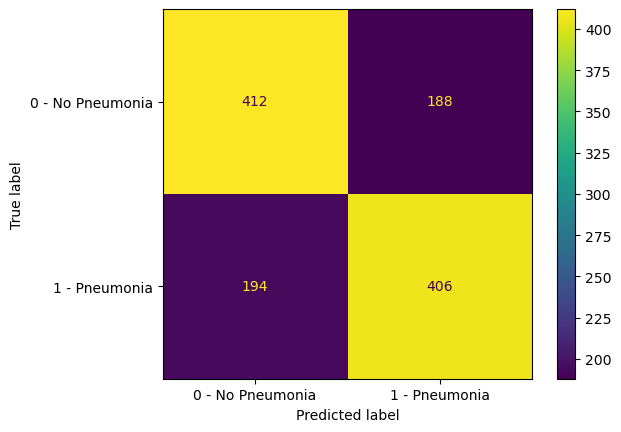

In [64]:
cm = confusion_matrix(y_test_arg, Y_pred_2)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [65]:
print(classification_report(y_test_arg, Y_pred_2))

              precision    recall  f1-score   support

           0       0.68      0.69      0.68       600
           1       0.68      0.68      0.68       600

    accuracy                           0.68      1200
   macro avg       0.68      0.68      0.68      1200
weighted avg       0.68      0.68      0.68      1200



In [66]:
loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)

38/38 [==============================] - 8s 198ms/step - loss: 0.7499 - accuracy: 0.6775


In [67]:
y_pred_2a = model.predict(X_test)

38/38 [==============================] - 2s 47ms/step


In [68]:
Y_pred_2a = np.argmax(y_pred_2a,axis=1)

In [69]:
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

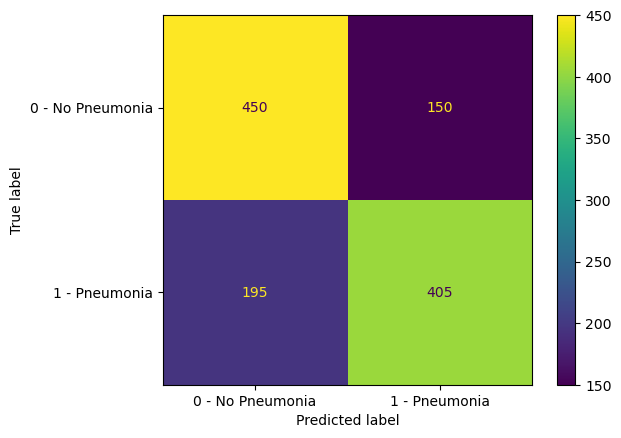

In [70]:
cm = confusion_matrix(y_test_arg, Y_pred_2a)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [71]:
print(classification_report(y_test_arg, Y_pred_2a))

              precision    recall  f1-score   support

           0       0.70      0.75      0.72       600
           1       0.73      0.68      0.70       600

    accuracy                           0.71      1200
   macro avg       0.71      0.71      0.71      1200
weighted avg       0.71      0.71      0.71      1200



In [72]:
loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)

38/38 [==============================] - 7s 176ms/step - loss: 0.5918 - accuracy: 0.6958


In [73]:
y_pred_3 = model.predict(X_test)

38/38 [==============================] - 2s 50ms/step


In [74]:
Y_pred_3 = np.argmax(y_pred_3,axis=1)

In [75]:
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

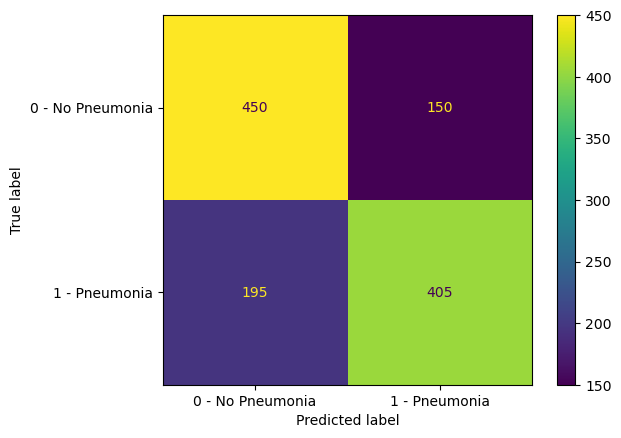

In [76]:
cm = confusion_matrix(y_test_arg, Y_pred_3)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [77]:
print(classification_report(y_test_arg, Y_pred_3))

              precision    recall  f1-score   support

           0       0.70      0.75      0.72       600
           1       0.73      0.68      0.70       600

    accuracy                           0.71      1200
   macro avg       0.71      0.71      0.71      1200
weighted avg       0.71      0.71      0.71      1200



In [78]:
RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

MODEL_NAME,LOSS,ACCURACY
model,67.160000,71.250000
model_2,70.900000,68.170000
model_2a,74.990000,67.750000
model_3,59.180000,69.580000


In [79]:
RESULTS.to_csv("base_model_results.csv", index = False)

    * From all the models, we can see that model_3 has low loss and high accuracy, compared to other models.

In [80]:
print("X_test.shape",X_test.shape)
print("y_test.shape",y_test.shape)

X_test.shape (1200, 224, 224, 3)
y_test.shape (1200, 2)


In [81]:
import random

for i in range(1,6):
    rand_test = random.randint(0, 1200)
    print("random test sample...:",i)
    print("")
    print("     random test number",rand_test)
    print("")
    # print("   X_test",X_test[rand_test])
    print("    y_test",y_test[rand_test])
    print("    y_pred_1",y_pred_1[rand_test])
    print("    argmax",np.argmax(y_pred_1[rand_test]))
    print("    y_pred_2",y_pred_2[rand_test])
    print("    argmax",np.argmax(y_pred_2[rand_test]))
    print("    y_pred_2a",y_pred_2a[rand_test])
    print("    argmax",np.argmax(y_pred_2a[rand_test]))
    print("    y_pred_3",y_pred_3[rand_test])
    print("    argmax",np.argmax(y_pred_3[rand_test]))
    print("")

random test sample...: 1

     random test number 323

    y_test [1. 0.]
    y_pred_1 [0.9543633  0.01797388]
    argmax 0
    y_pred_2 [0.9403397  0.01519391]
    argmax 0
    y_pred_2a [0.9543633  0.01797388]
    argmax 0
    y_pred_3 [0.9543633  0.01797388]
    argmax 0

random test sample...: 2

     random test number 764

    y_test [0. 1.]
    y_pred_1 [0.91296834 0.00319313]
    argmax 0
    y_pred_2 [0.5173416  0.21540992]
    argmax 0
    y_pred_2a [0.91296834 0.00319313]
    argmax 0
    y_pred_3 [0.91296834 0.00319313]
    argmax 0

random test sample...: 3

     random test number 894

    y_test [1. 0.]
    y_pred_1 [0.9359591  0.00203102]
    argmax 0
    y_pred_2 [0.39366844 0.41483364]
    argmax 1
    y_pred_2a [0.9359591  0.00203102]
    argmax 0
    y_pred_3 [0.9359591  0.00203102]
    argmax 0

random test sample...: 4

     random test number 227

    y_test [1. 0.]
    y_pred_1 [0.904644   0.06956016]
    argmax 0
    y_pred_2 [0.7016851  0.21505149]
    argmax 

                                                                                        *** END OF INTERIM SUBMISSION ***

# 2. Milestone 2:

# Input: Preprocessed output from Milestone-1

# Process:

# Step 1: Fine tune the trained basic CNN models for classification.

# Fine Tuning 1: 

# Increase the number of images to 10000 and train the models

    * Here we are increasing the number of images to 10000.
    * By increasing the number of images we are expecting the models to be trained on more variations and more information is 
       made available to the model and models can learn more on the data.

    - In our earlier steps before training the model, we have seggregated the images into 2 samples:
        * sample1_a - Images with out pneumonia - 20672 Records
        * sample2_a - Images with pneumonia - 6012 Records
        
    - From the above samples, we select 5000 Records from each samples and concat the records which gives a final dataset of 
      10000 image records. Here we are increasing the data by 67%

In [4]:
print("No of image with No Pneumonia",len(Images_df[Images_df["Image_Target"] == 0]))
print("\nNo of Images with Pneumonia",len(Images_df[Images_df["Image_Target"] == 1]))

No of image with No Pneumonia 20672

No of Images with Pneumonia 6012


In [6]:
sample1_5000 = Images_sample1_a.sample(n = 5000)
sample2_5000 = Images_sample2_a.sample(n = 5000)

sams_5000 = [sample1_5000, sample2_5000]

result_5000 = pd.concat(sams_5000)
print('Shape of the Increased Training Data: ',result_5000.shape)
print('\nNo of Images in Target 0 and Target 1:\n',result_5000["Image_Target"].value_counts())

Shape of the Increased Training Data:  (10000, 6)

No of Images in Target 0 and Target 1:
 0    5000
1    5000
Name: Image_Target, dtype: int64


In [7]:
Images_10000_Target = result_5000.copy()

Images_10000_Target.dtypes

Folder                  object
Image_Class             object
Image_file              object
Full_filename           object
Image_Class_Category     int32
Image_Target             int64
dtype: object

In [8]:
img_rows=224
img_cols=224
dim = (img_rows, img_cols)

X_target = []
brk = 0
i = 1 # initialisation
for img in tqdm(Images_10000_Target["Full_filename"].values): 
    
    ds_3 = dicom.dcmread(img)
    img_3 = ds_3.pixel_array
    rgb = apply_color_lut(img_3, palette='PET')
    train_img = rgb
    try:
        train_img_resize = cv2.resize(train_img, dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk +=1
        print("breaking out for",img_3)
        break
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [04:35<00:00, 36.24it/s]


In [9]:
np.array(X_target).shape

(10000, 224, 224, 3)

    * Pickle the 10000 Sample images and proportionate targets.

In [99]:
fileName = "Images_X_3_target_10000.pkl"
fileObject = open(fileName, 'wb')

pkl.dump(X_target, fileObject)
fileObject.close()

In [100]:
Images_10000_Target.to_pickle("Images_10000_Target.pkl") # pickling the proportionate target from 10000 Images dataframe

In [95]:
image_X_3 = open ("Images_X_3_target_10000.pkl", "rb")
Images_10000_pkl= open ("Images_10000_Target.pkl", "rb")
X = pkl.load(image_X_3)
Images_10000_Target = pkl.load(Images_10000_pkl)

In [96]:
X[0:2]

[array([[[255, 245, 237],
         [255, 238, 222],
         [255, 230, 205],
         ...,
         [255, 246, 239],
         [255, 249, 245],
         [255, 253, 252]],
 
        [[255, 219, 184],
         [255, 212, 171],
         [255, 200, 145],
         ...,
         [255, 221, 188],
         [255, 226, 198],
         [255, 242, 231]],
 
        [[255, 194, 134],
         [255, 188, 122],
         [255, 174,  94],
         ...,
         [255, 195, 134],
         [255, 201, 147],
         [255, 218, 182]],
 
        ...,
 
        [[  0,  40,  39],
         [  0,  40,  39],
         [  0,  40,  39],
         ...,
         [  0,  38,  37],
         [  0,  38,  37],
         [  0,  40,  39]],
 
        [[  0,  40,  39],
         [  0,  39,  38],
         [  0,  40,  39],
         ...,
         [  0,  38,  37],
         [  0,  38,  37],
         [  0,  40,  39]],
 
        [[  0,  40,  39],
         [  0,  39,  38],
         [  0,  40,  39],
         ...,
         [  0,  38,  37],
  

In [98]:
X_target = X

np.array(X_target).shape

(10000, 224, 224, 3)

In [99]:
X_tar_10k = np.array(X_target)

In [100]:
X_tar_10k.shape

(10000, 224, 224, 3)

In [101]:
print(X_tar_10k.max())
print('\n',X_tar_10k.min())

255

 0


In [102]:
y1_tar_10k = Images_10000_Target['Image_Target']

In [103]:
y1_tar_10k.value_counts()

0    5000
1    5000
Name: Image_Target, dtype: int64

In [104]:
y1_tar_cat_10k = to_categorical(y1_tar_10k, num_classes=2)

print("Shape of y1_tar_cat_10k:", y1_tar_cat_10k.shape)

Shape of y1_tar_cat_10k: (10000, 2)


In [105]:
y1_tar_cat_10k[0:10]

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [106]:
print("X_tar_10k shape",X_tar_10k.shape)
print("y1_tar_cat_10k shape",y1_tar_cat_10k.shape)

X_tar_10k shape (10000, 224, 224, 3)
y1_tar_cat_10k shape (10000, 2)


    * Split the data into test and validation:

In [93]:
X_train, X_test, y_train, y_test = train_test_split(X_tar_10k, y1_tar_cat_10k, test_size=.20, 
                                                    stratify=y1_tar_cat_10k, random_state=1)  # 80% Training and 20% Testing

In [94]:
print("Shape of X_train",X_train.shape)
print("\nShape of y_train",y_train.shape)  

print("\nShape of X_test",X_test.shape)
print("\nShape of y_test",y_test.shape)

Shape of X_train (8000, 224, 224, 3)

Shape of y_train (8000, 2)

Shape of X_test (2000, 224, 224, 3)

Shape of y_test (2000, 2)


In [95]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% Testing

In [96]:
print("Shape of X_train1",X_train1.shape)
print("\nShape of y_train1",y_train1.shape)  

print("\nShape of X_val",X_val.shape)
print("\nShape of y_val",y_val.shape)

Shape of X_train1 (6400, 224, 224, 3)

Shape of y_train1 (6400, 2)

Shape of X_val (1600, 224, 224, 3)

Shape of y_val (1600, 2)


In [97]:
print(X_val[0])
print(y_val[0])

[[[145  20 217]
  [ 75  53 201]
  [  8 119 133]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[212  85  86]
  [129  10 238]
  [ 47  80 173]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[237 110  35]
  [158  30 196]
  [106  20 233]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[171  43 170]
  [133   6 244]
  [ 90  37 217]
  ...
  [  0  78  76]
  [  0  81  79]
  [  0  79  77]]

 [[255 154  51]
  [250 127  20]
  [226  99  58]
  ...
  [ 37  90 163]
  [ 38  88 164]
  [ 41  85 167]]

 [[255 219 184]
  [255 208 162]
  [255 207 160]
  ...
  [170  42 172]
  [172  44 167]
  [174  46 163]]]
[1. 0.]


In [98]:
tf.keras.backend.clear_session()

In [99]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
100/100 [==============================] - 53s 525ms/step - loss: 0.5658 - accuracy: 0.7228 - val_loss: 0.8308 - val_accuracy: 0.6550
Epoch 2/10
100/100 [==============================] - 53s 530ms/step - loss: 0.5360 - accuracy: 0.7403 - val_loss: 0.5387 - val_accuracy: 0.7281
Epoch 3/10
100/100 [==============================] - 53s 531ms/step - loss: 0.5084 - accuracy: 0.7550 - val_loss: 0.5603 - val_accuracy: 0.7206
Epoch 4/10
100/100 [==============================] - 53s 527ms/step - loss: 0.4901 - accuracy: 0.7652 - val_loss: 0.5544 - val_accuracy: 0.7275


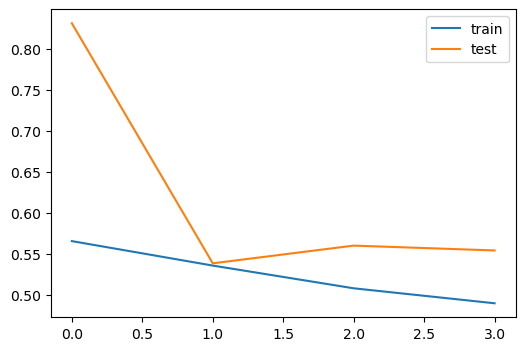

In [100]:
plt.figure(figsize=(6,4))
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

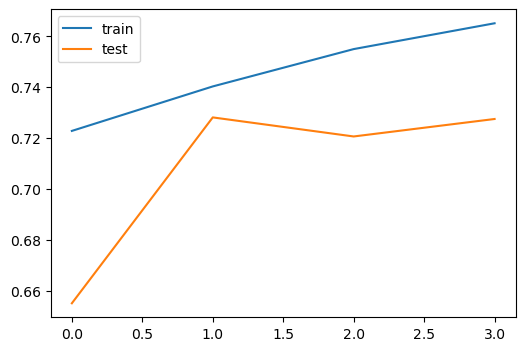

In [101]:
plt.figure(figsize=(6,4))
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [103]:
tf.keras.backend.clear_session()

batch_size = 64
nb_epochs = 10
history_2 = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.0001)])

Epoch 1/10
100/100 [==============================] - 53s 533ms/step - loss: 0.5336 - accuracy: 0.7456 - val_loss: 0.5606 - val_accuracy: 0.7287
Epoch 2/10
100/100 [==============================] - 53s 533ms/step - loss: 0.4929 - accuracy: 0.7686 - val_loss: 0.5542 - val_accuracy: 0.7244
Epoch 3/10
100/100 [==============================] - 53s 532ms/step - loss: 0.4625 - accuracy: 0.7853 - val_loss: 0.5424 - val_accuracy: 0.7431
Epoch 4/10
100/100 [==============================] - 54s 541ms/step - loss: 0.4185 - accuracy: 0.8103 - val_loss: 0.5951 - val_accuracy: 0.7069
Epoch 5/10
100/100 [==============================] - 54s 536ms/step - loss: 0.3710 - accuracy: 0.8384 - val_loss: 0.5894 - val_accuracy: 0.7431
Epoch 6/10
100/100 [==============================] - 54s 542ms/step - loss: 0.3137 - accuracy: 0.8622 - val_loss: 0.7019 - val_accuracy: 0.6675


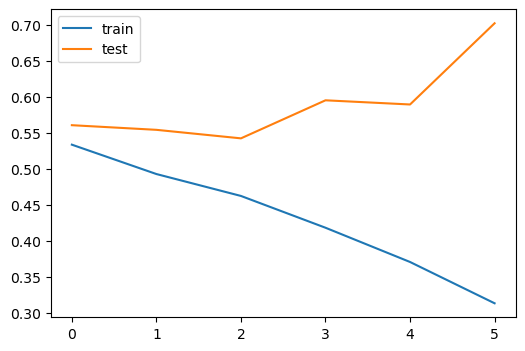

In [104]:
plt.figure(figsize=(6,4))
plt.plot(history_2.history['loss'], label='train')
plt.plot(history_2.history['val_loss'], label='test')
plt.legend()
plt.show()

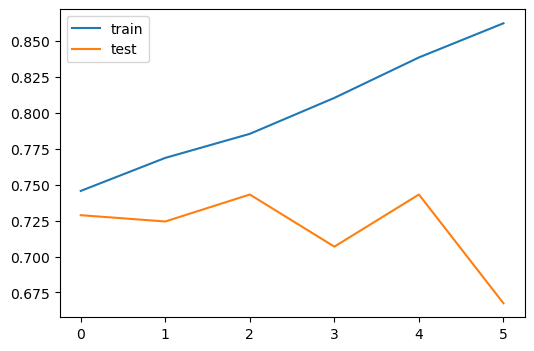

In [105]:
plt.figure(figsize=(6,4))
plt.plot(history_2.history['accuracy'], label='train')
plt.plot(history_2.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [106]:
tf.keras.backend.clear_session()

batch_size = 64
nb_epochs = 10
history_2a = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.01)])

Epoch 1/10
100/100 [==============================] - 281s 3s/step - loss: 0.5493 - accuracy: 0.7348 - val_loss: 0.5557 - val_accuracy: 0.7294
Epoch 2/10
100/100 [==============================] - 326s 3s/step - loss: 0.4865 - accuracy: 0.7680 - val_loss: 0.5466 - val_accuracy: 0.7613
Epoch 3/10
100/100 [==============================] - 323s 3s/step - loss: 0.4405 - accuracy: 0.7980 - val_loss: 0.5561 - val_accuracy: 0.7287
Epoch 4/10
100/100 [==============================] - 325s 3s/step - loss: 0.3928 - accuracy: 0.8253 - val_loss: 0.5607 - val_accuracy: 0.7450


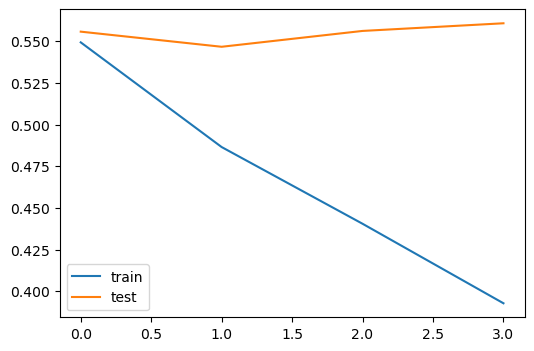

In [107]:
plt.figure(figsize=(6,4))
plt.plot(history_2a.history['loss'], label='train')
plt.plot(history_2a.history['val_loss'], label='test')
plt.legend()
plt.show()

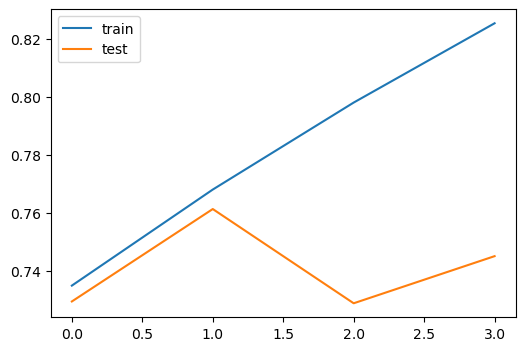

In [108]:
plt.figure(figsize=(6,4))
plt.plot(history_2a.history['accuracy'], label='train')
plt.plot(history_2a.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [109]:
tf.keras.backend.clear_session()

batch_size = 64
nb_epochs = 10
history_3 = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.001)])

Epoch 1/10
100/100 [==============================] - 301s 3s/step - loss: 0.5468 - accuracy: 0.7325 - val_loss: 0.5153 - val_accuracy: 0.7525
Epoch 2/10
100/100 [==============================] - 299s 3s/step - loss: 0.5152 - accuracy: 0.7533 - val_loss: 0.5256 - val_accuracy: 0.7362
Epoch 3/10
100/100 [==============================] - 298s 3s/step - loss: 0.5022 - accuracy: 0.7570 - val_loss: 0.5226 - val_accuracy: 0.7350
Epoch 4/10
100/100 [==============================] - 297s 3s/step - loss: 0.4877 - accuracy: 0.7659 - val_loss: 0.5242 - val_accuracy: 0.7381


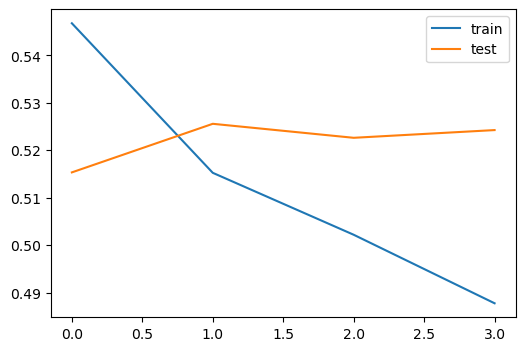

In [110]:
plt.figure(figsize=(6,4))
plt.plot(history_3.history['loss'], label='train')
plt.plot(history_3.history['val_loss'], label='test')
plt.legend()
plt.show()

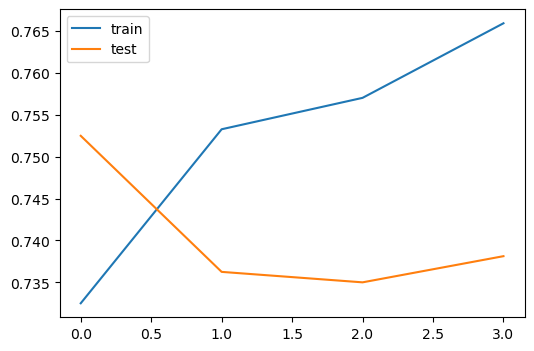

In [111]:
plt.figure(figsize=(6,4))
plt.plot(history_3.history['accuracy'], label='train')
plt.plot(history_3.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [112]:
loss_1, accuracy_1 = model.evaluate(X_test,y_test)

63/63 [==============================] - 5s 79ms/step - loss: 0.5370 - accuracy: 0.7410


In [113]:
y_pred_1 = model.predict(X_test)

63/63 [==============================] - 5s 77ms/step


In [114]:
y_test_arg=np.argmax(y_test,axis=1)
Y_pred_1 = np.argmax(y_pred_1,axis=1)

In [115]:
RESULTS = pd.DataFrame()

RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

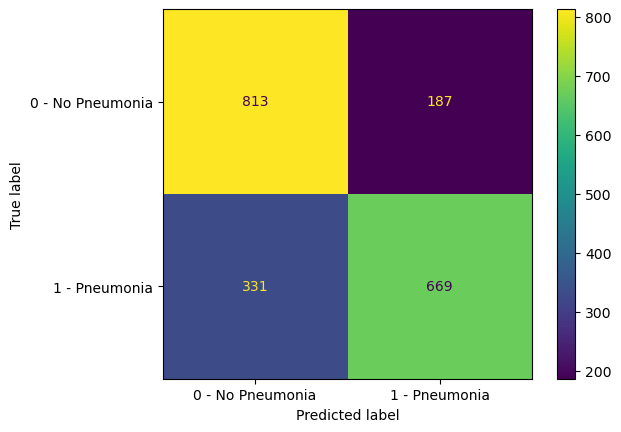

In [116]:
cm = confusion_matrix(y_test_arg, Y_pred_1)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [117]:
loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)

63/63 [==============================] - 5s 83ms/step - loss: 0.7691 - accuracy: 0.6565


In [118]:
y_pred_2 = model_2.predict(X_test)

63/63 [==============================] - 5s 82ms/step


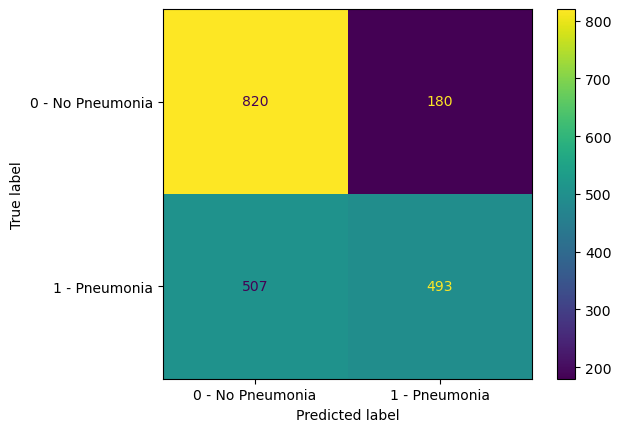

In [119]:
Y_pred_2 = np.argmax(y_pred_2,axis=1)

RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

cm = confusion_matrix(y_test_arg, Y_pred_2)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [120]:
print(classification_report(y_test_arg, Y_pred_2))

              precision    recall  f1-score   support

           0       0.62      0.82      0.70      1000
           1       0.73      0.49      0.59      1000

    accuracy                           0.66      2000
   macro avg       0.68      0.66      0.65      2000
weighted avg       0.68      0.66      0.65      2000



In [121]:
loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)

63/63 [==============================] - 19s 304ms/step - loss: 0.5580 - accuracy: 0.7450


In [122]:
y_pred_2a = model.predict(X_test)

63/63 [==============================] - 5s 76ms/step


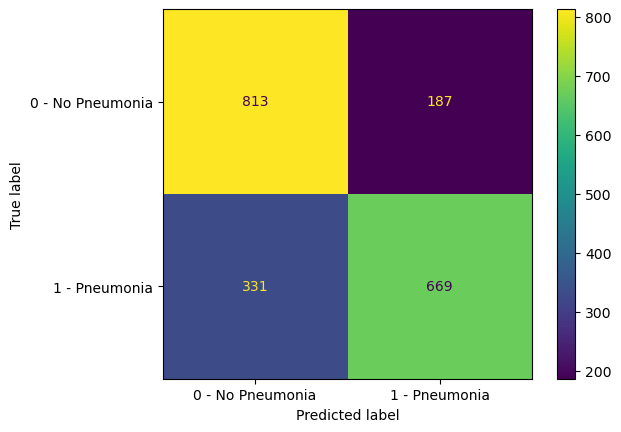

In [123]:
Y_pred_2a = np.argmax(y_pred_2a,axis=1)

RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

cm = confusion_matrix(y_test_arg, Y_pred_2a)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [124]:
print(classification_report(y_test_arg, Y_pred_2a))

              precision    recall  f1-score   support

           0       0.71      0.81      0.76      1000
           1       0.78      0.67      0.72      1000

    accuracy                           0.74      2000
   macro avg       0.75      0.74      0.74      2000
weighted avg       0.75      0.74      0.74      2000



In [125]:
loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)

63/63 [==============================] - 18s 277ms/step - loss: 0.5284 - accuracy: 0.7295


In [126]:
y_pred_3 = model.predict(X_test)

63/63 [==============================] - 5s 77ms/step


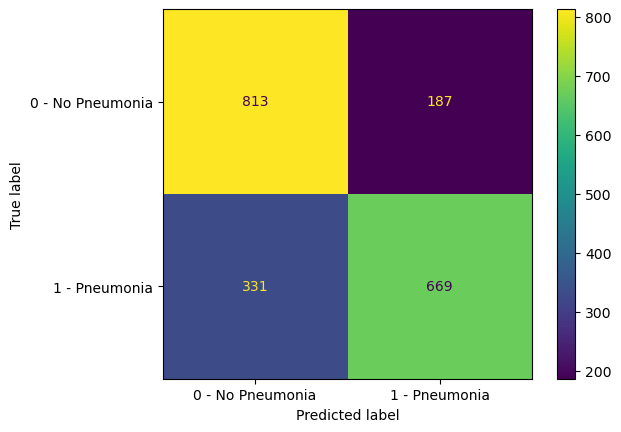

In [127]:
Y_pred_3 = np.argmax(y_pred_3,axis=1)

RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

cm = confusion_matrix(y_test_arg, Y_pred_3)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [128]:
print(classification_report(y_test_arg, Y_pred_3))

              precision    recall  f1-score   support

           0       0.71      0.81      0.76      1000
           1       0.78      0.67      0.72      1000

    accuracy                           0.74      2000
   macro avg       0.75      0.74      0.74      2000
weighted avg       0.75      0.74      0.74      2000



In [129]:
RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

MODEL_NAME,LOSS,ACCURACY
model,53.700000,74.100000
model_2,76.910000,65.650000
model_2a,55.800000,74.500000
model_3,52.840000,72.950000


In [130]:
RESULTS.to_csv("FINE_TUNING_10000_IMAGES.csv",index = False)

    Observations:
        1. On increasing the images to 10000, model_2a increased 10% of accuracy against 67% of additional images added.
        2. If we see compare all the models, overall there is no much improvement in accuracies in other models.
        3. In this case to keed the memory allocations in check while training the models, we use only 6000 images to make 
            the models train faster on further fine tuning methods.

# Fine Tuning 2: 
# Convert the images to JPEG and train the models on converted images

In [92]:
# Convert the dicom images to jpeg format.

dst = "Training_jpg"

if os.path.exists(dst):
    print("Path already exists")
else:
    os.mkdir(dst)
    
jpeg_path = os.path.join(dst+"/")

folder_path = "stage_2_train_images"
dicom_path = os.listdir("stage_2_train_images")

NAMES_DCM = []
NAMES_JPG = []

for n, image in enumerate(dicom_path):
    ds = dicom.dcmread(os.path.join(folder_path, image))
    NAMES_DCM.append(image)
    new_image = ds.pixel_array.astype(float)
    scaled_image = (np.maximum(new_image, 0) / new_image.max()) * 255.0
    scaled_image = np.uint8(scaled_image)
    final_image = Image.fromarray(scaled_image)
    final_image.save(jpeg_path + image.replace('.dcm','.jpg'))
    NAMES_JPG.append(image.replace('.dcm','.jpg'))

Path already exists


In [136]:
# Convert the dicom images to jpeg format.

dst = "Training_jpg"

if os.path.exists(dst):
    print("Path already exists")
else:
    os.mkdir(dst)
    
jpeg_path = os.path.join(dst+"/")

folder_path = "stage_2_train_images"
dicom_path = os.listdir("stage_2_train_images")

NAMES_DCM = []
NAMES_JPG = []

for image in tqdm(Images_6000_Target["Image_file"].values):
    ds = dicom.dcmread(os.path.join(folder_path, image))
    NAMES_DCM.append(image)
    new_image = ds.pixel_array.astype(float)
    scaled_image = (np.maximum(new_image, 0) / new_image.max()) * 255.0
    scaled_image = np.uint8(scaled_image)
    final_image = Image.fromarray(scaled_image)
    final_image.save(jpeg_path + image.replace('.dcm','.jpg'))
    NAMES_JPG.append(image.replace('.dcm','.jpg'))

Path already exists


100%|██████████████████████████████████████████████████████████████████████████████| 6000/6000 [03:20<00:00, 30.00it/s]


In [137]:
NAMES_JPG = pd.Series(NAMES_JPG)
NAMES_DCM = pd.Series(NAMES_DCM)

NAMES_DF = {"NAMES_JPG" : NAMES_JPG, "NAMES_DCM" : NAMES_DCM}

NAMES_DF = pd.DataFrame(NAMES_DF)

In [138]:
NAMES_DF_FINAL = pd.merge(NAMES_DF, Images_df, left_on='NAMES_DCM', right_on='Image_file')

In [139]:
NAMES_DF_FINAL = NAMES_DF_FINAL.drop(columns = ["Folder","Image_file","Full_filename"])

NAMES_DF_FINAL["Full_filename"] = "Training_jpg"+"/"+NAMES_DF_FINAL["NAMES_JPG"]

NAMES_DF_FINAL.sample(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

NAMES_JPG,NAMES_DCM,Image_Class,Image_Class_Category,Image_Target,Full_filename
bc03198b-57f4-47b5-8808-114fd5cb9808.jpg,bc03198b-57f4-47b5-8808-114fd5cb9808.dcm,Lung Opacity,0,1,Training_jpg/bc03198b-57f4-47b5-8808-114fd5cb9808.jpg
db5c4b38-0c83-4f5b-a159-ea4c3e1bc7a8.jpg,db5c4b38-0c83-4f5b-a159-ea4c3e1bc7a8.dcm,Not Normal,2,0,Training_jpg/db5c4b38-0c83-4f5b-a159-ea4c3e1bc7a8.jpg
e94d8646-1703-44db-9062-c9b305e238f0.jpg,e94d8646-1703-44db-9062-c9b305e238f0.dcm,Lung Opacity,0,1,Training_jpg/e94d8646-1703-44db-9062-c9b305e238f0.jpg
e63932eb-033b-46f1-aa55-6e913ccbe03a.jpg,e63932eb-033b-46f1-aa55-6e913ccbe03a.dcm,Not Normal,2,0,Training_jpg/e63932eb-033b-46f1-aa55-6e913ccbe03a.jpg
7adb12c0-b1b2-402e-9c58-5a8873eef61d.jpg,7adb12c0-b1b2-402e-9c58-5a8873eef61d.dcm,Lung Opacity,0,1,Training_jpg/7adb12c0-b1b2-402e-9c58-5a8873eef61d.jpg
3e881f10-28aa-4626-a79a-50cc014b7a1a.jpg,3e881f10-28aa-4626-a79a-50cc014b7a1a.dcm,Lung Opacity,0,1,Training_jpg/3e881f10-28aa-4626-a79a-50cc014b7a1a.jpg
8f719c99-d7f6-4e27-a5f6-3a259dc60b61.jpg,8f719c99-d7f6-4e27-a5f6-3a259dc60b61.dcm,Normal,1,0,Training_jpg/8f719c99-d7f6-4e27-a5f6-3a259dc60b61.jpg
a99561a5-2c12-48cd-be57-ce6b6cf58da1.jpg,a99561a5-2c12-48cd-be57-ce6b6cf58da1.dcm,Lung Opacity,0,1,Training_jpg/a99561a5-2c12-48cd-be57-ce6b6cf58da1.jpg
01fe92f7-ff87-4f9e-9077-e00e670d1b47.jpg,01fe92f7-ff87-4f9e-9077-e00e670d1b47.dcm,Normal,1,0,Training_jpg/01fe92f7-ff87-4f9e-9077-e00e670d1b47.jpg
091d75a8-e23e-4cb8-af67-10cb314077ec.jpg,091d75a8-e23e-4cb8-af67-10cb314077ec.dcm,Lung Opacity,0,1,Training_jpg/091d75a8-e23e-4cb8-af67-10cb314077ec.jpg


In [140]:
NAMES_DF_FINAL.to_pickle("NAMES_DF_FINAL.pkl") # pickling the jpg image data

In [15]:
load_data = open("NAMES_DF_FINAL.pkl", "rb")

NAMES_DF_FINAL = pickle.load(load_data)

In [142]:
def show_jpg_images(passed_value):
    show_df = NAMES_DF_FINAL.sample(n=passed_value)

    if passed_value/5 == 0:
        z = math.ceil(passed_value/5)
    else:
            z = math.ceil((passed_value)/5)

    fig, ax = plt.subplots(z,5,constrained_layout=True)
    fig.set_figheight(20)
    fig.set_figwidth(20)
    
    i = 0
    j = 0

    for index, row in show_df.iterrows():
        image_path = row['Full_filename']
        jpg_image = cv2.imread(image_path)
        jpg_image = cv2.resize(jpg_image, dsize=(224,224))

        height_1 = 224
        width_1 = 224
        dim = (width_1, height_1)

        ax[i][j].imshow(jpg_image)
        ax[i][j].set_title(row['Image_Class'])
        
        j = j+1
        if j == 5:
            i = i+1
            j = 0
    plt.figure().clear()
    plt.show()
    return(show_df)

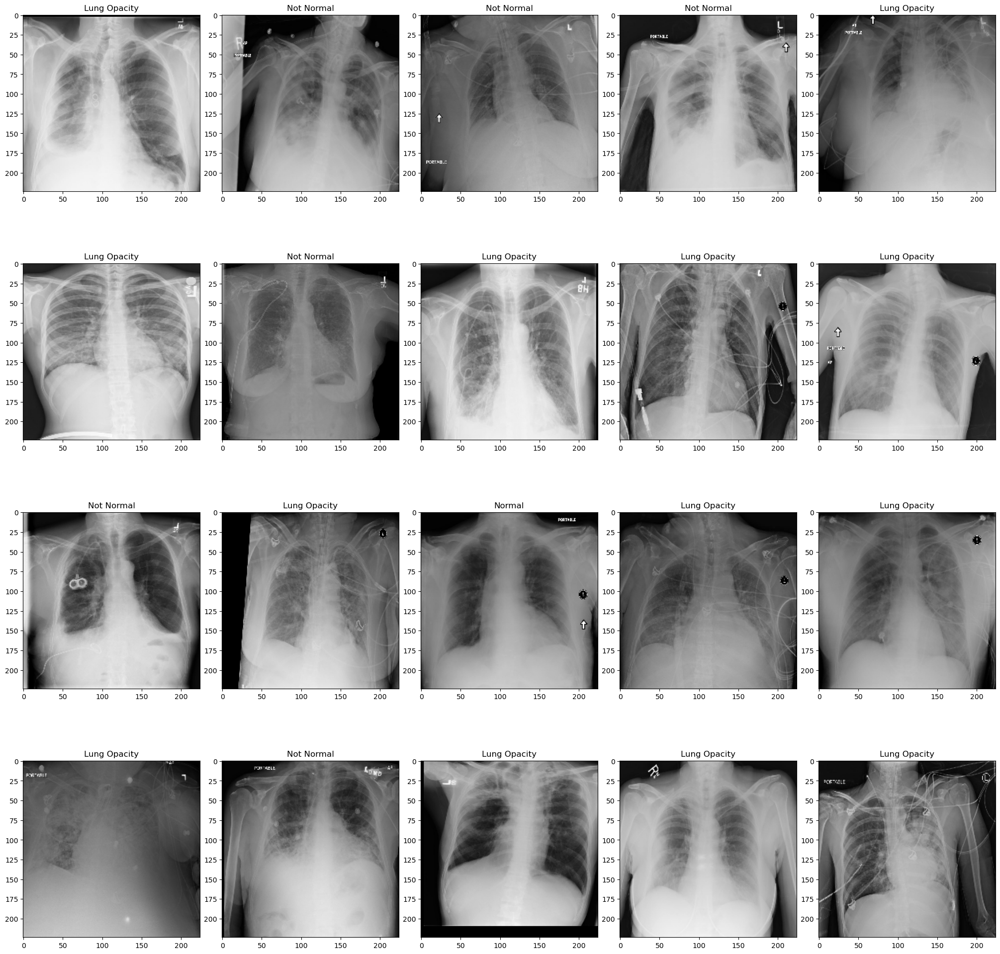

<Figure size 640x480 with 0 Axes>

,NAMES_JPG,NAMES_DCM,Image_Class,Image_Class_Category,Image_Target,Full_filename
5075,b8328cd5-8b9d-4834-aa79-053be9640655.jpg,b8328cd5-8b9d-4834-aa79-053be9640655.dcm,Lung Opacity,0,1,Training_jpg/b8328cd5-8b9d-4834-aa79-053be9640655.jpg
1960,468feb51-e690-4ba0-967d-62dec940b671.jpg,468feb51-e690-4ba0-967d-62dec940b671.dcm,Not Normal,2,0,Training_jpg/468feb51-e690-4ba0-967d-62dec940b671.jpg
2978,9a7bcfc0-6ccf-4d8f-9b02-ad56448761c5.jpg,9a7bcfc0-6ccf-4d8f-9b02-ad56448761c5.dcm,Not Normal,2,0,Training_jpg/9a7bcfc0-6ccf-4d8f-9b02-ad56448761c5.jpg
1726,c4542463-c7e3-4af7-a6d2-bb6cf6388012.jpg,c4542463-c7e3-4af7-a6d2-bb6cf6388012.dcm,Not Normal,2,0,Training_jpg/c4542463-c7e3-4af7-a6d2-bb6cf6388012.jpg
5407,57bffc6f-1656-45a2-9e49-e28d1dcbeee1.jpg,57bffc6f-1656-45a2-9e49-e28d1dcbeee1.dcm,Lung Opacity,0,1,Training_jpg/57bffc6f-1656-45a2-9e49-e28d1dcbeee1.jpg
5272,d5e9a92d-fb2f-416b-8731-4f7435d6c9c5.jpg,d5e9a92d-fb2f-416b-8731-4f7435d6c9c5.dcm,Lung Opacity,0,1,Training_jpg/d5e9a92d-fb2f-416b-8731-4f7435d6c9c5.jpg
724,9aeac4e0-68d4-4214-9e22-72facf654789.jpg,9aeac4e0-68d4-4214-9e22-72facf654789.dcm,Not Normal,2,0,Training_jpg/9aeac4e0-68d4-4214-9e22-72facf654789.jpg
5247,df21b6dd-32b7-4edd-8b7b-fa1a35e0c043.jpg,df21b6dd-32b7-4edd-8b7b-fa1a35e0c043.dcm,Lung Opacity,0,1,Training_jpg/df21b6dd-32b7-4edd-8b7b-fa1a35e0c043.jpg
4998,b7136f3f-41da-4b16-b7c3-4b929d81e6a5.jpg,b7136f3f-41da-4b16-b7c3-4b929d81e6a5.dcm,Lung Opacity,0,1,Training_jpg/b7136f3f-41da-4b16-b7c3-4b929d81e6a5.jpg
4789,348699f9-4eb2-42b7-b9e8-8bc3230b32a5.jpg,348699f9-4eb2-42b7-b9e8-8bc3230b32a5.dcm,Lung Opacity,0,1,Training_jpg/348699f9-4eb2-42b7-b9e8-8bc3230b32a5.jpg


In [143]:
show_jpg_images(20)

In [144]:
sample_1_jpg = NAMES_DF_FINAL[NAMES_DF_FINAL["Image_Target"] == 0].sample(n = 3000)

sample_2_jpg = NAMES_DF_FINAL[NAMES_DF_FINAL["Image_Target"] == 1].sample(n = 3000)

In [145]:
samples_jpg = [sample_1_jpg,sample_2_jpg]

In [146]:
result_jpg = pd.concat(samples_jpg)

In [147]:
print("Shape of the data selected for model building: ", result_jpg.shape)

print("\nNo.of rows of data selected for target 0 and 1:\n",result_jpg["Image_Target"].value_counts())

Shape of the data selected for model building:  (6000, 6)

No.of rows of data selected for target 0 and 1:
 0    3000
1    3000
Name: Image_Target, dtype: int64


In [148]:
images_6000_jpg = result_jpg.copy()

In [150]:
height = 224
width = 224
dim = (height, width)

X_target = []
brk = 0
i = 1 # initialisation

for img in tqdm(images_6000_jpg["Full_filename"].values):
    try:
        train_img_resize = cv2.resize(cv2.imread(img),dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk+=1
        print("breaking out for image ",img)
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|█████████████████████████████████████████████████████████████████████████████| 6000/6000 [00:43<00:00, 139.11it/s]


In [151]:
X_target =  np.asarray(X_target)

In [152]:
fileName = "Images_jpg_target_6000.pkl"
fileObject = open(fileName, 'wb')

pkl.dump(X_target, fileObject)
fileObject.close()

In [153]:
images_6000_jpg.to_pickle("images_6000_jpg.pkl") # pickling the proportionate target from 6000 jpg Images dataframe

In [154]:
image_pickle = open ("images_6000_jpg.pkl", "rb")
images_6000_jpg = pkl.load(image_pickle)
images_6000_jpg.sample(10).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,NAMES_JPG,NAMES_DCM,Image_Class,Image_Class_Category,Image_Target,Full_filename
3557,6a41e296-8bda-4f84-8766-c253246b77d0.jpg,6a41e296-8bda-4f84-8766-c253246b77d0.dcm,Lung Opacity,0,1,Training_jpg/6a41e296-8bda-4f84-8766-c253246b77d0.jpg
3350,bc234c2b-96aa-4263-931b-b7420c235daa.jpg,bc234c2b-96aa-4263-931b-b7420c235daa.dcm,Lung Opacity,0,1,Training_jpg/bc234c2b-96aa-4263-931b-b7420c235daa.jpg
5344,36cf3250-2ea6-4ef9-8143-c1bbafe83475.jpg,36cf3250-2ea6-4ef9-8143-c1bbafe83475.dcm,Lung Opacity,0,1,Training_jpg/36cf3250-2ea6-4ef9-8143-c1bbafe83475.jpg
3575,c3670fac-87af-4e1b-a1d4-3181427a60fc.jpg,c3670fac-87af-4e1b-a1d4-3181427a60fc.dcm,Lung Opacity,0,1,Training_jpg/c3670fac-87af-4e1b-a1d4-3181427a60fc.jpg
2021,fe4d9dea-1e2e-4ef4-886d-bf9a668b7850.jpg,fe4d9dea-1e2e-4ef4-886d-bf9a668b7850.dcm,Not Normal,2,0,Training_jpg/fe4d9dea-1e2e-4ef4-886d-bf9a668b7850.jpg
64,d5dec418-0f74-489f-b696-ce73e6016e40.jpg,d5dec418-0f74-489f-b696-ce73e6016e40.dcm,Normal,1,0,Training_jpg/d5dec418-0f74-489f-b696-ce73e6016e40.jpg
4488,ca6ed544-2804-4f23-97a6-5a9f4814e7c1.jpg,ca6ed544-2804-4f23-97a6-5a9f4814e7c1.dcm,Lung Opacity,0,1,Training_jpg/ca6ed544-2804-4f23-97a6-5a9f4814e7c1.jpg
2316,6e9329fc-862a-47dc-848f-fb560ed17096.jpg,6e9329fc-862a-47dc-848f-fb560ed17096.dcm,Not Normal,2,0,Training_jpg/6e9329fc-862a-47dc-848f-fb560ed17096.jpg
3255,add89c20-44cf-461a-9857-c41d753d4062.jpg,add89c20-44cf-461a-9857-c41d753d4062.dcm,Lung Opacity,0,1,Training_jpg/add89c20-44cf-461a-9857-c41d753d4062.jpg
1351,e5ffd138-39af-4e75-a79f-3531f2ff1b9e.jpg,e5ffd138-39af-4e75-a79f-3531f2ff1b9e.dcm,Normal,1,0,Training_jpg/e5ffd138-39af-4e75-a79f-3531f2ff1b9e.jpg


In [155]:
image_jpg = open ("Images_jpg_target_6000.pkl", "rb")
X = pkl.load(image_jpg)
X[0:2]

array([[[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        ...,

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
        

In [156]:
X_tar = np.array(X)

In [157]:
X_tar.shape

(6000, 224, 224, 3)

In [158]:
print(X_tar.max())
print(X_tar.min())

255
0


In [159]:
y1_tar = images_6000_jpg['Image_Target']

In [160]:
y1_tar.value_counts()

0    3000
1    3000
Name: Image_Target, dtype: int64

In [161]:
y1_tar_cat = to_categorical(y1_tar, num_classes=2)

print("Shape of y1_tar_cat:", y1_tar_cat.shape)

Shape of y1_tar_cat: (6000, 2)


In [162]:
y1_tar_cat[0:10]

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [163]:
print("X_tar shape",X_tar.shape)
print("y1_tar_cat shape",y1_tar_cat.shape)

X_tar shape (6000, 224, 224, 3)
y1_tar_cat shape (6000, 2)


In [164]:
X_train, X_test, y_train, y_test = train_test_split(X_tar, y1_tar_cat, test_size=.20, stratify=y1_tar_cat, random_state=1)  # 80% Training and 20% Testing

In [165]:
print("X_train",X_train.shape)
print("y_train",y_train.shape)  

print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (4800, 224, 224, 3)
y_train (4800, 2)
X_test (1200, 224, 224, 3)
y_test (1200, 2)


In [166]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% Testing

In [167]:
print("X_train1",X_train1.shape)
print("y_train1",y_train1.shape)  

print("X_val",X_val.shape)
print("y_val",y_val.shape)

X_train1 (3840, 224, 224, 3)
y_train1 (3840, 2)
X_val (960, 224, 224, 3)
y_val (960, 2)


In [168]:
print(X_val[0])
print(y_val[0])

[[[ 7  7  7]
  [16 16 16]
  [20 20 20]
  ...
  [18 18 18]
  [16 16 16]
  [16 16 16]]

 [[16 16 16]
  [28 28 28]
  [29 29 29]
  ...
  [23 23 23]
  [19 19 19]
  [19 19 19]]

 [[24 24 24]
  [37 37 37]
  [35 35 35]
  ...
  [26 26 26]
  [26 26 26]
  [23 23 23]]

 ...

 [[ 4  4  4]
  [ 5  5  5]
  [ 5  5  5]
  ...
  [ 5  5  5]
  [ 6  6  6]
  [ 6  6  6]]

 [[ 4  4  4]
  [ 4  4  4]
  [ 4  4  4]
  ...
  [ 4  4  4]
  [ 7  7  7]
  [ 7  7  7]]

 [[ 5  5  5]
  [ 4  4  4]
  [ 4  4  4]
  ...
  [ 4  4  4]
  [ 6  6  6]
  [ 6  6  6]]]
[1. 0.]


In [171]:
batch_size = 60
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
64/64 [==============================] - 44s 681ms/step - loss: 0.4550 - accuracy: 0.7818 - val_loss: 0.6614 - val_accuracy: 0.6990
Epoch 2/10
64/64 [==============================] - 47s 732ms/step - loss: 0.4115 - accuracy: 0.8094 - val_loss: 0.5971 - val_accuracy: 0.7312
Epoch 3/10
64/64 [==============================] - 46s 726ms/step - loss: 0.3861 - accuracy: 0.8227 - val_loss: 0.6779 - val_accuracy: 0.7167
Epoch 4/10
64/64 [==============================] - 46s 718ms/step - loss: 0.3687 - accuracy: 0.8310 - val_loss: 0.7029 - val_accuracy: 0.7031


In [173]:
batch_size = 60
nb_epochs = 10
history = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
64/64 [==============================] - 48s 748ms/step - loss: 0.6006 - accuracy: 0.6977 - val_loss: 0.6436 - val_accuracy: 0.6969
Epoch 2/10
64/64 [==============================] - 47s 731ms/step - loss: 0.5322 - accuracy: 0.7435 - val_loss: 0.5589 - val_accuracy: 0.7240
Epoch 3/10
64/64 [==============================] - 46s 718ms/step - loss: 0.4791 - accuracy: 0.7750 - val_loss: 0.5601 - val_accuracy: 0.7240
Epoch 4/10
64/64 [==============================] - 46s 724ms/step - loss: 0.4472 - accuracy: 0.7857 - val_loss: 0.5573 - val_accuracy: 0.7281
Epoch 5/10
64/64 [==============================] - 46s 721ms/step - loss: 0.4129 - accuracy: 0.8115 - val_loss: 0.6046 - val_accuracy: 0.6865
Epoch 6/10
64/64 [==============================] - 46s 726ms/step - loss: 0.3530 - accuracy: 0.8391 - val_loss: 0.6024 - val_accuracy: 0.7208


In [174]:
batch_size = 64
nb_epochs = 10
history = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 196s 3s/step - loss: 0.5938 - accuracy: 0.6948 - val_loss: 0.6786 - val_accuracy: 0.5938
Epoch 2/10
60/60 [==============================] - 193s 3s/step - loss: 0.5177 - accuracy: 0.7471 - val_loss: 0.6701 - val_accuracy: 0.6115
Epoch 3/10
60/60 [==============================] - 191s 3s/step - loss: 0.4903 - accuracy: 0.7589 - val_loss: 0.6044 - val_accuracy: 0.7167
Epoch 4/10
60/60 [==============================] - 191s 3s/step - loss: 0.4593 - accuracy: 0.7802 - val_loss: 0.6682 - val_accuracy: 0.6542
Epoch 5/10
60/60 [==============================] - 190s 3s/step - loss: 0.4254 - accuracy: 0.7945 - val_loss: 0.5609 - val_accuracy: 0.7292
Epoch 6/10
60/60 [==============================] - 190s 3s/step - loss: 0.3949 - accuracy: 0.8151 - val_loss: 0.5965 - val_accuracy: 0.7500
Epoch 7/10
60/60 [==============================] - 190s 3s/step - loss: 0.3667 - accuracy: 0.8349 - val_loss: 0.6143 - val_accuracy: 0.7167


In [175]:
batch_size = 64
nb_epochs = 10
history = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 177s 3s/step - loss: 0.5916 - accuracy: 0.6953 - val_loss: 0.5836 - val_accuracy: 0.7240
Epoch 2/10
60/60 [==============================] - 175s 3s/step - loss: 0.5511 - accuracy: 0.7253 - val_loss: 0.7166 - val_accuracy: 0.5406
Epoch 3/10
60/60 [==============================] - 175s 3s/step - loss: 0.5314 - accuracy: 0.7404 - val_loss: 0.5640 - val_accuracy: 0.7271
Epoch 4/10
60/60 [==============================] - 175s 3s/step - loss: 0.5120 - accuracy: 0.7479 - val_loss: 0.7512 - val_accuracy: 0.5542
Epoch 5/10
60/60 [==============================] - 154s 3s/step - loss: 0.5021 - accuracy: 0.7578 - val_loss: 0.5693 - val_accuracy: 0.7115


In [176]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

38/38 [==============================] - 7s 177ms/step - loss: 0.5346 - accuracy: 0.7383


In [177]:
RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

MODEL_NAME,LOSS,ACCURACY
model,75.890000,69.000000
model_2,59.700000,70.500000
model_2a,61.510000,68.670000
model_3,53.460000,73.830000


In [178]:
RESULTS.to_csv("FINE_TUNING_TO_JPG_RESULTS.csv")

# Fine Tuning 3.1: 
# Resize the JPEG images to 128x128 and train the models:

In [204]:
# Convert JPEG images to 128*128

height = 128
width = 128
dim = (height, width)

X_target = []
brk = 0
i = 1 # initialisation

for img in tqdm(images_6000_jpg["Full_filename"].values):
    try:
        train_img_resize = cv2.resize(cv2.imread(img),dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk+=1
        print("breaking out for image ",img)
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|█████████████████████████████████████████████████████████████████████████████| 6000/6000 [00:38<00:00, 155.36it/s]


In [181]:
X_tar =  np.asarray(X_target)

y1_tar = images_6000_jpg['Image_Target']

y1_tar.value_counts()

0    3000
1    3000
Name: Image_Target, dtype: int64

In [182]:
y1_tar_cat = to_categorical(y1_tar, num_classes=2)

print("Shape of y1_tar_cat:", y1_tar_cat.shape)

Shape of y1_tar_cat: (6000, 2)


In [183]:
y1_tar_cat[0:10]

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [184]:
print("X_tar shape",X_tar.shape)
print("y1_tar_cat shape",y1_tar_cat.shape)

X_tar shape (6000, 128, 128, 3)
y1_tar_cat shape (6000, 2)


In [185]:
X_train, X_test, y_train, y_test = train_test_split(X_tar, y1_tar_cat, test_size=.20, stratify=y1_tar_cat, random_state=1)  # 80% Training and 20% Testing

print("X_train",X_train.shape)
print("y_train",y_train.shape)

X_train (4800, 128, 128, 3)
y_train (4800, 2)


In [186]:
print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_test (1200, 128, 128, 3)
y_test (1200, 2)


In [187]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% Testing

print("X_train1",X_train1.shape)
print("y_train1",y_train1.shape)  

print("X_val",X_val.shape)
print("y_val",y_val.shape)

X_train1 (3840, 128, 128, 3)
y_train1 (3840, 2)
X_val (960, 128, 128, 3)
y_val (960, 2)


In [188]:
print(X_val[0])
print(y_val[0])

[[[18 18 18]
  [25 25 25]
  [28 28 28]
  ...
  [22 22 22]
  [19 19 19]
  [15 15 15]]

 [[34 34 34]
  [36 36 36]
  [41 41 41]
  ...
  [30 30 30]
  [27 27 27]
  [24 24 24]]

 [[42 42 42]
  [45 45 45]
  [46 46 46]
  ...
  [41 41 41]
  [37 37 37]
  [33 33 33]]

 ...

 [[ 5  5  5]
  [ 5  5  5]
  [ 5  5  5]
  ...
  [ 5  5  5]
  [ 5  5  5]
  [ 6  6  6]]

 [[ 5  5  5]
  [ 5  5  5]
  [ 5  5  5]
  ...
  [ 5  5  5]
  [ 5  5  5]
  [ 6  6  6]]

 [[ 6  6  6]
  [ 6  6  6]
  [ 5  5  5]
  ...
  [ 6  6  6]
  [ 6  6  6]
  [ 5  5  5]]]
[1. 0.]


In [189]:
tf.keras.backend.clear_session()

# Initialize the model
model = Sequential()

# Add a Convolutional Layer with 32 filters of size 7X7, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=32, kernel_size=7, strides=(2, 2), activation="relu", input_shape=(128, 128, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(BatchNormalization())

# Add a Convolutional Layer with 64 filters of size 5X5, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))

# model.add(Dropout(rate=0.3))

# model.add(GlobalMaxPooling2D())

# Apply Dropout with 0.2 probability 
# model.add(Dropout(rate=0.2))

# Add a Convolutional Layer with 64 filters of size 3X3 and activation function as 'relu' 
# model.add(Conv2D(filters=64, kernel_size=3, strides=(2, 2), activation="relu"))
# model.add(MaxPooling2D(pool_size=(2, 2)))
# model.add(BatchNormalization())

# Flatten the layer
model.add(Flatten())

# Add Fully Connected Layer with 128 units and activation function as 'relu'
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))

# model.add(Dropout(rate=0.3))

# model.add(BatchNormalization())

# model.add(Dense(128, activation="relu"))

#Add Fully Connected Layer with 3 units and activation function as 'softmax'
model.add(Dense(2, activation="sigmoid"))

In [247]:
optimizer = Adam(learning_rate=0.01)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 50, 50, 64)       256       
 hNormalization)                                                 
                                                        

In [191]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 11s 171ms/step - loss: 2.0457 - accuracy: 0.6555 - val_loss: 10.9216 - val_accuracy: 0.6021
Epoch 2/10
60/60 [==============================] - 10s 161ms/step - loss: 0.5977 - accuracy: 0.7036 - val_loss: 1.5250 - val_accuracy: 0.6250
Epoch 3/10
60/60 [==============================] - 10s 160ms/step - loss: 0.5896 - accuracy: 0.6883 - val_loss: 0.7360 - val_accuracy: 0.6990
Epoch 4/10
60/60 [==============================] - 10s 160ms/step - loss: 0.5509 - accuracy: 0.7201 - val_loss: 0.6632 - val_accuracy: 0.7021
Epoch 5/10
60/60 [==============================] - 10s 165ms/step - loss: 0.5440 - accuracy: 0.7320 - val_loss: 0.5619 - val_accuracy: 0.7312
Epoch 6/10
60/60 [==============================] - 10s 175ms/step - loss: 0.5294 - accuracy: 0.7352 - val_loss: 0.5498 - val_accuracy: 0.7312
Epoch 7/10
60/60 [==============================] - 10s 169ms/step - loss: 0.5253 - accuracy: 0.7411 - val_loss: 0.5506 - val_accuracy: 0.730

In [192]:
tf.keras.backend.clear_session()

# second model
model_2 = Sequential()

model_2.add(Conv2D(filters=32, kernel_size=7, strides=(2, 2), activation="relu", input_shape=(128, 128, 3)))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

model_2.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

#model_2.add(Dropout(rate=0.3))

model_2.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

model_2.add(Flatten())

model_2.add(Dense(128, activation="relu"))
# model_2.add(BatchNormalization())

model_2.add(Dense(84, activation="relu"))
# model_2.add(BatchNormalization())
model_2.add(Dense(42, activation="relu"))

model_2.add(Dense(2, activation="sigmoid"))

In [193]:
optimizer = Adam(learning_rate=0.001)
model_2.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 61, 61, 32)        4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 30, 30, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 30, 30, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 26, 26, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 13, 13, 64)       0         
 2D)                                                             
                                                        

In [194]:
batch_size = 64
nb_epochs = 10
history_2 = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.0001)])

Epoch 1/10
60/60 [==============================] - 11s 174ms/step - loss: 0.6044 - accuracy: 0.6930 - val_loss: 1.5019 - val_accuracy: 0.5000
Epoch 2/10
60/60 [==============================] - 10s 168ms/step - loss: 0.5583 - accuracy: 0.7234 - val_loss: 0.8792 - val_accuracy: 0.5875
Epoch 3/10
60/60 [==============================] - 10s 170ms/step - loss: 0.5395 - accuracy: 0.7365 - val_loss: 0.6353 - val_accuracy: 0.7063
Epoch 4/10
60/60 [==============================] - 10s 171ms/step - loss: 0.5238 - accuracy: 0.7497 - val_loss: 0.9062 - val_accuracy: 0.5521
Epoch 5/10
60/60 [==============================] - 10s 171ms/step - loss: 0.5115 - accuracy: 0.7529 - val_loss: 0.5849 - val_accuracy: 0.6875
Epoch 6/10
60/60 [==============================] - 10s 171ms/step - loss: 0.4860 - accuracy: 0.7628 - val_loss: 0.5983 - val_accuracy: 0.6969
Epoch 7/10
60/60 [==============================] - 10s 172ms/step - loss: 0.4744 - accuracy: 0.7716 - val_loss: 0.6039 - val_accuracy: 0.7083

In [195]:
tf.keras.backend.clear_session()

# second model
model_2a = Sequential()

model_2a.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), activation="relu", input_shape=(128, 128, 3)))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

model_2a.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

#model_2a.add(Conv2D(filters=512, kernel_size=3, strides=(1, 1), activation="relu"))
#model_2a.add(MaxPooling2D(pool_size=(2, 2)))
#model_2a.add(BatchNormalization())

model_2a.add(Flatten())

#model_2a.add(Dense(512, activation="relu"))
# model_2a.add(Dropout(rate=0.7))

model_2a.add(Dense(256, activation="relu"))
model_2a.add(Dropout(rate=0.25))

model_2a.add(Dense(128, activation="relu"))
# model_2a.add(Dropout(rate=0.3))

model_2a.add(Dense(64, activation="relu"))

model_2a.add(Dense(32, activation="relu"))

model_2a.add(Dense(2, activation="sigmoid"))

In [196]:
optimizer = Adam(learning_rate=0.0001)
model_2a.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 124, 124, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 62, 62, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 62, 62, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 58, 58, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 29, 29, 64)       0         
 2D)                                                             
                                                        

In [197]:
batch_size = 64
nb_epochs = 10
history_2a = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.01)])

Epoch 1/10
60/60 [==============================] - 43s 704ms/step - loss: 0.6161 - accuracy: 0.6706 - val_loss: 0.6527 - val_accuracy: 0.6875
Epoch 2/10
60/60 [==============================] - 45s 748ms/step - loss: 0.5679 - accuracy: 0.7182 - val_loss: 0.6016 - val_accuracy: 0.7125
Epoch 3/10
60/60 [==============================] - 47s 783ms/step - loss: 0.5503 - accuracy: 0.7214 - val_loss: 0.5577 - val_accuracy: 0.7385
Epoch 4/10
60/60 [==============================] - 47s 789ms/step - loss: 0.5364 - accuracy: 0.7318 - val_loss: 0.5452 - val_accuracy: 0.7375
Epoch 5/10
60/60 [==============================] - 48s 792ms/step - loss: 0.5254 - accuracy: 0.7383 - val_loss: 0.5456 - val_accuracy: 0.7406
Epoch 6/10
60/60 [==============================] - 48s 801ms/step - loss: 0.5046 - accuracy: 0.7526 - val_loss: 0.5574 - val_accuracy: 0.7260
Epoch 7/10
60/60 [==============================] - 48s 800ms/step - loss: 0.5071 - accuracy: 0.7508 - val_loss: 0.5760 - val_accuracy: 0.7229

In [198]:
tf.keras.backend.clear_session()

# second model
model_3 = Sequential()

model_3.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), activation="relu", input_shape=(128, 128, 3)))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(BatchNormalization())

model_3.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), kernel_initializer='normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))

model_3.add(Dropout(rate=0.3))

model_3.add(Flatten())

model_3.add(Dense(128, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(84, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(42, kernel_initializer='normal', activation="relu"))

model_3.add(Dense(2, activation="sigmoid"))

In [199]:
optimizer = Adam(learning_rate=0.0001)
model_3.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 124, 124, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 62, 62, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 58, 58, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 29, 29, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 27, 27, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 13, 13, 128)      0

In [200]:
batch_size = 64
nb_epochs = 10
history_3 = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=3, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 38s 621ms/step - loss: 0.6269 - accuracy: 0.6630 - val_loss: 0.6533 - val_accuracy: 0.6510
Epoch 2/10
60/60 [==============================] - 42s 703ms/step - loss: 0.5656 - accuracy: 0.7167 - val_loss: 0.6310 - val_accuracy: 0.6406
Epoch 3/10
60/60 [==============================] - 43s 716ms/step - loss: 0.5524 - accuracy: 0.7279 - val_loss: 0.5767 - val_accuracy: 0.7219
Epoch 4/10
60/60 [==============================] - 43s 715ms/step - loss: 0.5385 - accuracy: 0.7365 - val_loss: 0.5473 - val_accuracy: 0.7354
Epoch 5/10
60/60 [==============================] - 43s 711ms/step - loss: 0.5307 - accuracy: 0.7388 - val_loss: 0.5597 - val_accuracy: 0.7198
Epoch 6/10
60/60 [==============================] - 43s 715ms/step - loss: 0.5076 - accuracy: 0.7560 - val_loss: 0.5916 - val_accuracy: 0.7021
Epoch 7/10
60/60 [==============================] - 43s 712ms/step - loss: 0.5026 - accuracy: 0.7578 - val_loss: 0.5732 - val_accuracy: 0.7208

In [201]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

38/38 [==============================] - 2s 55ms/step - loss: 0.5660 - accuracy: 0.7225


In [202]:
RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

MODEL_NAME,LOSS,ACCURACY
model,53.580000,73.250000
model_2,61.660000,71.830000
model_2a,58.060000,70.580000
model_3,56.600000,72.250000


In [203]:
RESULTS.to_csv("JPG_128_128_LOSS_ACCURACY.csv",index = False)

    * Observations:
        - On reducing the jpeg images size to 128x128, there is no much improvement in accuracy.
        - It is expected because, some times reducing the size too much may lead loss of important information.
        - This is because, we already converted images from dicom to jpeg which might be reason for no improvement in accuracy.
        - We can observe the model training speed is very faster because of size reduction and less memory usage.

# Fine Tuning 3.2: 
# Resize the DICOM images to 128x128 and train the models:

In [205]:
img_rows=128
img_cols=128
dim = (img_rows, img_cols)

X_target = []
brk = 0
i = 1 # initialisation
for img in tqdm(Images_6000_Target["Full_filename"].values): 
    ds_3 = dicom.dcmread(img)
    img_3 = ds_3.pixel_array
    rgb = apply_color_lut(img_3, palette='PET')
    train_img = rgb
    try:
        train_img_resize = cv2.resize(train_img, dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk +=1
        print("breaking out for",img_3)
        break
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|██████████████████████████████████████████████████████████████████████████████| 6000/6000 [02:36<00:00, 38.33it/s]


In [208]:
X_tar =  np.asarray(X_target)

y1_tar = Images_6000_Target['Image_Target']

y1_tar.value_counts()

0    3000
1    3000
Name: Image_Target, dtype: int64

In [209]:
y1_tar_cat = to_categorical(y1_tar, num_classes=2)

print("Shape of y1_tar_cat:", y1_tar_cat.shape)

Shape of y1_tar_cat: (6000, 2)


In [210]:
print("X_tar shape",X_tar.shape)
print("y1_tar_cat shape",y1_tar_cat.shape)

X_tar shape (6000, 128, 128, 3)
y1_tar_cat shape (6000, 2)


In [211]:
X_train, X_test, y_train, y_test = train_test_split(X_tar, y1_tar_cat, test_size=.20, stratify=y1_tar_cat, random_state=1)  # 80% Training and 20% Testing

print("X_train",X_train.shape)
print("y_train",y_train.shape)  

print("X_test",X_test.shape)
print("y_test",y_test.shape)

X_train (4800, 128, 128, 3)
y_train (4800, 2)
X_test (1200, 128, 128, 3)
y_test (1200, 2)


In [212]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% Testing

print("X_train1",X_train1.shape)
print("y_train1",y_train1.shape)  

print("X_val",X_val.shape)
print("y_val",y_val.shape)

X_train1 (3840, 128, 128, 3)
y_train1 (3840, 2)
X_val (960, 128, 128, 3)
y_val (960, 2)


In [213]:
print(X_val[0])
print(y_val[0])

[[[ 0 97 95]
  [ 0 47 46]
  [ 0 19 18]
  ...
  [ 0 66 65]
  [ 0 66 64]
  [ 0 80 78]]

 [[ 0 92 90]
  [ 0 44 43]
  [ 0 16 15]
  ...
  [ 0 12 11]
  [ 0 14 13]
  [ 0 23 22]]

 [[ 0 92 90]
  [ 0 45 44]
  [ 0 14 13]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  6  5]]

 ...

 [[ 0  6  5]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  3  2]
  [ 0 26 25]
  [ 0 63 61]]

 [[ 0 15 14]
  [ 0  7  6]
  [ 0  7  6]
  ...
  [ 0  3  2]
  [ 0 24 23]
  [ 0 64 62]]

 [[ 0 22 21]
  [ 0 24 23]
  [ 0 17 16]
  ...
  [ 0  3  2]
  [ 0 27 26]
  [ 0 65 63]]]
[1. 0.]


In [215]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 30s 498ms/step - loss: 0.5331 - accuracy: 0.7383 - val_loss: 0.5408 - val_accuracy: 0.7396
Epoch 2/10
60/60 [==============================] - 29s 488ms/step - loss: 0.5188 - accuracy: 0.7427 - val_loss: 0.5625 - val_accuracy: 0.7437
Epoch 3/10
60/60 [==============================] - 29s 490ms/step - loss: 0.5063 - accuracy: 0.7417 - val_loss: 0.5367 - val_accuracy: 0.7542
Epoch 4/10
60/60 [==============================] - 29s 489ms/step - loss: 0.4823 - accuracy: 0.7615 - val_loss: 0.5322 - val_accuracy: 0.7417
Epoch 5/10
60/60 [==============================] - 29s 490ms/step - loss: 0.4720 - accuracy: 0.7638 - val_loss: 0.5391 - val_accuracy: 0.7510
Epoch 6/10
60/60 [==============================] - 29s 486ms/step - loss: 0.4721 - accuracy: 0.7651 - val_loss: 0.5544 - val_accuracy: 0.7542


In [216]:
batch_size = 64
nb_epochs = 10
history = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 31s 523ms/step - loss: 0.5176 - accuracy: 0.7484 - val_loss: 0.5956 - val_accuracy: 0.7125
Epoch 2/10
60/60 [==============================] - 31s 517ms/step - loss: 0.4639 - accuracy: 0.7750 - val_loss: 0.5294 - val_accuracy: 0.7552
Epoch 3/10
60/60 [==============================] - 32s 536ms/step - loss: 0.4211 - accuracy: 0.8042 - val_loss: 0.5347 - val_accuracy: 0.7573
Epoch 4/10
60/60 [==============================] - 32s 531ms/step - loss: 0.4129 - accuracy: 0.8083 - val_loss: 0.5951 - val_accuracy: 0.7063


In [217]:
batch_size = 64
nb_epochs = 10
history = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 137s 2s/step - loss: 0.5868 - accuracy: 0.6919 - val_loss: 0.5295 - val_accuracy: 0.7510
Epoch 2/10
60/60 [==============================] - 141s 2s/step - loss: 0.5361 - accuracy: 0.7323 - val_loss: 0.5266 - val_accuracy: 0.7469
Epoch 3/10
60/60 [==============================] - 143s 2s/step - loss: 0.5199 - accuracy: 0.7424 - val_loss: 0.5092 - val_accuracy: 0.7552
Epoch 4/10
60/60 [==============================] - 139s 2s/step - loss: 0.5071 - accuracy: 0.7589 - val_loss: 0.5193 - val_accuracy: 0.7510
Epoch 5/10
60/60 [==============================] - 140s 2s/step - loss: 0.4805 - accuracy: 0.7661 - val_loss: 0.5187 - val_accuracy: 0.7625


In [218]:
batch_size = 64
nb_epochs = 10
history = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 135s 2s/step - loss: 0.5936 - accuracy: 0.6911 - val_loss: 0.6041 - val_accuracy: 0.6969
Epoch 2/10
60/60 [==============================] - 134s 2s/step - loss: 0.5390 - accuracy: 0.7310 - val_loss: 0.5610 - val_accuracy: 0.7302
Epoch 3/10
60/60 [==============================] - 133s 2s/step - loss: 0.5317 - accuracy: 0.7370 - val_loss: 0.6009 - val_accuracy: 0.6823
Epoch 4/10
60/60 [==============================] - 133s 2s/step - loss: 0.5085 - accuracy: 0.7531 - val_loss: 0.5305 - val_accuracy: 0.7490
Epoch 5/10
60/60 [==============================] - 133s 2s/step - loss: 0.4935 - accuracy: 0.7596 - val_loss: 0.5251 - val_accuracy: 0.7510
Epoch 6/10
60/60 [==============================] - 137s 2s/step - loss: 0.4869 - accuracy: 0.7664 - val_loss: 0.5264 - val_accuracy: 0.7510
Epoch 7/10
60/60 [==============================] - 146s 2s/step - loss: 0.4746 - accuracy: 0.7745 - val_loss: 0.5238 - val_accuracy: 0.7510
Epoch 8/10
60

In [219]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 7s 174ms/step - loss: 0.5600 - accuracy: 0.7325


MODEL_NAME,LOSS,ACCURACY
model,55.070000,73.830000
model_2,61.080000,67.920000
model_2a,54.650000,73.080000
model_3,56.000000,73.250000


In [220]:
RESULTS.to_csv("DICOM_128x128_Accuracy_Loss.csv",index = False)

# Fine Tuning 4: 
# Modify optimizer parameters and changing loss function

    * Use 224x224 Dicom images data for training the model.
    * Add beta and epsilon in the Adam optimizer
    * Change to categorical_crossentropy from binary_crossentropy
    * Use models where input_size is 224x224

In [225]:
image_X_3 = open ("Images_X_3_target_6000.pkl", "rb")
X = pkl.load(image_X_3)

In [226]:
X_tar = np.array(X)

In [227]:
y1_tar = Images_6000_Target['Image_Target']
y1_tar_cat = to_categorical(y1_tar, num_classes=2)

In [228]:
X_train, X_test, y_train, y_test = train_test_split(X_tar, y1_tar_cat, test_size=.20, stratify=y1_tar_cat, random_state=1)  # 80% Training and 20% Testing

In [229]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, stratify=y_train, random_state=1)  # 80% Training and 20% validation

In [230]:
print("X_train",X_train.shape)
print("y_train",y_train.shape)  
print("")
print("X_test",X_test.shape)
print("y_test",y_test.shape)
print("")
print("X_val",X_val.shape)
print("y_val",y_val.shape)

X_train (4800, 224, 224, 3)
y_train (4800, 2)

X_test (1200, 224, 224, 3)
y_test (1200, 2)

X_val (960, 224, 224, 3)
y_val (960, 2)


In [237]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

model.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 50, 50, 64)       256       
 hNormalization)                                                 
                                                        

In [238]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 130s 2s/step - loss: 0.6349 - accuracy: 0.6740 - val_loss: 0.6424 - val_accuracy: 0.6448
Epoch 2/10
60/60 [==============================] - 128s 2s/step - loss: 0.4961 - accuracy: 0.7622 - val_loss: 0.5932 - val_accuracy: 0.6854
Epoch 3/10
60/60 [==============================] - 130s 2s/step - loss: 0.4248 - accuracy: 0.8089 - val_loss: 0.5791 - val_accuracy: 0.7021
Epoch 4/10
60/60 [==============================] - 129s 2s/step - loss: 0.3636 - accuracy: 0.8497 - val_loss: 0.5531 - val_accuracy: 0.7240
Epoch 5/10
60/60 [==============================] - 128s 2s/step - loss: 0.3106 - accuracy: 0.8872 - val_loss: 0.5593 - val_accuracy: 0.7156
Epoch 6/10
60/60 [==============================] - 126s 2s/step - loss: 0.2639 - accuracy: 0.9143 - val_loss: 0.5699 - val_accuracy: 0.7229


In [239]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

model_2.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 64)       0         
 2D)                                                             
                                                        

In [240]:
batch_size = 64
nb_epochs = 10
history = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 135s 2s/step - loss: 0.6248 - accuracy: 0.6591 - val_loss: 0.7425 - val_accuracy: 0.5365
Epoch 2/10
60/60 [==============================] - 134s 2s/step - loss: 0.5363 - accuracy: 0.7331 - val_loss: 0.6199 - val_accuracy: 0.6677
Epoch 3/10
60/60 [==============================] - 133s 2s/step - loss: 0.4941 - accuracy: 0.7635 - val_loss: 0.5708 - val_accuracy: 0.7115
Epoch 4/10
60/60 [==============================] - 134s 2s/step - loss: 0.4607 - accuracy: 0.7906 - val_loss: 0.5489 - val_accuracy: 0.7312
Epoch 5/10
60/60 [==============================] - 134s 2s/step - loss: 0.4323 - accuracy: 0.8130 - val_loss: 0.5407 - val_accuracy: 0.7333
Epoch 6/10
60/60 [==============================] - 135s 2s/step - loss: 0.4048 - accuracy: 0.8307 - val_loss: 0.5402 - val_accuracy: 0.7354
Epoch 7/10
60/60 [==============================] - 134s 2s/step - loss: 0.3792 - accuracy: 0.8474 - val_loss: 0.5410 - val_accuracy: 0.7396


In [241]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

model_2a.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [242]:
batch_size = 64
nb_epochs = 10
history = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 486s 8s/step - loss: 0.6483 - accuracy: 0.6344 - val_loss: 0.6356 - val_accuracy: 0.6313
Epoch 2/10
60/60 [==============================] - 657s 11s/step - loss: 0.5740 - accuracy: 0.7201 - val_loss: 0.6000 - val_accuracy: 0.7219
Epoch 3/10
60/60 [==============================] - 660s 11s/step - loss: 0.5566 - accuracy: 0.7180 - val_loss: 0.5627 - val_accuracy: 0.7333
Epoch 4/10
60/60 [==============================] - 662s 11s/step - loss: 0.5311 - accuracy: 0.7398 - val_loss: 0.5487 - val_accuracy: 0.7281
Epoch 5/10
60/60 [==============================] - 664s 11s/step - loss: 0.5235 - accuracy: 0.7396 - val_loss: 0.5421 - val_accuracy: 0.7333
Epoch 6/10
60/60 [==============================] - 577s 10s/step - loss: 0.5029 - accuracy: 0.7560 - val_loss: 0.5343 - val_accuracy: 0.7448
Epoch 7/10
60/60 [==============================] - 470s 8s/step - loss: 0.4948 - accuracy: 0.7560 - val_loss: 0.5312 - val_accuracy: 0.7375
Epoch 8/

In [243]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

model_3.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 51, 51, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 25, 25, 128)      0

In [244]:
batch_size = 64
nb_epochs = 10
history = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 471s 8s/step - loss: 0.8552 - accuracy: 0.5497 - val_loss: 0.7189 - val_accuracy: 0.5354
Epoch 2/10
60/60 [==============================] - 641s 11s/step - loss: 0.6591 - accuracy: 0.6362 - val_loss: 0.6445 - val_accuracy: 0.6385
Epoch 3/10
60/60 [==============================] - 638s 11s/step - loss: 0.6219 - accuracy: 0.6664 - val_loss: 0.5995 - val_accuracy: 0.6917
Epoch 4/10
60/60 [==============================] - 648s 11s/step - loss: 0.6093 - accuracy: 0.6836 - val_loss: 0.5757 - val_accuracy: 0.7115
Epoch 5/10
60/60 [==============================] - 640s 11s/step - loss: 0.5981 - accuracy: 0.6857 - val_loss: 0.5678 - val_accuracy: 0.6927
Epoch 6/10
60/60 [==============================] - 10691s 181s/step - loss: 0.5924 - accuracy: 0.6971 - val_loss: 0.5605 - val_accuracy: 0.6979
Epoch 7/10
60/60 [==============================] - 439s 7s/step - loss: 0.5731 - accuracy: 0.7094 - val_loss: 0.5578 - val_accuracy: 0.7125
Epoch

In [245]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 24s 625ms/step - loss: 0.5746 - accuracy: 0.6983


MODEL_NAME,LOSS,ACCURACY
model,59.080000,71.420000
model_2,56.940000,70.500000
model_2a,55.570000,71.830000
model_3,57.460000,69.830000


In [246]:
RESULTS.to_csv("Optimizer_and_loss_finetuning_1.csv",index = False)

    Observations:
        * Models are trained very slow due to learning rate very low.
        * There is no huge bump in the model accuracy compared to base models.

# Fine Tuning 5:
# Reduce the number of images per batch

    * Here we reduce the number of images per batch from 64 to 16
    * Dicom image contains huge data and when more images per batch are fed can incur in leaving out some meaningful data.
    * By reducing the no. of images per batch, we expect model to train better on images fed and thus increase the performance.

In [248]:
optimizer = Adam(learning_rate=0.01)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 50, 50, 64)       256       
 hNormalization)                                                 
                                                        

In [249]:
batch_size = 16
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
240/240 [==============================] - 126s 523ms/step - loss: 2.3675 - accuracy: 0.6521 - val_loss: 0.7864 - val_accuracy: 0.6979
Epoch 2/10
240/240 [==============================] - 124s 518ms/step - loss: 0.6270 - accuracy: 0.7078 - val_loss: 0.5919 - val_accuracy: 0.7208
Epoch 3/10
240/240 [==============================] - 124s 515ms/step - loss: 0.5769 - accuracy: 0.7193 - val_loss: 0.6178 - val_accuracy: 0.6854
Epoch 4/10
240/240 [==============================] - 122s 507ms/step - loss: 0.5692 - accuracy: 0.7224 - val_loss: 0.5901 - val_accuracy: 0.7250
Epoch 5/10
240/240 [==============================] - 122s 508ms/step - loss: 0.5425 - accuracy: 0.7297 - val_loss: 0.6170 - val_accuracy: 0.7000
Epoch 6/10
240/240 [==============================] - 123s 514ms/step - loss: 0.5504 - accuracy: 0.7211 - val_loss: 0.6445 - val_accuracy: 0.7073


In [250]:
optimizer = Adam(learning_rate=0.01)
model_2.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 109, 109, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 54, 54, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 50, 50, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 64)       0         
 2D)                                                             
                                                        

In [251]:
batch_size = 16
nb_epochs = 10
history = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
240/240 [==============================] - 120s 496ms/step - loss: 0.9150 - accuracy: 0.5143 - val_loss: 0.6935 - val_accuracy: 0.5000
Epoch 2/10
240/240 [==============================] - 116s 485ms/step - loss: 0.6941 - accuracy: 0.5042 - val_loss: 0.6933 - val_accuracy: 0.5000
Epoch 3/10
240/240 [==============================] - 115s 479ms/step - loss: 0.6934 - accuracy: 0.4930 - val_loss: 0.6931 - val_accuracy: 0.5000


In [252]:
optimizer = Adam(learning_rate=0.01)
model_2a.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [253]:
batch_size = 16
nb_epochs = 10
history = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
240/240 [==============================] - 443s 2s/step - loss: 0.9402 - accuracy: 0.6276 - val_loss: 0.5802 - val_accuracy: 0.6969
Epoch 2/10
240/240 [==============================] - 443s 2s/step - loss: 0.6269 - accuracy: 0.6826 - val_loss: 0.6670 - val_accuracy: 0.5906
Epoch 3/10
240/240 [==============================] - 441s 2s/step - loss: 0.6524 - accuracy: 0.6266 - val_loss: 0.6493 - val_accuracy: 0.5000


In [254]:
optimizer = Adam(learning_rate=0.01)
model_3.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 51, 51, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 25, 25, 128)      0

In [255]:
batch_size = 16
nb_epochs = 10
history = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
240/240 [==============================] - 417s 2s/step - loss: 0.9298 - accuracy: 0.5000 - val_loss: 0.6933 - val_accuracy: 0.5000
Epoch 2/10
240/240 [==============================] - 406s 2s/step - loss: 0.6936 - accuracy: 0.4844 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 3/10
240/240 [==============================] - 405s 2s/step - loss: 0.6935 - accuracy: 0.4969 - val_loss: 0.6933 - val_accuracy: 0.5000


In [256]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 21s 553ms/step - loss: 0.6933 - accuracy: 0.5000


MODEL_NAME,LOSS,ACCURACY
model,63.820000,69.170000
model_2,69.310000,50.000000
model_2a,64.930000,50.000000
model_3,69.330000,50.000000


In [257]:
RESULTS.to_csv("Reduce_Batch_Size.csv",index = False)

    Observations:
        * As the images per batch is reduced, accuracy takes a huge bump backwards and reduces to 50%
        * This behaviour is expected because, model failed to understand the patterns as there less images per batch.

# Fine Tuning 6:
# Increase images per batch:

    * We will increase the number of images per batch from 64 to 120
    * Giving more images per batch might lead to model understand more number of patterns in a single batch and train better

In [258]:
batch_size = 120
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
32/32 [==============================] - 106s 3s/step - loss: 0.4911 - accuracy: 0.7555 - val_loss: 0.5871 - val_accuracy: 0.7240
Epoch 2/10
32/32 [==============================] - 103s 3s/step - loss: 0.4547 - accuracy: 0.7755 - val_loss: 0.6005 - val_accuracy: 0.7250
Epoch 3/10
32/32 [==============================] - 104s 3s/step - loss: 0.4403 - accuracy: 0.7823 - val_loss: 0.6144 - val_accuracy: 0.7208


In [259]:
batch_size = 120
nb_epochs = 10
history = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
32/32 [==============================] - 110s 3s/step - loss: 0.6930 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 2/10
32/32 [==============================] - 110s 3s/step - loss: 0.6930 - accuracy: 0.5000 - val_loss: 0.6931 - val_accuracy: 0.5000
Epoch 3/10
32/32 [==============================] - 110s 3s/step - loss: 0.6930 - accuracy: 0.5000 - val_loss: 0.6932 - val_accuracy: 0.5000


In [260]:
batch_size = 120
nb_epochs = 10
history = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
32/32 [==============================] - 445s 14s/step - loss: 0.6361 - accuracy: 0.6518 - val_loss: 0.6157 - val_accuracy: 0.7073
Epoch 2/10
32/32 [==============================] - 466s 15s/step - loss: 0.6189 - accuracy: 0.7026 - val_loss: 0.5929 - val_accuracy: 0.7167
Epoch 3/10
32/32 [==============================] - 463s 14s/step - loss: 0.5974 - accuracy: 0.7227 - val_loss: 0.5850 - val_accuracy: 0.7250
Epoch 4/10
32/32 [==============================] - 485s 15s/step - loss: 0.5821 - accuracy: 0.7279 - val_loss: 0.5795 - val_accuracy: 0.7302
Epoch 5/10
32/32 [==============================] - 11978s 20s/step - loss: 0.5732 - accuracy: 0.7279 - val_loss: 0.5754 - val_accuracy: 0.7240
Epoch 6/10
32/32 [==============================] - 583s 18s/step - loss: 0.5696 - accuracy: 0.7266 - val_loss: 0.5779 - val_accuracy: 0.7135
Epoch 7/10
32/32 [==============================] - 584s 18s/step - loss: 0.5621 - accuracy: 0.7388 - val_loss: 0.5658 - val_accuracy: 0.7302
Epoc

In [261]:
batch_size = 120
nb_epochs = 10
history = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
32/32 [==============================] - 387s 12s/step - loss: 0.6933 - accuracy: 0.5000 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 2/10
32/32 [==============================] - 391s 12s/step - loss: 0.6932 - accuracy: 0.5000 - val_loss: 0.6932 - val_accuracy: 0.5000
Epoch 3/10
32/32 [==============================] - 393s 12s/step - loss: 0.6934 - accuracy: 0.4839 - val_loss: 0.6932 - val_accuracy: 0.5000


In [262]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 34s 905ms/step - loss: 0.6932 - accuracy: 0.5000


MODEL_NAME,LOSS,ACCURACY
model,61.090000,71.500000
model_2,69.320000,50.000000
model_2a,56.260000,71.580000
model_3,69.320000,50.000000


In [263]:
RESULTS.to_csv("Increase_Batch_Size.csv",index = False)

# Fine Tuning 7:
# Add / Update model layers:

    * Before this step, we have only tuned based on size of data, number of images, type of images, optimizers and loss function.
    * Now we are going to try modifying the model layers in the basemodels and try to improve the model performance.

In [276]:
tf.keras.backend.clear_session()

# Initialize the model
model = Sequential()

# Add a Convolutional Layer with 32 filters of size 7X7, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=32, kernel_size=3, strides=(1, 1), padding='same', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu", input_shape=(224, 224, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(BatchNormalization())

# model.add(Dropout(0.3))

# Add a Convolutional Layer with 64 filters of size 5X5, strides(2,2) and activation function as 'relu' 
model.add(Conv2D(filters=64, kernel_size=3, strides=(1, 1), padding='same', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(BatchNormalization())

model.add(Dropout(0.3))

# Flatten the layer
model.add(Flatten())

# Add Fully Connected Layer with 128 units and activation function as 'relu'
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))

#Add Fully Connected Layer with 3 units and activation function as 'softmax'
model.add(Dense(2, activation="sigmoid"))

In [277]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [278]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 258s 4s/step - loss: 373833.3125 - accuracy: 0.6779 - val_loss: 367506.0000 - val_accuracy: 0.7052
Epoch 2/10
60/60 [==============================] - 248s 4s/step - loss: 359018.6562 - accuracy: 0.7563 - val_loss: 352139.3750 - val_accuracy: 0.7198
Epoch 3/10
60/60 [==============================] - 247s 4s/step - loss: 344620.0000 - accuracy: 0.8026 - val_loss: 337732.8438 - val_accuracy: 0.7312
Epoch 4/10
60/60 [==============================] - 284s 5s/step - loss: 330597.5625 - accuracy: 0.8349 - val_loss: 323821.8750 - val_accuracy: 0.7010
Epoch 5/10
60/60 [==============================] - 289s 5s/step - loss: 316935.0000 - accuracy: 0.8841 - val_loss: 310343.5938 - val_accuracy: 0.7208
Epoch 6/10
60/60 [==============================] - 284s 5s/step - loss: 303653.0000 - accuracy: 0.9201 - val_loss: 297248.7188 - val_accuracy: 0.7260
Epoch 7/10
60/60 [==============================] - 286s 5s/step - loss: 290755.3438 - accurac

In [279]:
tf.keras.backend.clear_session()

# second model
model_2 = Sequential()

model_2.add(Conv2D(filters=32, kernel_size=7, strides=(2, 2), padding='same', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu", input_shape=(224, 224, 3)))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())

model_2.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), padding='same', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())
model_2.add(Dropout(rate=0.3))

model_2.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), padding='same', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model_2.add(MaxPooling2D(pool_size=(2, 2)))
model_2.add(BatchNormalization())
# model_2.add(Dropout(rate=0.7))

model_2.add(Flatten())

model_2.add(Dense(128, kernel_initializer='he_normal', activation="relu"))
# model_2.add(BatchNormalization())
# model_2.add(Dropout(rate=0.5))

model_2.add(Dense(84, kernel_initializer='he_normal', activation="relu"))
# model_2.add(BatchNormalization())
model_2.add(Dense(42, kernel_initializer='he_normal', activation="relu"))

model_2.add(Dense(2, activation="sigmoid"))

In [280]:
optimizer = Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_2.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 56, 56, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 28, 28, 64)       0         
 2D)                                                             
                                                        

In [281]:
batch_size = 64
nb_epochs = 10
history_2 = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 108s 2s/step - loss: 23017.2090 - accuracy: 0.6469 - val_loss: 2748.1780 - val_accuracy: 0.6313
Epoch 2/10
60/60 [==============================] - 108s 2s/step - loss: 1179.1445 - accuracy: 0.6654 - val_loss: 747.2348 - val_accuracy: 0.5844
Epoch 3/10
60/60 [==============================] - 126s 2s/step - loss: 612.2598 - accuracy: 0.6789 - val_loss: 622.0334 - val_accuracy: 0.5135
Epoch 4/10
60/60 [==============================] - 123s 2s/step - loss: 437.5329 - accuracy: 0.6924 - val_loss: 527.3038 - val_accuracy: 0.4990
Epoch 5/10
60/60 [==============================] - 123s 2s/step - loss: 313.8621 - accuracy: 0.6844 - val_loss: 431.1918 - val_accuracy: 0.5219
Epoch 6/10
60/60 [==============================] - 123s 2s/step - loss: 236.2792 - accuracy: 0.6909 - val_loss: 341.1299 - val_accuracy: 0.5000
Epoch 7/10
60/60 [==============================] - 123s 2s/step - loss: 189.0528 - accuracy: 0.6961 - val_loss: 259.9745 - va

In [282]:
tf.keras.backend.clear_session()

# second model
model_2a = Sequential()

model_2a.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu", input_shape=(224, 224, 3)))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

model_2a.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

model_2a.add(Flatten())

model_2a.add(Dense(256, kernel_initializer='he_normal', activation="relu"))
model_2a.add(Dropout(rate=0.25))

model_2a.add(Dense(128, kernel_initializer='he_normal', activation="relu"))

model_2a.add(Dense(64, kernel_initializer='he_normal', activation="relu"))

model_2a.add(Dense(32, kernel_initializer='he_normal', activation="relu"))

model_2a.add(Dense(2, activation="sigmoid"))

In [283]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_2a.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [284]:
batch_size = 64
nb_epochs = 10
history_2a = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 365s 6s/step - loss: 313694.4062 - accuracy: 0.6214 - val_loss: 296763.9062 - val_accuracy: 0.5875
Epoch 2/10
60/60 [==============================] - 360s 6s/step - loss: 277786.9688 - accuracy: 0.6849 - val_loss: 260931.8281 - val_accuracy: 0.7052
Epoch 3/10
60/60 [==============================] - 351s 6s/step - loss: 244889.1719 - accuracy: 0.6930 - val_loss: 229189.9531 - val_accuracy: 0.7229
Epoch 4/10
60/60 [==============================] - 397s 7s/step - loss: 214784.2812 - accuracy: 0.7044 - val_loss: 200388.6719 - val_accuracy: 0.6802
Epoch 5/10
60/60 [==============================] - 395s 7s/step - loss: 187482.0625 - accuracy: 0.7083 - val_loss: 174608.1875 - val_accuracy: 0.6812
Epoch 6/10
60/60 [==============================] - 393s 7s/step - loss: 163200.0625 - accuracy: 0.7107 - val_loss: 151705.8906 - val_accuracy: 0.6927
Epoch 7/10
60/60 [==============================] - 394s 7s/step - loss: 141574.5781 - accurac

In [285]:
tf.keras.backend.clear_session()

# second model
model_3 = Sequential()

model_3.add(Conv2D(filters=32, kernel_size=3, strides=(1, 1), padding='same', kernel_initializer='he_normal', activation="relu", input_shape=(224, 224, 3)))
model_3.add(MaxPooling2D(pool_size=(2, 2)))
model_3.add(BatchNormalization())

model_3.add(Conv2D(filters=64, kernel_size=3, strides=(1, 1), padding='same', kernel_initializer='he_normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))
model_3.add(BatchNormalization())

model_3.add(Dropout(rate=0.35))

model_3.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), padding='same', kernel_initializer='he_normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))
model_3.add(BatchNormalization())

model_3.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), padding='same', kernel_initializer='he_normal', activation="relu"))
model_3.add(MaxPooling2D(pool_size=(2, 2)))
model_3.add(BatchNormalization())

# model_3.add(Dropout(rate=0.35))

model_3.add(Flatten())

# model_3.add(Dense(624, kernel_initializer='he_normal', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
model_3.add(Dense(824, kernel_initializer='he_normal', activation="relu"))
# model_3.add(Dense(512, kernel_initializer='he_normal', kernel_regularizer = tf.keras.regularizers.l2(0.01), activity_regularizer = tf.keras.regularizers.l1(0.01), activation="relu"))
# model_3.add(Dense(512, kernel_initializer='he_normal', activation="relu"))
# model_3.add(Dense(300, kernel_initializer='he_normal', activation="relu"))

model_3.add(Dense(84, kernel_initializer='he_normal', activation="relu"))

model_3.add(Dense(42, kernel_initializer='he_normal', activation="relu"))

model_3.add(Dropout(rate=0.35))

model_3.add(Dense(2, activation="sigmoid"))

In [286]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_3.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [287]:
batch_size = 64
nb_epochs = 10
history_3 = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 284s 5s/step - loss: 0.6689 - accuracy: 0.6477 - val_loss: 0.6505 - val_accuracy: 0.6812
Epoch 2/10
60/60 [==============================] - 308s 5s/step - loss: 0.5731 - accuracy: 0.7156 - val_loss: 0.5848 - val_accuracy: 0.7177
Epoch 3/10
60/60 [==============================] - 308s 5s/step - loss: 0.5438 - accuracy: 0.7365 - val_loss: 0.5653 - val_accuracy: 0.7198
Epoch 4/10
60/60 [==============================] - 321s 5s/step - loss: 0.5135 - accuracy: 0.7565 - val_loss: 0.5697 - val_accuracy: 0.7219
Epoch 5/10
60/60 [==============================] - 388s 6s/step - loss: 0.4840 - accuracy: 0.7763 - val_loss: 0.5680 - val_accuracy: 0.7208


In [288]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 23s 603ms/step - loss: 0.5760 - accuracy: 0.7067


MODEL_NAME,LOSS,ACCURACY
model,24851053.120000,68.670000
model_2,10704.870000,50.670000
model_2a,8354901.560000,69.920000
model_3,57.600000,70.670000


In [289]:
RESULTS.to_csv("Add_Update_Model_Layers.csv",index = False)

    Observations:
        * We have added new layers, kernel_optimizers, activity_optimizers, padding, strides to the layers.
        * There is no improvement in the model accuracies.

# Fine Tuning 8:
# Using RMSProp Optimizer:

In [290]:
optimizer = RMSprop(learning_rate=0.00001, rho=0.9, momentum=0.9, epsilon=1e-07)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [291]:
batch_size = 64
nb_epochs = 10
history = model.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 446s 7s/step - loss: 194680.3594 - accuracy: 0.8076 - val_loss: 143168.9531 - val_accuracy: 0.6875
Epoch 2/10
60/60 [==============================] - 394s 7s/step - loss: 108535.7344 - accuracy: 0.8375 - val_loss: 78112.7812 - val_accuracy: 0.5594
Epoch 3/10
60/60 [==============================] - 386s 6s/step - loss: 57126.1641 - accuracy: 0.8503 - val_loss: 39935.3047 - val_accuracy: 0.5979
Epoch 4/10
60/60 [==============================] - 376s 6s/step - loss: 29403.8457 - accuracy: 0.8768 - val_loss: 21068.7168 - val_accuracy: 0.6375
Epoch 5/10
60/60 [==============================] - 384s 6s/step - loss: 13762.1348 - accuracy: 0.8974 - val_loss: 9990.2607 - val_accuracy: 0.5000
Epoch 6/10
60/60 [==============================] - 382s 6s/step - loss: 4994.7144 - accuracy: 0.9122 - val_loss: 5183.1089 - val_accuracy: 0.5000
Epoch 7/10
60/60 [==============================] - 395s 7s/step - loss: 1362.1005 - accuracy: 0.8971 - va

In [292]:
optimizer = RMSprop(learning_rate=0.00001, rho=0.9, momentum=0.9, epsilon=1e-07)
model_2.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 56, 56, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 28, 28, 64)       0         
 2D)                                                             
                                                        

In [293]:
batch_size = 64
nb_epochs = 10
history_2 = model_2.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 162s 3s/step - loss: 45.5135 - accuracy: 0.6370 - val_loss: 17.6134 - val_accuracy: 0.5146
Epoch 2/10
60/60 [==============================] - 160s 3s/step - loss: 12.8880 - accuracy: 0.5891 - val_loss: 6.5359 - val_accuracy: 0.5010
Epoch 3/10
60/60 [==============================] - 160s 3s/step - loss: 6.4028 - accuracy: 0.5654 - val_loss: 3.6476 - val_accuracy: 0.4979
Epoch 4/10
60/60 [==============================] - 174s 3s/step - loss: 4.1662 - accuracy: 0.5719 - val_loss: 2.7279 - val_accuracy: 0.5042
Epoch 5/10
60/60 [==============================] - 177s 3s/step - loss: 3.1581 - accuracy: 0.5792 - val_loss: 2.3110 - val_accuracy: 0.5042
Epoch 6/10
60/60 [==============================] - 177s 3s/step - loss: 2.5679 - accuracy: 0.5659 - val_loss: 2.0630 - val_accuracy: 0.5042
Epoch 7/10
60/60 [==============================] - 177s 3s/step - loss: 2.1788 - accuracy: 0.5648 - val_loss: 1.8385 - val_accuracy: 0.5052
Epoch 8/10

In [294]:
optimizer = RMSprop(learning_rate=0.00001, rho=0.9, momentum=0.9, epsilon=1e-07)
model_2a.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [295]:
batch_size = 64
nb_epochs = 10
history_2a = model_2a.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 542s 9s/step - loss: 37686.1016 - accuracy: 0.6768 - val_loss: 9170.2979 - val_accuracy: 0.5635
Epoch 2/10
60/60 [==============================] - 567s 9s/step - loss: 2617.6323 - accuracy: 0.6745 - val_loss: 5595.0859 - val_accuracy: 0.5000
Epoch 3/10
60/60 [==============================] - 564s 9s/step - loss: 416.0942 - accuracy: 0.6419 - val_loss: 7352.5571 - val_accuracy: 0.5000
Epoch 4/10
60/60 [==============================] - 529s 9s/step - loss: 140.3253 - accuracy: 0.5997 - val_loss: 7707.4409 - val_accuracy: 0.5000


In [296]:
optimizer = RMSprop(learning_rate=0.00001, rho=0.9, momentum=0.9, epsilon=1e-07)
model_3.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [297]:
batch_size = 64
nb_epochs = 10
history_3 = model_3.fit(X_train1, y_train1,
                    batch_size=batch_size,
                    epochs=nb_epochs, 
                    validation_data=(X_val, y_val),
                    initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
60/60 [==============================] - 456s 8s/step - loss: 0.6022 - accuracy: 0.7229 - val_loss: 0.5698 - val_accuracy: 0.7208
Epoch 2/10
60/60 [==============================] - 452s 8s/step - loss: 0.5490 - accuracy: 0.7518 - val_loss: 0.5737 - val_accuracy: 0.7208
Epoch 3/10
60/60 [==============================] - 453s 8s/step - loss: 0.4865 - accuracy: 0.7812 - val_loss: 0.5845 - val_accuracy: 0.7208


In [298]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(X_test,y_test)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 21s 540ms/step - loss: 0.6297 - accuracy: 0.7083


MODEL_NAME,LOSS,ACCURACY
model,28070.410000,50.000000
model_2,135.950000,50.750000
model_2a,770954.590000,50.000000
model_3,62.970000,70.830000


In [ ]:
RESULTS.to_csv("RMSProp_Optimizer.csv",index = False)

# Fine Tuning 9:
# Using Image Data Generator

In [16]:
Train_jpg, Test_jpg = train_test_split(NAMES_DF_FINAL, test_size=0.2, random_state=50,stratify=NAMES_DF_FINAL['Image_Target'])

In [17]:
Train_jpg1, Val_jpg = train_test_split(Train_jpg, test_size=0.2, random_state=50,stratify=Train_jpg['Image_Target'])

    * Split the 6000 jpeg images df into train, test and validation sets.
    * 3 Folders to be created - Training / Validation / Test Images folder. Seggregate the 6000 images into 3 folders as per test train split.
    * We have 3840 Images in Training folder, 1200 in Testing Folder and 960 in Validation Folder

In [18]:
print('Shape of Training Images:',Train_jpg1.shape)
print("")
print('Shape of Testing Images:',Test_jpg.shape)
print("")
print('Shape of Validation Images:',Val_jpg.shape)

Shape of Training Images: (3840, 6)

Shape of Testing Images: (1200, 6)

Shape of Validation Images: (960, 6)


In [21]:
dst1 = "Training_Images"
dst2 = "Validation_Images"
dst3 = "Testing_Images"

mode = 0o777

os.mkdir(dst1, mode)
os.mkdir(dst2, mode)
os.mkdir(dst3, mode)

In [22]:
# Source path
source = "Training_jpg"
 
# Destination path
destination = "Training_Images"

for item in Train_jpg1['NAMES_JPG']:
    file = item
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    #print("src_file",src_file)
    #print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

In [23]:
# Source path
source = "Training_jpg"
 
# Destination path
destination = "Validation_Images"

for item in Val_jpg['NAMES_JPG']:
    file = item
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    #print("src_file",src_file)
    #print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

In [24]:
# Source path
source = "Training_jpg"
 
# Destination path
destination = "Testing_Images"

for item in Test_jpg['NAMES_JPG']:
    file = item
    src_file = os.path.join(source+"/"+file)
    dst_file = os.path.join(destination+"/"+file)
    #print("src_file",src_file)
    #print("dst_file",dst_file)
    shutil.copyfile(src_file, dst_file)

In [19]:
Train_images_count = os.listdir("Training_Images") # your directory path
Training_number_files = len(Train_images_count)
print('Number of images in Training Folder:',Training_number_files)

Validation_images_count = os.listdir("Validation_Images") # your directory path
Validation_number_files = len(Validation_images_count)
print('\nNumber of images in Validation Folder:',Validation_number_files)

Test_images_count = os.listdir("Testing_Images") # your directory path
Test_number_files = len(Test_images_count)
print('\nNumber of images in Test Folder:',Test_number_files)

Number of images in Training Folder: 3840

Number of images in Validation Folder: 960

Number of images in Test Folder: 1200


In [20]:
Train_Target_category = tf.keras.utils.to_categorical(Train_jpg1["Image_Target"], num_classes=2)
Val_Target_category = tf.keras.utils.to_categorical(Val_jpg["Image_Target"], num_classes=2)
Test_Target_category = tf.keras.utils.to_categorical(Test_jpg["Image_Target"], num_classes=2)

In [21]:
Train_TC = np.asarray(Train_jpg1["Image_Target"]).astype('float32').reshape((-1,1))
Val_TC = np.asarray(Val_jpg["Image_Target"]).astype('float32').reshape((-1,1))
Test_TC = np.asarray(Test_jpg["Image_Target"]).astype('float32').reshape((-1,1))

In [22]:
Train_jpg1["Target_Cat"] = Train_jpg1['Image_Target'].apply(lambda x: "No" if x == 0 else "Yes")

Val_jpg["Target_Cat"] = Val_jpg['Image_Target'].apply(lambda x: "No" if x == 0 else "Yes")

Test_jpg["Target_Cat"] = Test_jpg['Image_Target'].apply(lambda x: "No" if x == 0 else "Yes")

In [23]:
Train_jpg1.sample(2)

,NAMES_JPG,NAMES_DCM,Image_Class,Image_Class_Category,Image_Target,Full_filename,Target_Cat
3272,da0d705d-7722-43d1-a880-a34c553f0719.jpg,da0d705d-7722-43d1-a880-a34c553f0719.dcm,Lung Opacity,0,1,Training_jpg/da0d705d-7722-43d1-a880-a34c553f0719.jpg,Yes
5152,00704310-78a8-4b38-8475-49f4573b2dbb.jpg,00704310-78a8-4b38-8475-49f4573b2dbb.dcm,Lung Opacity,0,1,Training_jpg/00704310-78a8-4b38-8475-49f4573b2dbb.jpg,Yes


In [24]:
Train_jpg1.sample(3)

,NAMES_JPG,NAMES_DCM,Image_Class,Image_Class_Category,Image_Target,Full_filename,Target_Cat
23,6326e2e5-d349-42e2-b42e-8dd63bc40d19.jpg,6326e2e5-d349-42e2-b42e-8dd63bc40d19.dcm,Not Normal,2,0,Training_jpg/6326e2e5-d349-42e2-b42e-8dd63bc40d19.jpg,No
4737,be9d0ed7-00ce-44b5-a83c-8a9796be8ea6.jpg,be9d0ed7-00ce-44b5-a83c-8a9796be8ea6.dcm,Lung Opacity,0,1,Training_jpg/be9d0ed7-00ce-44b5-a83c-8a9796be8ea6.jpg,Yes
1327,657b1ec2-8f10-4070-bfde-db020bbdb2fe.jpg,657b1ec2-8f10-4070-bfde-db020bbdb2fe.dcm,Normal,1,0,Training_jpg/657b1ec2-8f10-4070-bfde-db020bbdb2fe.jpg,No


In [25]:
train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input, 
                                   rotation_range = 20, 
                                   width_shift_range = 0.2, 
                                   height_shift_range = 0.2, 
                                   shear_range=0.2, 
                                   zoom_range=0.2)

'''
train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input,
                                   rotation_range = 20,
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True,
                                   fill_mode = 'nearest')
'''

"\ntrain_datagen = ImageDataGenerator(preprocessing_function = preprocess_input,\n                                   rotation_range = 20,\n                                   width_shift_range = 0.2,\n                                   height_shift_range = 0.2,\n                                   shear_range = 0.2,\n                                   zoom_range = 0.2,\n                                   horizontal_flip = True,\n                                   fill_mode = 'nearest')\n"

In [26]:
train_generator = train_datagen.flow_from_dataframe(
    dataframe = Train_jpg1, 
    directory = "Training_Images", 
    x_col = "NAMES_JPG", 
    y_col = "Target_Cat",
    class_mode = "categorical", 
    target_size = (224,224), 
    batch_size = 32, # batch_size,
    shuffle = True)

Found 3840 validated image filenames belonging to 2 classes.


In [27]:
valid_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)

In [28]:
valid_generator = valid_datagen.flow_from_dataframe(
    dataframe=Val_jpg, 
    directory="Validation_Images",
    x_col = "NAMES_JPG", 
    y_col="Target_Cat",
    class_mode="categorical", 
    target_size=(224,224),
    batch_size=32, # batch_size,
    shuffle = True)

Found 960 validated image filenames belonging to 2 classes.


In [29]:
Test_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)

In [30]:
Test_generator = Test_datagen.flow_from_dataframe(
    dataframe=Test_jpg, 
    directory="Testing_Images",
    x_col = "NAMES_JPG", 
    y_col="Target_Cat",
    class_mode="categorical", 
    target_size=(224,224),
    batch_size=32, # batch_size,
    shuffle = True)

Found 1200 validated image filenames belonging to 2 classes.


In [31]:
def round_up(n, decimals=0): 
    multiplier = 10 ** decimals 
    return math.ceil(n * multiplier) / multiplier

STEP_SIZE_TRAIN=round_up(train_generator.n/train_generator.batch_size)
STEP_SIZE_VALID=round_up(valid_generator.n/valid_generator.batch_size)

In [387]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"]) 
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [388]:
epochs = 10
history = model.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=epochs)

Epoch 1/10
120/120 [==============================] - 376s 3s/step - loss: 430164.6250 - accuracy: 0.5417 - val_loss: 385582.2812 - val_accuracy: 0.6365
Epoch 2/10
120/120 [==============================] - 343s 3s/step - loss: 416412.6875 - accuracy: 0.6021 - val_loss: 376150.7188 - val_accuracy: 0.6521
Epoch 3/10
120/120 [==============================] - 342s 3s/step - loss: 402261.3438 - accuracy: 0.5992 - val_loss: 365302.6250 - val_accuracy: 0.6187
Epoch 4/10
120/120 [==============================] - 341s 3s/step - loss: 392648.4688 - accuracy: 0.6021 - val_loss: 354030.9062 - val_accuracy: 0.6250
Epoch 5/10
120/120 [==============================] - 341s 3s/step - loss: 375942.5625 - accuracy: 0.6128 - val_loss: 342611.8125 - val_accuracy: 0.6323
Epoch 6/10
120/120 [==============================] - 342s 3s/step - loss: 365785.9688 - accuracy: 0.6096 - val_loss: 331324.6562 - val_accuracy: 0.6240
Epoch 7/10
120/120 [==============================] - 341s 3s/step - loss: 354067.

In [389]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_2.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 112, 112, 32)      4736      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 56, 56, 32)       0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 56, 56, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 64)        51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 28, 28, 64)       0         
 2D)                                                             
                                                        

In [390]:
epochs = 10
history_2 = model_2.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=epochs)

Epoch 1/10
120/120 [==============================] - 263s 2s/step - loss: 216717.4844 - accuracy: 0.5388 - val_loss: 190052.9375 - val_accuracy: 0.5979
Epoch 2/10
120/120 [==============================] - 262s 2s/step - loss: 202214.7188 - accuracy: 0.5151 - val_loss: 175923.6406 - val_accuracy: 0.5000
Epoch 3/10
120/120 [==============================] - 261s 2s/step - loss: 185344.5156 - accuracy: 0.5229 - val_loss: 162092.9688 - val_accuracy: 0.5094
Epoch 4/10
120/120 [==============================] - 268s 2s/step - loss: 171409.0625 - accuracy: 0.5073 - val_loss: 148565.8438 - val_accuracy: 0.5010
Epoch 5/10
120/120 [==============================] - 268s 2s/step - loss: 155862.4219 - accuracy: 0.5023 - val_loss: 135087.5625 - val_accuracy: 0.5000
Epoch 6/10
120/120 [==============================] - 264s 2s/step - loss: 142000.7031 - accuracy: 0.5078 - val_loss: 121572.3828 - val_accuracy: 0.5000
Epoch 7/10
120/120 [==============================] - 256s 2s/step - loss: 125898.

In [391]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_2a.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [394]:
epochs = 10
history_2a = model_2a.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=epochs)

Epoch 1/10
120/120 [==============================] - 749s 6s/step - loss: 436355.0000 - accuracy: 0.5714 - val_loss: 372988.6875 - val_accuracy: 0.5375
Epoch 2/10
120/120 [==============================] - 720s 6s/step - loss: 396310.9688 - accuracy: 0.5883 - val_loss: 344970.6250 - val_accuracy: 0.5000
Epoch 3/10
120/120 [==============================] - 3376s 28s/step - loss: 364014.9688 - accuracy: 0.5401 - val_loss: 316454.5625 - val_accuracy: 0.5000
Epoch 4/10
120/120 [==============================] - 714s 6s/step - loss: 339658.0000 - accuracy: 0.5451 - val_loss: 289452.6875 - val_accuracy: 0.4990
Epoch 5/10
120/120 [==============================] - 720s 6s/step - loss: 305067.5000 - accuracy: 0.5596 - val_loss: 263146.4688 - val_accuracy: 0.5625
Epoch 6/10
120/120 [==============================] - 5765s 48s/step - loss: 277047.8438 - accuracy: 0.5688 - val_loss: 237048.2656 - val_accuracy: 0.5146
Epoch 7/10
120/120 [==============================] - 588s 5s/step - loss: 249

In [395]:
optimizer = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
model_3.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"]) 
model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 224, 224, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 112, 112, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 56, 56, 64)       0         
 2D)                                                             
                                                        

In [396]:
epochs = 10
history_3 = model_3.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=epochs)

Epoch 1/10
120/120 [==============================] - 464s 4s/step - loss: 0.8961 - accuracy: 0.5992 - val_loss: 0.6608 - val_accuracy: 0.5865
Epoch 2/10
120/120 [==============================] - 417s 3s/step - loss: 0.6789 - accuracy: 0.6359 - val_loss: 0.6316 - val_accuracy: 0.6646
Epoch 3/10
120/120 [==============================] - 441s 4s/step - loss: 0.6567 - accuracy: 0.6500 - val_loss: 0.6065 - val_accuracy: 0.6687
Epoch 4/10
120/120 [==============================] - 474s 4s/step - loss: 0.6378 - accuracy: 0.6703 - val_loss: 0.5803 - val_accuracy: 0.7063
Epoch 5/10
120/120 [==============================] - 591s 5s/step - loss: 0.6161 - accuracy: 0.6753 - val_loss: 0.5961 - val_accuracy: 0.6823
Epoch 6/10
120/120 [==============================] - 582s 5s/step - loss: 0.6287 - accuracy: 0.6661 - val_loss: 0.5706 - val_accuracy: 0.7125
Epoch 7/10
120/120 [==============================] - 577s 5s/step - loss: 0.6133 - accuracy: 0.6737 - val_loss: 0.5638 - val_accuracy: 0.7135

In [399]:
RESULTS = pd.DataFrame()

loss_1, accuracy_1 = model.evaluate(Test_generator)
RESULTS = RESULTS.append(pd.Series(["model",np.round((loss_1*100),2),np.round((accuracy_1*100),2)]),ignore_index=True)

loss_2, accuracy_2 = model_2.evaluate(Test_generator)
RESULTS = RESULTS.append(pd.Series(["model_2",np.round((loss_2*100),2),np.round((accuracy_2*100),2)]),ignore_index=True)

loss_2a, accuracy_2a = model_2a.evaluate(Test_generator)
RESULTS = RESULTS.append(pd.Series(["model_2a",np.round((loss_2a*100),2),np.round((accuracy_2a*100),2)]),ignore_index=True)

loss_3, accuracy_3 = model_3.evaluate(Test_generator)
RESULTS = RESULTS.append(pd.Series(["model_3",np.round((loss_3*100),2),np.round((accuracy_3*100),2)]),ignore_index=True)

RESULTS.columns = ['MODEL_NAME','LOSS','ACCURACY']

RESULTS.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

38/38 [==============================] - 19s 486ms/step - loss: 0.6062 - accuracy: 0.6867


MODEL_NAME,LOSS,ACCURACY
model,29586746.880000,63.330000
model_2,1453439.450000,50.000000
model_2a,14527342.190000,61.420000
model_3,60.620000,68.670000


In [398]:
RESULTS.to_csv("Using_Image_data_generator.csv",index = False)

# Building Final Model:

In [107]:
X_train10k, X_test10k, y_train10k, y_test10k = train_test_split(X_tar_10k, y1_tar_cat_10k, test_size=.30, 
                                                    stratify=y1_tar_cat_10k, random_state=1)  # 70% Training and 20% Testing

In [108]:
tf.keras.backend.clear_session()

# second model
model_2a = Sequential()

model_2a.add(Conv2D(filters=32, kernel_size=5, strides=(1, 1), activation="relu", input_shape=(224, 224, 3)))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=64, kernel_size=5, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Conv2D(filters=128, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

model_2a.add(Conv2D(filters=256, kernel_size=3, strides=(1, 1), activation="relu"))
model_2a.add(MaxPooling2D(pool_size=(2, 2)))
model_2a.add(BatchNormalization())

model_2a.add(Dropout(rate=0.2))

#model_2a.add(Conv2D(filters=512, kernel_size=3, strides=(1, 1), activation="relu"))
#model_2a.add(MaxPooling2D(pool_size=(2, 2)))
#model_2a.add(BatchNormalization())

model_2a.add(Flatten())

#model_2a.add(Dense(512, activation="relu"))
# model_2a.add(Dropout(rate=0.7))

model_2a.add(Dense(256, activation="relu"))
model_2a.add(Dropout(rate=0.25))

model_2a.add(Dense(128, activation="relu"))
# model_2a.add(Dropout(rate=0.3))

model_2a.add(Dense(64, activation="relu"))

model_2a.add(Dense(32, activation="relu"))

model_2a.add(Dense(2, activation="sigmoid"))

In [109]:
optimizer = Adam(learning_rate=0.01)
model_2a.compile(optimizer = optimizer , loss = "binary_crossentropy", metrics=["accuracy"])

model_2a.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 220, 220, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 110, 110, 32)     0         
 )                                                               
                                                                 
 batch_normalization (BatchN  (None, 110, 110, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 106, 106, 64)      51264     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 53, 53, 64)       0         
 2D)                                                             
                                                        

In [112]:
batch_size = 70
nb_epochs = 20

history_final = model_2a.fit(X_train10k, y_train10k,
                             batch_size=batch_size,
                             epochs=nb_epochs, 
                             initial_epoch=0,
                             callbacks=[EarlyStopping(monitor='loss', patience=2, min_delta=0.001)])

Epoch 1/20
100/100 [==============================] - 649s 7s/step - loss: 0.5757 - accuracy: 0.7131
Epoch 2/20
100/100 [==============================] - 338s 3s/step - loss: 0.5713 - accuracy: 0.7149
Epoch 3/20
100/100 [==============================] - 333s 3s/step - loss: 0.5633 - accuracy: 0.7191
Epoch 4/20
100/100 [==============================] - 3329s 34s/step - loss: 0.5385 - accuracy: 0.7367
Epoch 5/20
100/100 [==============================] - 339s 3s/step - loss: 0.5289 - accuracy: 0.7437
Epoch 6/20
100/100 [==============================] - 334s 3s/step - loss: 0.5240 - accuracy: 0.7459
Epoch 7/20
100/100 [==============================] - 332s 3s/step - loss: 0.5045 - accuracy: 0.7550
Epoch 8/20
100/100 [==============================] - 333s 3s/step - loss: 0.4956 - accuracy: 0.7616
Epoch 9/20
100/100 [==============================] - 332s 3s/step - loss: 0.4948 - accuracy: 0.7636
Epoch 10/20
100/100 [==============================] - 297s 3s/step - loss: 0.5021 - accu

In [113]:
model_2a.evaluate(X_test10k,y_test10k)

94/94 [==============================] - 19s 200ms/step - loss: 0.5642 - accuracy: 0.7340


[0.5642110109329224, 0.734000027179718]

In [115]:
y_pred_2a = model_2a.predict(X_test10k)
y_test_arg=np.argmax(y_test10k,axis=1)
Y_pred_2a = np.argmax(y_pred_2a,axis=1)
print(confusion_matrix(y_test_arg, Y_pred_2a))

94/94 [==============================] - 20s 204ms/step
[[ 985  515]
 [ 283 1217]]


In [116]:
print(classification_report(y_test_arg, Y_pred_2a))

              precision    recall  f1-score   support

           0       0.78      0.66      0.71      1500
           1       0.70      0.81      0.75      1500

    accuracy                           0.73      3000
   macro avg       0.74      0.73      0.73      3000
weighted avg       0.74      0.73      0.73      3000



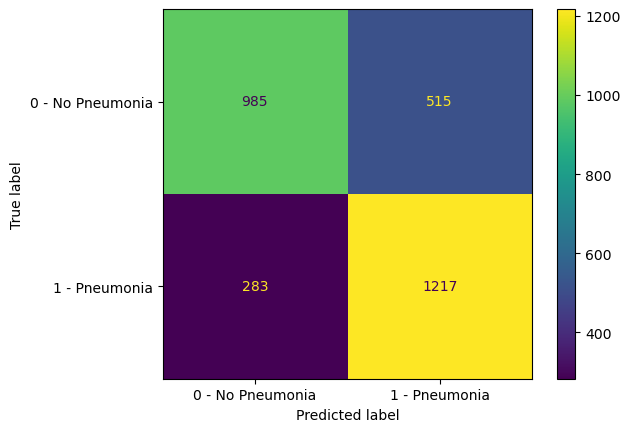

In [117]:
cm = confusion_matrix(y_test_arg, Y_pred_2a)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

    **************************** END OF FINE TUNING ****************************

# Step 2: Apply Transfer Learning model for classification

# Transfer learning using VGG 16

    * Transfer Learning:
        
        VGG-16
        RESTNET-50
        INCEPTION-V3
        DENSENET 121 WITH IMAGENET WEIGHTS
        DENSENET 121 WITH CHEXNET WEIGHTS
        
    * Data Used:
        X_train1 - Training images dataset containing 3840 dicom images of size 224x224x3
        Y_train1 - Target class to 3840 train data
        X_test - Testing images dataset containing 1200 dicom images of size 224x224x3
        Y_test - Target class to 1200 test data
        X_val - Validation images dataset containing 960 dicom images of size 224x224x3
        Y_val - Target class to 960 validation data
        
        train_generator - Image augmentation done on 3840 training images
        Test_generator - Image augmentation done on 1200 testing images
        Val_generator - Image augmentation done on 960 validation images

In [118]:
model_vgg = VGG16(input_shape=(224,224,3), weights='imagenet', include_top=False)
print(model_vgg.summary())

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [119]:
# don't train existing weights
for layer in model_vgg.layers:
    layer.trainable = False

In [122]:
# our layers
x = Flatten()(model_vgg.output)

# Add a fully connected layer with 512 hidden units and ReLU activation
x = Dense(128, kernel_initializer='he_normal', activation='relu')(x)

x = Dense(84, kernel_initializer='he_normal', activation='relu')(x)

x = Dense(42, kernel_initializer='he_normal', activation='relu')(x)

# Add a dropout rate of 0.5
x = Dropout(0.3)(x)

# Add a final sigmoid layer with 1 node for classification output
x = Dense(2, activation='sigmoid')(x)

model_vgg_1 = tf.keras.models.Model(model_vgg.input, x)

model_vgg_1.compile(optimizer = tf.keras.optimizers.RMSprop(lr=0.0001), loss = 'binary_crossentropy',metrics = ['acc'])
print(x)

# x = Dense(1000, activation='relu')(x)
# prediction = Dense(2, activation='sigmoid')(x)

KerasTensor(type_spec=TensorSpec(shape=(None, 2), dtype=tf.float32, name=None), name='dense_12/Sigmoid:0', description="created by layer 'dense_12'")


In [124]:
#Using pixel arrays

batch_size = 60
nb_epochs = 10

history_vggi = model_vgg_1.fit(X_train1,y_train1, 
                               batch_size=batch_size, 
                               epochs=nb_epochs,  
                               validation_data=(X_val,y_val), 
                               initial_epoch=0)

Epoch 1/10
64/64 [==============================] - 313s 5s/step - loss: 0.3477 - acc: 0.8586 - val_loss: 0.7265 - val_acc: 0.6865
Epoch 2/10
64/64 [==============================] - 339s 5s/step - loss: 0.2760 - acc: 0.8948 - val_loss: 0.8873 - val_acc: 0.7198
Epoch 3/10
64/64 [==============================] - 338s 5s/step - loss: 0.2010 - acc: 0.9253 - val_loss: 0.9280 - val_acc: 0.7208
Epoch 4/10
64/64 [==============================] - 338s 5s/step - loss: 0.1821 - acc: 0.9365 - val_loss: 0.9055 - val_acc: 0.7146
Epoch 5/10
64/64 [==============================] - 338s 5s/step - loss: 0.1453 - acc: 0.9471 - val_loss: 0.9951 - val_acc: 0.7156
Epoch 6/10
64/64 [==============================] - 338s 5s/step - loss: 0.1064 - acc: 0.9628 - val_loss: 1.1589 - val_acc: 0.7167
Epoch 7/10
64/64 [==============================] - 337s 5s/step - loss: 0.0915 - acc: 0.9703 - val_loss: 1.1338 - val_acc: 0.7198
Epoch 8/10
64/64 [==============================] - 340s 5s/step - loss: 0.0821 - a

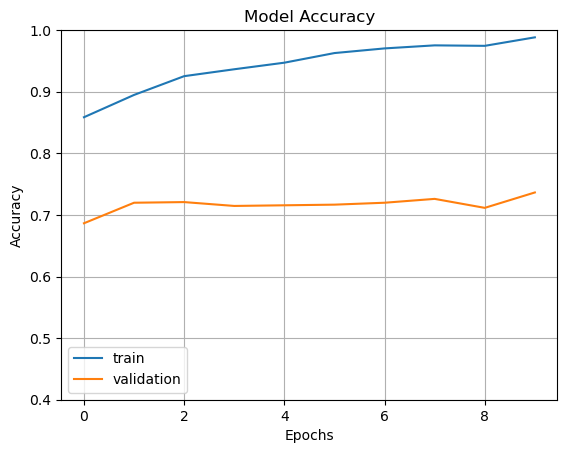

In [125]:
fig1 = plt.gcf()
plt.plot(history_vggi.history['acc'])
plt.plot(history_vggi.history['val_acc'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

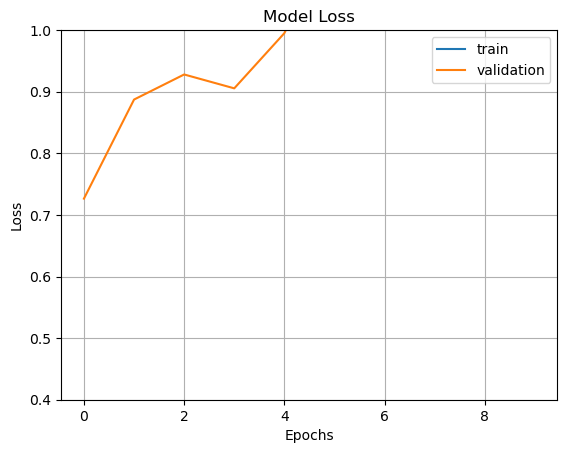

In [126]:
fig1 = plt.gcf()
plt.plot(history_vggi.history['loss'])
plt.plot(history_vggi.history['val_loss'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [129]:
loss_trainvgg, accuracy_trainvgg = model_vgg_1.evaluate(X_train1,y_train1)
loss_valvgg, accuracy_valvgg = model_vgg_1.evaluate(X_val,y_val)
loss_testvgg, accuracy_testvgg = model_vgg_1.evaluate(X_test,y_test)

38/38 [==============================] - 70s 2s/step - loss: 1.6251 - acc: 0.7125


In [130]:
y_pred_vgg = model_vgg_1.predict(X_test)

38/38 [==============================] - 69s 2s/step


In [131]:
y_test_arg_vgg = np.argmax(y_test,axis=1)
y_pred_vgg = np.argmax(y_pred_vgg,axis=1)
print(confusion_matrix(y_test_arg_vgg, y_pred_vgg))

[[416 184]
 [161 439]]


In [132]:
Accuracy =metrics.accuracy_score(y_test_arg_vgg,y_pred_vgg)
Precision=metrics.precision_score(y_test_arg_vgg, y_pred_vgg)
Recall   =metrics.recall_score(y_test_arg_vgg, y_pred_vgg)
F1_score =metrics.f1_score(y_test_arg_vgg, y_pred_vgg)
ROC      =metrics.roc_auc_score(y_test_arg_vgg, y_pred_vgg)

In [133]:
Pre_trained_results = pd.DataFrame()

vgg_series = pd.Series(["VGG 16", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(vgg_series, ignore_index = True)

In [136]:
#Using Imagedatagenerator for train and val

STEP_SIZE_TRAIN=round_up(train_generator.n/train_generator.batch_size)
STEP_SIZE_VALID=round_up(valid_generator.n/valid_generator.batch_size)
                         
history_vggi = model_vgg_1.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=15)

Epoch 1/15
120/120 [==============================] - 311s 3s/step - loss: 1.4532 - acc: 0.6281 - val_loss: 0.6072 - val_acc: 0.7208
Epoch 2/15
120/120 [==============================] - 351s 3s/step - loss: 0.6461 - acc: 0.6867 - val_loss: 0.5692 - val_acc: 0.7469
Epoch 3/15
120/120 [==============================] - 350s 3s/step - loss: 0.6244 - acc: 0.6964 - val_loss: 0.5626 - val_acc: 0.7542
Epoch 4/15
120/120 [==============================] - 332s 3s/step - loss: 0.6046 - acc: 0.7146 - val_loss: 0.5542 - val_acc: 0.7469
Epoch 5/15
120/120 [==============================] - 340s 3s/step - loss: 0.5996 - acc: 0.7169 - val_loss: 0.5891 - val_acc: 0.7437
Epoch 6/15
120/120 [==============================] - 354s 3s/step - loss: 0.6023 - acc: 0.7359 - val_loss: 0.5317 - val_acc: 0.7615
Epoch 7/15
120/120 [==============================] - 294s 2s/step - loss: 0.5859 - acc: 0.7318 - val_loss: 0.5500 - val_acc: 0.7646
Epoch 8/15
120/120 [==============================] - 278s 2s/step - 

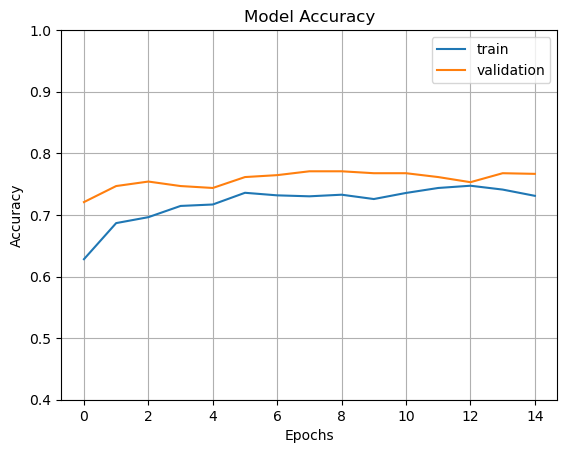

In [137]:
fig1 = plt.gcf()
plt.plot(history_vggi.history['acc'])
plt.plot(history_vggi.history['val_acc'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

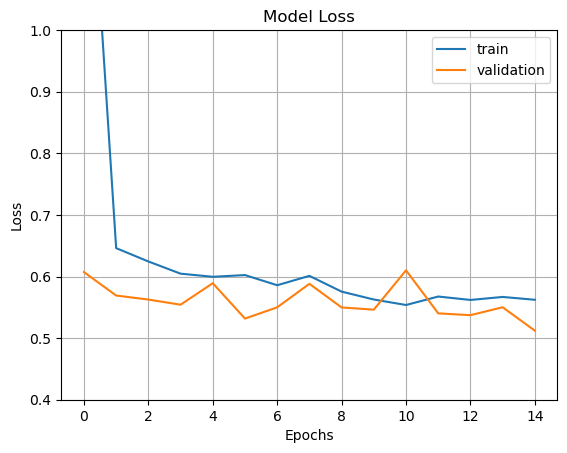

In [138]:
fig1 = plt.gcf()
plt.plot(history_vggi.history['loss'])
plt.plot(history_vggi.history['val_loss'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [141]:
loss_trainvgg, accuracy_trainvgg = model_vgg_1.evaluate(train_generator)
loss_valvgg, accuracy_valvgg = model_vgg_1.evaluate(valid_generator)
loss_testvgg, accuracy_testvgg = model_vgg_1.evaluate(Test_generator)

38/38 [==============================] - 86s 2s/step - loss: 0.5654 - acc: 0.7425


In [142]:
y_pred_vgg = model_vgg_1.predict(X_test)

38/38 [==============================] - 70s 2s/step


In [143]:
y_test_arg_vgg = np.argmax(y_test,axis=1)
y_pred_vgg = np.argmax(y_pred_vgg,axis=1)
print(confusion_matrix(y_test_arg_vgg, y_pred_vgg))

[[495 105]
 [299 301]]


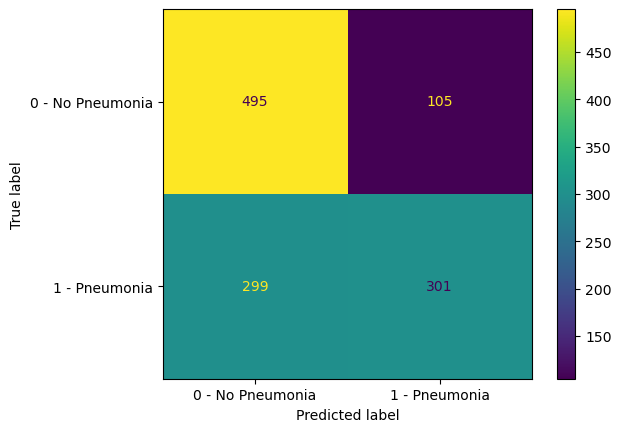

In [149]:
cm = confusion_matrix(y_test_arg_vgg, y_pred_vgg)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

In [144]:
Accuracy =metrics.accuracy_score(y_test_arg_vgg,y_pred_vgg)
Precision=metrics.precision_score(y_test_arg_vgg, y_pred_vgg)
Recall   =metrics.recall_score(y_test_arg_vgg, y_pred_vgg)
F1_score =metrics.f1_score(y_test_arg_vgg, y_pred_vgg)
ROC      =metrics.roc_auc_score(y_test_arg_vgg, y_pred_vgg)

In [145]:
vgg_series = pd.Series(["VGG 16 Using IDG", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(vgg_series, ignore_index = True)

In [151]:
print("VGG16 - Accuracy: ",Accuracy)
print("VGG16 - Precision: ",Precision)
print("VGG16 - Recall: ",Recall)
print("VGG16 - F1 score: ",F1_score)
print("VGG16 - ROC: ",ROC)

VGG16 - Accuracy:  0.6633333333333333
VGG16 - Precision:  0.7413793103448276
VGG16 - Recall:  0.5016666666666667
VGG16 - F1 score:  0.5984095427435389
VGG16 - ROC:  0.6633333333333333


# Transfer Learning using RestNet50

In [152]:
resnet_model_1 = Sequential()

pretrained_model= tf.keras.applications.ResNet50(include_top=False, 
                                                 input_shape=(224,224,3), pooling='avg',classes=2, weights='imagenet')

for layer in pretrained_model.layers:
        layer.trainable=False

resnet_model_1.add(pretrained_model)

In [153]:
resnet_model_1.add(Flatten())
resnet_model_1.add(Dense(128, kernel_initializer='he_normal', activation='relu'))
resnet_model_1.add(Dense(64, kernel_initializer='he_normal', activation='relu'))
resnet_model_1.add(Dense(32, kernel_initializer='he_normal', activation='relu'))
resnet_model_1.add(Dense(2, kernel_initializer='he_normal', activation='sigmoid'))

In [154]:
resnet_model_1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 flatten_3 (Flatten)         (None, 2048)              0         
                                                                 
 dense_13 (Dense)            (None, 128)               262272    
                                                                 
 dense_14 (Dense)            (None, 64)                8256      
                                                                 
 dense_15 (Dense)            (None, 32)                2080      
                                                                 
 dense_16 (Dense)            (None, 2)                 66        
                                                                 
Total params: 23,860,386
Trainable params: 272,674
Non

In [155]:
resnet_model_1.compile(optimizer=Adam(learning_rate=0.00001),loss='binary_crossentropy',metrics=['acc'])

In [156]:
batch_size = 80
nb_epochs = 10
resnet_model_1_history = resnet_model_1.fit(X_train1, y_train1,
                                            batch_size=batch_size,
                                            epochs=nb_epochs, 
                                            validation_data=(X_val, y_val),
                                            initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
48/48 [==============================] - 187s 4s/step - loss: 0.7084 - acc: 0.5417 - val_loss: 0.6611 - val_acc: 0.6177
Epoch 2/10
48/48 [==============================] - 184s 4s/step - loss: 0.6440 - acc: 0.6461 - val_loss: 0.6257 - val_acc: 0.6906
Epoch 3/10
48/48 [==============================] - 193s 4s/step - loss: 0.6156 - acc: 0.6878 - val_loss: 0.6010 - val_acc: 0.6990
Epoch 4/10
48/48 [==============================] - 187s 4s/step - loss: 0.5956 - acc: 0.7068 - val_loss: 0.5845 - val_acc: 0.7000
Epoch 5/10
48/48 [==============================] - 187s 4s/step - loss: 0.5827 - acc: 0.7122 - val_loss: 0.5748 - val_acc: 0.7031
Epoch 6/10
48/48 [==============================] - 181s 4s/step - loss: 0.5742 - acc: 0.7211 - val_loss: 0.5684 - val_acc: 0.7052
Epoch 7/10
48/48 [==============================] - 182s 4s/step - loss: 0.5675 - acc: 0.7190 - val_loss: 0.5627 - val_acc: 0.7104
Epoch 8/10
48/48 [==============================] - 181s 4s/step - loss: 0.5627 - a

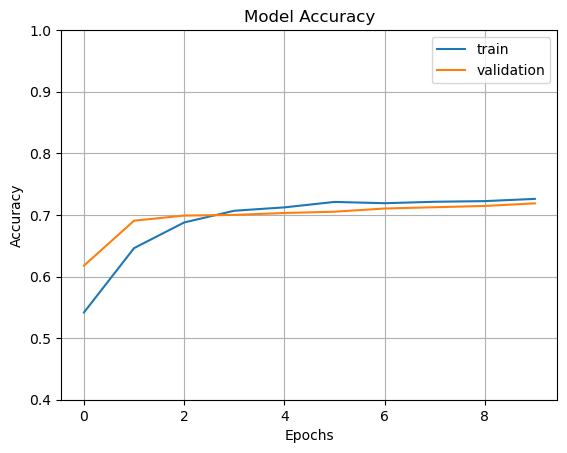

In [157]:
fig1 = plt.gcf()
plt.plot(resnet_model_1_history.history['acc'])
plt.plot(resnet_model_1_history.history['val_acc'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

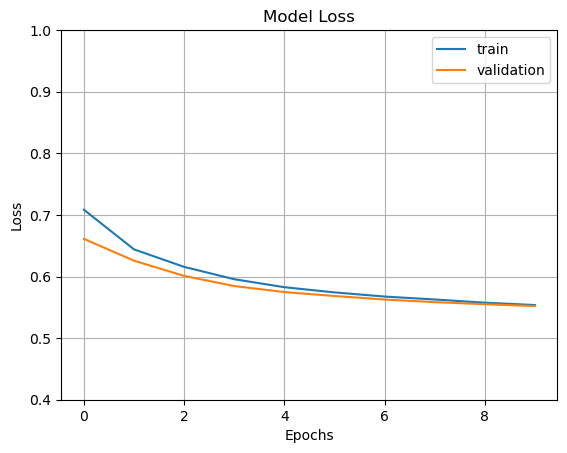

In [158]:
fig1 = plt.gcf()
plt.plot(resnet_model_1_history.history['loss'])
plt.plot(resnet_model_1_history.history['val_loss'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [159]:
loss_trainrn1, accuracy_trainrn1 = resnet_model_1.evaluate(X_train1,y_train1)
loss_valrn1, accuracy_valrn1 = resnet_model_1.evaluate(X_val,y_val)
loss_testrn1, accuracy_testrn1 = resnet_model_1.evaluate(X_test,y_test)

38/38 [==============================] - 46s 1s/step - loss: 0.5648 - acc: 0.7183


In [160]:
y_pred_rn1 = resnet_model_1.predict(X_test)

38/38 [==============================] - 47s 1s/step


In [161]:
y_test_arg_rn1 = np.argmax(y_test,axis=1)
y_pred_rn1 = np.argmax(y_pred_rn1,axis=1)
print(confusion_matrix(y_test_arg_rn1, y_pred_rn1))

[[416 184]
 [154 446]]


In [162]:
Accuracy =metrics.accuracy_score(y_test_arg_rn1,y_pred_rn1)
Precision=metrics.precision_score(y_test_arg_rn1, y_pred_rn1)
Recall   =metrics.recall_score(y_test_arg_rn1, y_pred_rn1)
F1_score =metrics.f1_score(y_test_arg_rn1, y_pred_rn1)
ROC      =metrics.roc_auc_score(y_test_arg_rn1, y_pred_rn1)

In [164]:
rn1_series = pd.Series(["RESTNET50", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(rn1_series, ignore_index = True)

In [165]:
print("RESTNET 50 - Accuracy: ",Accuracy)
print("RESTNET 50 - Precision: ",Precision)
print("RESTNET 50 - Recall: ",Recall)
print("RESTNET 50 - F1 score: ",F1_score)
print("RESTNET 50 - ROC: ",ROC)

RESTNET 50 - Accuracy:  0.7183333333333334
RESTNET 50 - Precision:  0.707936507936508
RESTNET 50 - Recall:  0.7433333333333333
RESTNET 50 - F1 score:  0.7252032520325203
RESTNET 50 - ROC:  0.7183333333333333


In [166]:
history_resneti = resnet_model_1.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=15)

Epoch 1/15
120/120 [==============================] - 241s 2s/step - loss: 0.6205 - acc: 0.6763 - val_loss: 0.5518 - val_acc: 0.7323
Epoch 2/15
120/120 [==============================] - 235s 2s/step - loss: 0.5708 - acc: 0.7273 - val_loss: 0.5348 - val_acc: 0.7406
Epoch 3/15
120/120 [==============================] - 232s 2s/step - loss: 0.5548 - acc: 0.7318 - val_loss: 0.5282 - val_acc: 0.7469
Epoch 4/15
120/120 [==============================] - 233s 2s/step - loss: 0.5492 - acc: 0.7349 - val_loss: 0.5253 - val_acc: 0.7500
Epoch 5/15
120/120 [==============================] - 232s 2s/step - loss: 0.5458 - acc: 0.7398 - val_loss: 0.5181 - val_acc: 0.7531
Epoch 6/15
120/120 [==============================] - 231s 2s/step - loss: 0.5341 - acc: 0.7451 - val_loss: 0.5192 - val_acc: 0.7500
Epoch 7/15
120/120 [==============================] - 232s 2s/step - loss: 0.5311 - acc: 0.7497 - val_loss: 0.5096 - val_acc: 0.7552
Epoch 8/15
120/120 [==============================] - 233s 2s/step - 

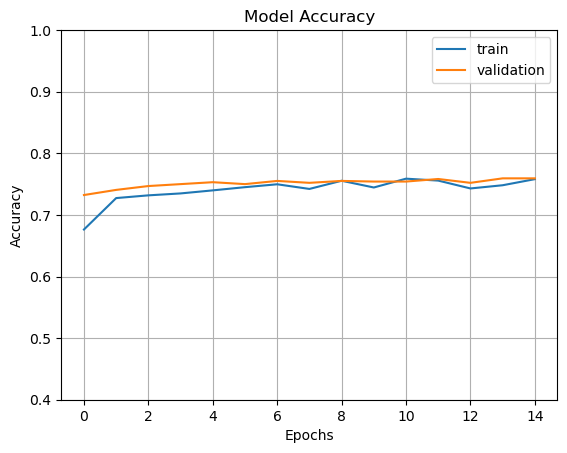

In [167]:
fig1 = plt.gcf()
plt.plot(history_resneti.history['acc'])
plt.plot(history_resneti.history['val_acc'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

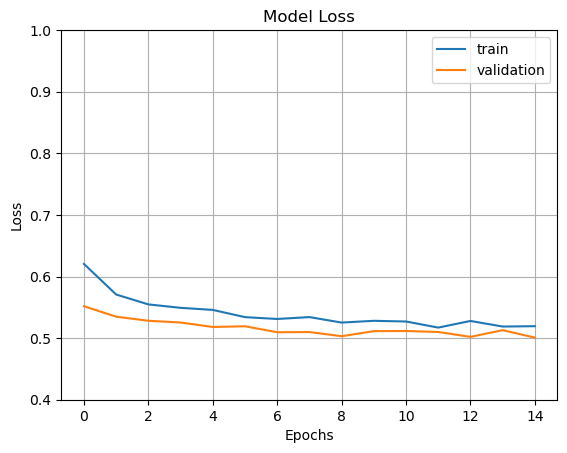

In [168]:
fig1 = plt.gcf()
plt.plot(history_resneti.history['loss'])
plt.plot(history_resneti.history['val_loss'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [171]:
loss_trainrn2, accuracy_trainrn2 = resnet_model_1.evaluate(train_generator)
loss_valrn2, accuracy_valrn2 = resnet_model_1.evaluate(valid_generator)
loss_testrn2, accuracy_testrn2 = resnet_model_1.evaluate(Test_generator)

38/38 [==============================] - 53s 1s/step - loss: 0.5320 - acc: 0.7367


In [172]:
y_pred_rn2 = resnet_model_1.predict(X_test)

38/38 [==============================] - 51s 1s/step


In [173]:
y_test_arg_rn2 = np.argmax(y_test,axis=1)
y_pred_rn2 = np.argmax(y_pred_rn2,axis=1)
print(confusion_matrix(y_test_arg_rn2, y_pred_rn2))

[[441 159]
 [183 417]]


In [174]:
Accuracy =metrics.accuracy_score(y_test_arg_rn2,y_pred_rn2)
Precision=metrics.precision_score(y_test_arg_rn2, y_pred_rn2)
Recall   =metrics.recall_score(y_test_arg_rn2, y_pred_rn2)
F1_score =metrics.f1_score(y_test_arg_rn2, y_pred_rn2)
ROC      =metrics.roc_auc_score(y_test_arg_rn2, y_pred_rn2)

In [175]:
rn2_series = pd.Series(["RESTNET50_IMAGE DATA GENERATOR", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(rn2_series, ignore_index = True)

In [176]:
print("RESTNET 50 - Accuracy: ",Accuracy)
print("RESTNET 50 - Precision: ",Precision)
print("RESTNET 50 - Recall: ",Recall)
print("RESTNET 50 - F1 score: ",F1_score)
print("RESTNET 50 - ROC: ",ROC)

RESTNET 50 - Accuracy:  0.715
RESTNET 50 - Precision:  0.7239583333333334
RESTNET 50 - Recall:  0.695
RESTNET 50 - F1 score:  0.7091836734693878
RESTNET 50 - ROC:  0.715


# Transfer Learning using InceptionV3:

In [178]:
incep_base_model = tf.keras.applications.InceptionV3(weights='imagenet', 
                                include_top=False, 
                                input_shape=(224, 224,3))
incep_base_model.trainable = False

add_model = Sequential()
add_model.add(incep_base_model)
add_model.add(GlobalAveragePooling2D())
add_model.add(Dropout(0.5))
add_model.add(Dense(2, 
                    activation='sigmoid'))

incep_model_1 = add_model
incep_model_1.compile(loss='binary_crossentropy', 
              optimizer=Adam(lr=1e-4),
              metrics=['accuracy'])
incep_model_1.summary()

87910968/87910968 [==============================] - 23s 0us/step
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 5, 5, 2048)        21802784  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout_5 (Dropout)         (None, 2048)              0         
                                                                 
 dense_17 (Dense)            (None, 2)                 4098      
                                                                 
Total params: 21,806,882
Trainable params: 4,098
Non-trainable params: 21,802,784
_________________________________________________________________


In [179]:
batch_size = 80
nb_epochs = 10
incep_hist_1 = incep_model_1.fit(X_train1, y_train1,
                                 batch_size=batch_size,
                                 epochs=nb_epochs, 
                                 validation_data=(X_val, y_val),
                                 initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
48/48 [==============================] - 95s 2s/step - loss: 6.3972 - accuracy: 0.5049 - val_loss: 1.6682 - val_accuracy: 0.5740
Epoch 2/10
48/48 [==============================] - 91s 2s/step - loss: 5.5562 - accuracy: 0.5440 - val_loss: 1.6705 - val_accuracy: 0.6125
Epoch 3/10
48/48 [==============================] - 92s 2s/step - loss: 5.2879 - accuracy: 0.5643 - val_loss: 1.7044 - val_accuracy: 0.6385


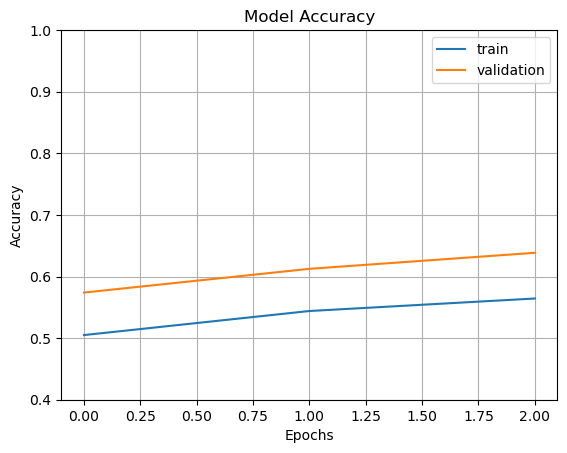

In [180]:
fig1 = plt.gcf()
plt.plot(incep_hist_1.history['accuracy'])
plt.plot(incep_hist_1.history['val_accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [182]:
loss_traininc1, accuracy_traininc1 = incep_model_1.evaluate(X_train1,y_train1)
loss_valinc1, accuracy_valinc1 = incep_model_1.evaluate(X_val,y_val)
loss_testinc1, accuracy_testinc1 = incep_model_1.evaluate(X_test,y_test)

38/38 [==============================] - 27s 702ms/step - loss: 1.7307 - accuracy: 0.6367


In [183]:
y_pred_inc1 = incep_model_1.predict(X_test)

38/38 [==============================] - 26s 664ms/step


In [185]:
y_test_arg_inc1 = np.argmax(y_test,axis=1)
y_pred_inc1 = np.argmax(y_pred_inc1,axis=1)
print(confusion_matrix(y_test_arg_inc1, y_pred_inc1))

[[414 186]
 [250 350]]


In [186]:
Accuracy =metrics.accuracy_score(y_test_arg_inc1,y_pred_inc1)
Precision=metrics.precision_score(y_test_arg_inc1, y_pred_inc1)
Recall   =metrics.recall_score(y_test_arg_inc1, y_pred_inc1)
F1_score =metrics.f1_score(y_test_arg_inc1, y_pred_inc1)
ROC      =metrics.roc_auc_score(y_test_arg_inc1, y_pred_inc1)

In [187]:
inc1_series = pd.Series(["INCEPTION V3", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(inc1_series, ignore_index = True)

In [188]:
print("INCEPTION V3 - Accuracy: ",Accuracy)
print("INCEPTION V3 - Precision: ",Precision)
print("INCEPTION V3 - Recall: ",Recall)
print("INCEPTION V3 - F1 score: ",F1_score)
print("INCEPTION V3 - ROC: ",ROC)

INCEPTION V3 - Accuracy:  0.6366666666666667
INCEPTION V3 - Precision:  0.6529850746268657
INCEPTION V3 - Recall:  0.5833333333333334
INCEPTION V3 - F1 score:  0.6161971830985915
INCEPTION V3 - ROC:  0.6366666666666667


In [189]:
history_inceptioni = incep_model_1.fit_generator(
    generator=train_generator,
    steps_per_epoch=STEP_SIZE_TRAIN,
    validation_data=valid_generator,
    validation_steps=STEP_SIZE_VALID,
    epochs=15)

Epoch 1/15
120/120 [==============================] - 144s 1s/step - loss: 8.4178 - accuracy: 0.5672 - val_loss: 2.4637 - val_accuracy: 0.6781
Epoch 2/15
120/120 [==============================] - 143s 1s/step - loss: 7.4747 - accuracy: 0.5745 - val_loss: 2.3133 - val_accuracy: 0.6865
Epoch 3/15
120/120 [==============================] - 142s 1s/step - loss: 6.7021 - accuracy: 0.5966 - val_loss: 2.2380 - val_accuracy: 0.6958
Epoch 4/15
120/120 [==============================] - 142s 1s/step - loss: 6.2577 - accuracy: 0.5969 - val_loss: 2.1274 - val_accuracy: 0.6958
Epoch 5/15
120/120 [==============================] - 142s 1s/step - loss: 5.9501 - accuracy: 0.5852 - val_loss: 1.9410 - val_accuracy: 0.7094
Epoch 6/15
120/120 [==============================] - 141s 1s/step - loss: 5.4407 - accuracy: 0.6000 - val_loss: 1.7987 - val_accuracy: 0.7104
Epoch 7/15
120/120 [==============================] - 142s 1s/step - loss: 4.9343 - accuracy: 0.5945 - val_loss: 1.7518 - val_accuracy: 0.7094

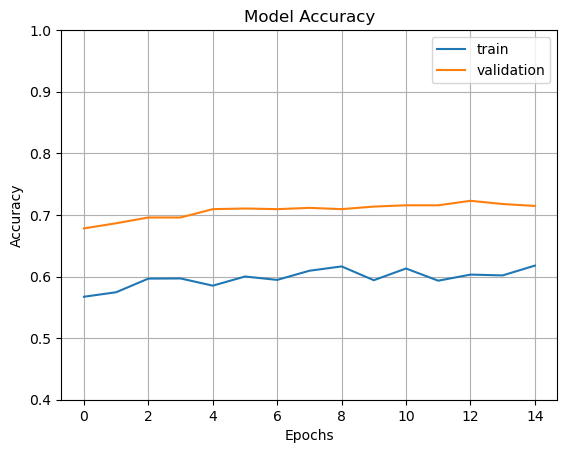

In [191]:
fig1 = plt.gcf()
plt.plot(history_inceptioni.history['accuracy'])
plt.plot(history_inceptioni.history['val_accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [193]:
loss_traininc2, accuracy_traininc2 = incep_model_1.evaluate(train_generator)
loss_valinc2, accuracy_valinc2 = incep_model_1.evaluate(valid_generator)
loss_testinc2, accuracy_testinc2 = incep_model_1.evaluate(Test_generator)

38/38 [==============================] - 28s 745ms/step - loss: 1.1289 - accuracy: 0.7083


In [194]:
y_pred_inc2 = incep_model_1.predict(X_test)

38/38 [==============================] - 25s 670ms/step


In [195]:
y_test_arg_inc2 = np.argmax(y_test,axis=1)
y_pred_inc2 = np.argmax(y_pred_inc2,axis=1)
print(confusion_matrix(y_test_arg_inc2, y_pred_inc2))

[[175 425]
 [ 72 528]]


In [196]:
Accuracy =metrics.accuracy_score(y_test_arg_inc2,y_pred_inc2)
Precision=metrics.precision_score(y_test_arg_inc2, y_pred_inc2)
Recall   =metrics.recall_score(y_test_arg_inc2, y_pred_inc2)
F1_score =metrics.f1_score(y_test_arg_inc2, y_pred_inc2)
ROC      =metrics.roc_auc_score(y_test_arg_inc2, y_pred_inc2)

In [197]:
inc2_series = pd.Series(["INCEPTION V3_IMAGE DATA GENERATOR", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(inc2_series, ignore_index = True)

In [198]:
print("INCEPTION V3 - Accuracy: ",Accuracy)
print("INCEPTION V3 - Precision: ",Precision)
print("INCEPTION V3 - Recall: ",Recall)
print("INCEPTION V3 - F1 score: ",F1_score)
print("INCEPTION V3 - ROC: ",ROC)

INCEPTION V3 - Accuracy:  0.5858333333333333
INCEPTION V3 - Precision:  0.5540398740818469
INCEPTION V3 - Recall:  0.88
INCEPTION V3 - F1 score:  0.6799742433998713
INCEPTION V3 - ROC:  0.5858333333333333


In [199]:
# Increase Trainable parameters in the model and retrain

add_model = Sequential()
add_model.add(incep_base_model)

add_model.add(GlobalAveragePooling2D())
# add_model.add(Dropout(0.3))
add_model.add(Dense(128, activation="relu"))
add_model.add(Dense(64, activation="relu"))
add_model.add(Dense(2, 
                    activation='sigmoid'))

incep_model_2 = add_model
incep_model_2.compile(loss='binary_crossentropy', 
              optimizer=RMSprop(lr=0.0001),
              metrics=['accuracy'])
incep_model_2.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 5, 5, 2048)        21802784  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_18 (Dense)            (None, 128)               262272    
                                                                 
 dense_19 (Dense)            (None, 64)                8256      
                                                                 
 dense_20 (Dense)            (None, 2)                 130       
                                                                 
Total params: 22,073,442
Trainable params: 270,658
Non-trainable params: 21,802,784
____________________________________

In [200]:
batch_size = 80
nb_epochs = 10
incep_hist_2 = incep_model_2.fit(X_train1, y_train1,
                                 batch_size=batch_size,
                                 epochs=nb_epochs, 
                                 validation_data=(X_val, y_val),
                                 initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/10
48/48 [==============================] - 95s 2s/step - loss: 1.1268 - accuracy: 0.6010 - val_loss: 0.9605 - val_accuracy: 0.6594
Epoch 2/10
48/48 [==============================] - 90s 2s/step - loss: 0.8434 - accuracy: 0.6430 - val_loss: 0.6872 - val_accuracy: 0.6719
Epoch 3/10
48/48 [==============================] - 88s 2s/step - loss: 0.7823 - accuracy: 0.6617 - val_loss: 0.7902 - val_accuracy: 0.6354
Epoch 4/10
48/48 [==============================] - 88s 2s/step - loss: 0.7374 - accuracy: 0.6682 - val_loss: 0.6929 - val_accuracy: 0.6875


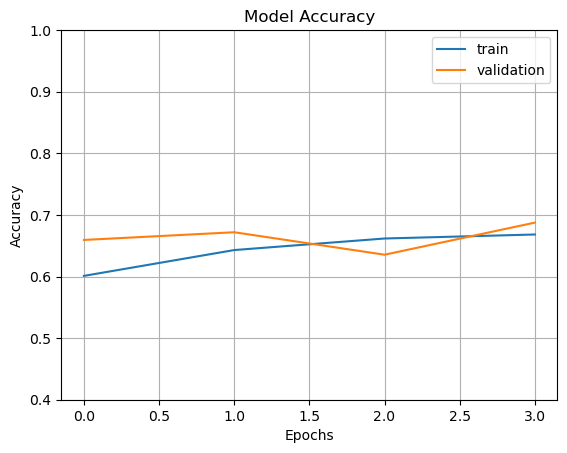

In [201]:
fig1 = plt.gcf()
plt.plot(incep_hist_2.history['accuracy'])
plt.plot(incep_hist_2.history['val_accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [202]:
loss_traininc3, accuracy_traininc3 = incep_model_2.evaluate(train_generator)
loss_valinc3, accuracy_valinc3 = incep_model_2.evaluate(valid_generator)
loss_testinc3, accuracy_testinc3 = incep_model_2.evaluate(Test_generator)

38/38 [==============================] - 27s 718ms/step - loss: 1.7093 - accuracy: 0.5675


In [203]:
y_pred_inc3 = incep_model_2.predict(X_test)

38/38 [==============================] - 27s 695ms/step


In [204]:
y_test_arg_inc3 = np.argmax(y_test,axis=1)
y_pred_inc3 = np.argmax(y_pred_inc3,axis=1)
print(confusion_matrix(y_test_arg_inc3, y_pred_inc3))

[[412 188]
 [186 414]]


In [205]:
Accuracy =metrics.accuracy_score(y_test_arg_inc3,y_pred_inc3)
Precision=metrics.precision_score(y_test_arg_inc3, y_pred_inc3)
Recall   =metrics.recall_score(y_test_arg_inc3, y_pred_inc3)
F1_score =metrics.f1_score(y_test_arg_inc3, y_pred_inc3)
ROC      =metrics.roc_auc_score(y_test_arg_inc3, y_pred_inc3)

In [206]:
inc3_series = pd.Series(["INCEPTION V3 - ADDED LAYERS", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(inc3_series, ignore_index = True)

In [207]:
print("INCEPTION V3 - Accuracy: ",Accuracy)
print("INCEPTION V3 - Precision: ",Precision)
print("INCEPTION V3 - Recall: ",Recall)
print("INCEPTION V3 - F1 score: ",F1_score)
print("INCEPTION V3 - ROC: ",ROC)

INCEPTION V3 - Accuracy:  0.6883333333333334
INCEPTION V3 - Precision:  0.6877076411960132
INCEPTION V3 - Recall:  0.69
INCEPTION V3 - F1 score:  0.6888519134775374
INCEPTION V3 - ROC:  0.6883333333333332


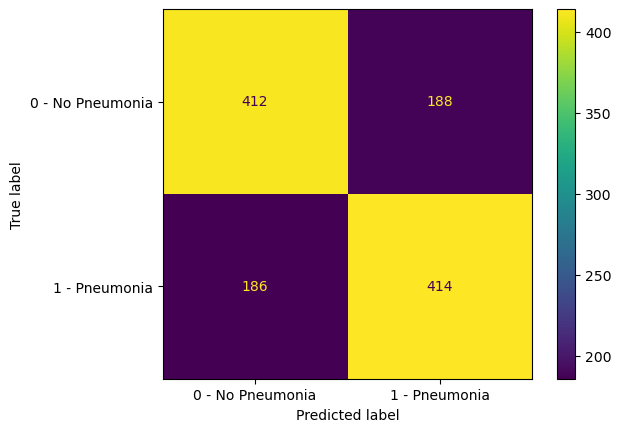

In [209]:
cm = confusion_matrix(y_test_arg_inc3, y_pred_inc3)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

# Transfer Learning using DenseNet121:

In [210]:
dense_base_model = tf.keras.applications.DenseNet121(
    include_top=False,
    weights="imagenet",
    input_shape=(224,224,3),
    pooling="avg"
    )

In [211]:
# don't train existing weights
for layer in dense_base_model.layers:
    layer.trainable = False

In [212]:
dense_base_model.summary()

Model: "densenet121"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_4[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                        

In [213]:
tf.keras.backend.clear_session()

model_dense_1 = Sequential()

model_dense_1.add(dense_base_model)
model_dense_1.add(Flatten())
model_dense_1.add(BatchNormalization())
model_dense_1.add(Dense(1024, activation='relu'))
model_dense_1.add(Dropout(0.6))
model_dense_1.add(BatchNormalization())
# model_dense_1.add(Dense(128, activation='relu'))
# model_dense_1.add(Dropout(0.5))
# model_dense_1.add(BatchNormalization())
# model_dense_1.add(Dense(64, activation='relu'))
# model_dense_1.add(Dropout(0.3))
model_dense_1.add(Dense(2, activation='sigmoid'))

model_dense_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 densenet121 (Functional)    (None, 1024)              7037504   
                                                                 
 flatten (Flatten)           (None, 1024)              0         
                                                                 
 batch_normalization (BatchN  (None, 1024)             4096      
 ormalization)                                                   
                                                                 
 dense (Dense)               (None, 1024)              1049600   
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 batch_normalization_1 (Batc  (None, 1024)             4096      
 hNormalization)                                        

In [214]:
optimizer = Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

model_dense_1.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['acc'])

In [216]:
batch_size = 60
nb_epochs = 12
model_dense_hist_1 = model_dense_1.fit(X_train1, y_train1,
                                       batch_size=batch_size,
                                       epochs=nb_epochs, 
                                       validation_data=(X_val, y_val),
                                       initial_epoch=0, callbacks=[EarlyStopping(monitor='val_loss', patience=2, min_delta=0.001)])

Epoch 1/12
64/64 [==============================] - 298s 5s/step - loss: 0.7282 - acc: 0.6596 - val_loss: 0.7735 - val_acc: 0.6104
Epoch 2/12
64/64 [==============================] - 322s 5s/step - loss: 0.6637 - acc: 0.7036 - val_loss: 0.5831 - val_acc: 0.7073
Epoch 3/12
64/64 [==============================] - 343s 5s/step - loss: 0.6419 - acc: 0.7193 - val_loss: 0.5654 - val_acc: 0.7271
Epoch 4/12
64/64 [==============================] - 384s 6s/step - loss: 0.6205 - acc: 0.7271 - val_loss: 0.5502 - val_acc: 0.7406
Epoch 5/12
64/64 [==============================] - 397s 6s/step - loss: 0.6024 - acc: 0.7318 - val_loss: 0.5477 - val_acc: 0.7406
Epoch 6/12
64/64 [==============================] - 311s 5s/step - loss: 0.5921 - acc: 0.7471 - val_loss: 0.5524 - val_acc: 0.7240
Epoch 7/12
64/64 [==============================] - 309s 5s/step - loss: 0.5812 - acc: 0.7346 - val_loss: 0.5460 - val_acc: 0.7281
Epoch 8/12
64/64 [==============================] - 311s 5s/step - loss: 0.5608 - a

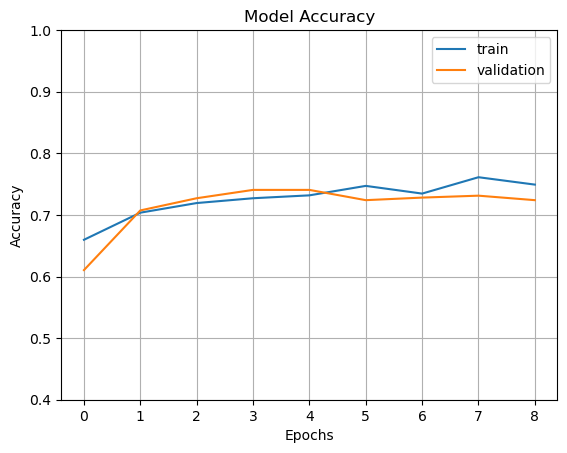

In [217]:
fig1 = plt.gcf()
plt.plot(model_dense_hist_1.history['acc'])
plt.plot(model_dense_hist_1.history['val_acc'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

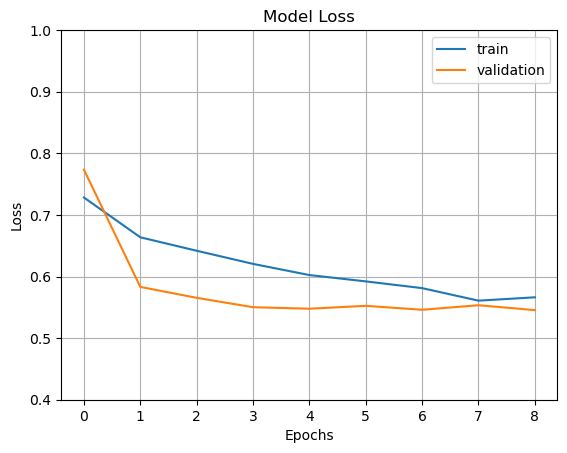

In [218]:
fig1 = plt.gcf()
plt.plot(model_dense_hist_1.history['loss'])
plt.plot(model_dense_hist_1.history['val_loss'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'validation'])
plt.show()

In [219]:
loss_traindn1, accuracy_traindn1 = model_dense_1.evaluate(X_train1,y_train1)
loss_valdn1, accuracy_valdn1 = model_dense_1.evaluate(X_val,y_val)
loss_testdn1, accuracy_testdn1 = model_dense_1.evaluate(X_test,y_test)

38/38 [==============================] - 86s 2s/step - loss: 0.5565 - acc: 0.7308


In [220]:
y_pred_dn1 = model_dense_1.predict(X_test)

38/38 [==============================] - 81s 2s/step


In [221]:
y_test_arg_dn1 = np.argmax(y_test,axis=1)
y_pred_dn1 = np.argmax(y_pred_dn1,axis=1)
print(confusion_matrix(y_test_arg_dn1, y_pred_dn1))

[[434 166]
 [157 443]]


In [222]:
Accuracy =metrics.accuracy_score(y_test_arg_dn1,y_pred_dn1)
Precision=metrics.precision_score(y_test_arg_dn1, y_pred_dn1)
Recall   =metrics.recall_score(y_test_arg_dn1, y_pred_dn1)
F1_score =metrics.f1_score(y_test_arg_dn1, y_pred_dn1)
ROC      =metrics.roc_auc_score(y_test_arg_dn1, y_pred_dn1)

In [223]:
dn1_series = pd.Series(["DENSENET121", Accuracy, Precision, Recall, F1_score, ROC])

Pre_trained_results = Pre_trained_results.append(dn1_series, ignore_index = True)

In [224]:
print("DENSENET121 - Accuracy: ",Accuracy)
print("DENSENET121 - Precision: ",Precision)
print("DENSENET121 - Recall: ",Recall)
print("DENSENET121 - F1 score: ",F1_score)
print("DENSENET121 - ROC: ",ROC)

DENSENET121 - Accuracy:  0.7308333333333333
DENSENET121 - Precision:  0.7274220032840722
DENSENET121 - Recall:  0.7383333333333333
DENSENET121 - F1 score:  0.7328370554177005
DENSENET121 - ROC:  0.7308333333333333


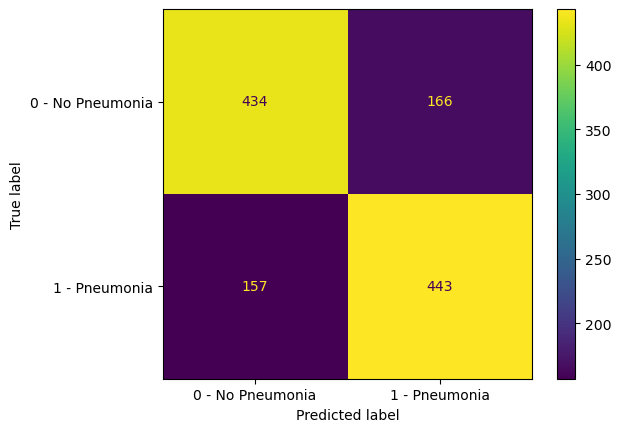

In [225]:
cm = confusion_matrix(y_test_arg_dn1, y_pred_dn1)

labels = ["0 - No Pneumonia", "1 - Pneumonia"]

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)

disp.plot()

plt.show()

# Transfer Learning - Using DenseNet121 with ChexNet Weights

In [159]:
weights_path = "brucechou1983_CheXNet_Keras_0.3.0_weights.h5"

In [160]:
def build_model():
    base_model = tf.keras.applications.DenseNet121(weights=None,
                                                   include_top=False,
                                                   input_shape=(224,224,3), pooling="avg")
    # freezing initial layers of base model
    #for layer in base_model.layers:
       # layer.trainable = False

    base_model.load_weights(weights_path,by_name= True)

    x = tf.keras.layers.Dense(units = 256, activation = 'relu')(base_model.output)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.activations.relu(x)
    x = tf.keras.layers.Dropout(rate = 0.1)(x)
    x = tf.keras.layers.Dense(units = 128)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.activations.relu(x)
    predictions = tf.keras.layers.Dense(2, activation='softmax', name='predictions')(x)
    model = tf.keras.Model(inputs= base_model.input, outputs=predictions)

    learning_rate = 4.8637e-5
    #adamw = tfa.optimizers.AdamW(weight_decay= wd,learning_rate=learning_rate)
    optimizer = tf.keras.optimizers.Adam(learning_rate)
    model.compile(optimizer=optimizer,
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
    metrics=[tf.keras.metrics.AUC(),
    tf.keras.metrics.Precision(),
    tf.keras.metrics.Recall()])
    return model

In [161]:
new_dense_model = build_model()

In [162]:
new_dense_model.metrics

[]

In [163]:
new_dense_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                              

In [113]:
checkpoint = ModelCheckpoint(filepath= 'Densenet_tuned.h5', save_best_only=True, save_weights_only=False)
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.99, patience=2, verbose=2, mode='min')
early_stop = EarlyStopping(monitor='val_loss', min_delta=0, patience=2, mode='min')

In [114]:
optimizer = Adam(learning_rate=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
tf.debugging.set_log_device_placement(True)
try:
    with tf.device('/device:XLA_GPU:0'):
        tf.keras.backend.clear_session()
        new_dense_model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['acc'])
except RuntimeError as e:
    print(e)

In [81]:
tf.keras.backend.clear_session()
batch_size = 60
nb_epochs = 10
new_dense_hist_1 = new_dense_model.fit(X_train1, y_train1,
                                       batch_size=batch_size,
                                       epochs=nb_epochs, 
                                       validation_data=(X_val, y_val),
                                       initial_epoch=0, callbacks=([checkpoint, lr_reduce, early_stop]))

Epoch 1/12
64/64 [==============================] - 224s 3s/step - loss: 0.6741 - acc: 0.6227 - val_loss: 1.2947 - val_acc: 0.5000 - lr: 1.0000e-04
Epoch 2/12
64/64 [==============================] - 250s 4s/step - loss: 0.6351 - acc: 0.6602 - val_loss: 0.9560 - val_acc: 0.4885 - lr: 1.0000e-04
Epoch 3/12
64/64 [==============================] - 235s 4s/step - loss: 0.6230 - acc: 0.6721 - val_loss: 0.7419 - val_acc: 0.5417 - lr: 1.0000e-04
Epoch 4/12
64/64 [==============================] - 228s 4s/step - loss: 0.6200 - acc: 0.6779 - val_loss: 0.7245 - val_acc: 0.5646 - lr: 1.0000e-04
Epoch 5/12
64/64 [==============================] - 238s 4s/step - loss: 0.6095 - acc: 0.6875 - val_loss: 0.7969 - val_acc: 0.5333 - lr: 1.0000e-04
Epoch 6/12
64/64 [==============================] - ETA: 0s - loss: 0.6072 - acc: 0.6854
Epoch 6: ReduceLROnPlateau reducing learning rate to 9.899999749904965e-05.
64/64 [==============================] - 239s 4s/step - loss: 0.6072 - acc: 0.6854 - val_loss: 

In [ ]:
pkl.dump(new_dense_model, open('new_dense_model_2.pkl', 'wb'))

In [ ]:
# Pickling the densenet121 model with ChexNet weights:
# On every run, model metrics are being changed.
# We have already pickled the model, where we got the best accuracy so to avoid re-run of the model.
# Due to resource constraints, we have also executed the DenseNet121 model with ChexNet weights in colab pro using 12GB of GPU
# In Colab Pro, DenseNet121 has given us the best accuracy of more than 80% which was pickled and used in This project

load_options = tf.saved_model.LoadOptions(experimental_io_device='/job:localhost')

new_dense_model_2 = pickle.load(open('new_dense_model_2.pkl', 'rb'))
#new_dense_model_1.predict(X_test1)

In [186]:
Pre_trained_results.columns = ["Model_Name", "Accuracy", "Precision", "Recall", "F1 Score", "ROC"]

In [187]:
Pre_trained_results.style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

Model_Name,Accuracy,Precision,Recall,F1 Score,ROC
VGG 16,0.712500,0.704655,0.731667,0.717907,0.712500
VGG 16 Using IDG,0.663333,0.741379,0.501667,0.598410,0.663333
RESTNET50,0.718333,0.707937,0.743333,0.725203,0.718333
RESTNET50_IMAGE DATA GENERATOR,0.715000,0.723958,0.695000,0.709184,0.715000
INCEPTION V3,0.636667,0.652985,0.583333,0.616197,0.636667
INCEPTION V3_IMAGE DATA GENERATOR,0.585833,0.554040,0.880000,0.679974,0.585833
INCEPTION V3 - ADDED LAYERS,0.688333,0.687708,0.690000,0.688852,0.688333
DENSENET121,0.730833,0.727422,0.738333,0.732837,0.730833


# Step 3: Design, train and test RCNN & its hybrids based object detection models to impose the bounding box or mask over the area of interest.

# Object Detection:

# Designing a MobileNet Architecture

In [9]:
train_label_pneumonia = train_label[train_label["Target"] == 1]

train_label_pneumonia = train_label_pneumonia.reset_index(drop = True)

In [10]:
train_label_pneumonia["Full_filename"] = "stage_2_train_images"+"/"+train_label_pneumonia["patientId"]+".dcm"

train_label_pneumonia["Filename"] = train_label_pneumonia["patientId"]+".dcm"

#train_label_pneumonia = train_label_pneumonia.drop(columns = ["patientId"])

In [11]:
train_4500_rows = train_label_pneumonia[:4500]

In [12]:
train_4500_rows.sample(2)

,patientId,x,y,width,height,Target,Full_filename,Filename
223,081a1f56-6c47-4b80-988a-3d357c977d65,559.0,393.0,289.0,502.0,1,stage_2_train_images/081a1f56-6c47-4b80-988a-3d357c977d65.dcm,081a1f56-6c47-4b80-988a-3d357c977d65.dcm
544,11750ff6-94ea-43d0-bad8-f3c3e5278d7d,570.0,395.0,271.0,499.0,1,stage_2_train_images/11750ff6-94ea-43d0-bad8-f3c3e5278d7d.dcm,11750ff6-94ea-43d0-bad8-f3c3e5278d7d.dcm


In [13]:
train_y_4500_box = train_4500_rows.drop(columns = ["Full_filename","Filename","Target","patientId"])

In [14]:
train_y_4500_box.columns

Index(['x', 'y', 'width', 'height'], dtype='object')

In [15]:
y_4500 = train_y_4500_box.copy()

In [119]:
img_rows=224
img_cols=224
dim = (img_rows, img_cols)

X_opac = []
brk = 0
i = 1 # initialisation
for img in tqdm(train_4500_rows["Full_filename"].values): 
    
    ds_3 = dicom.dcmread(img)
    img_3 = ds_3.pixel_array
    rgb = apply_color_lut(img_3, palette='PET')
    train_img = rgb
    try:
        train_img_resize = cv2.resize(train_img, dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk +=1
        print("breaking out for",img)
        break
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_opac.append(train_img_resize)
    i += 1

100%|██████████████████████████████████████████████████████████████████████████████| 4500/4500 [01:50<00:00, 40.68it/s]


In [14]:
X_opac = np.asarray(X_opac)

In [124]:
fileName = "X_4500.pkl"
fileObject = open(fileName, 'wb')

pkl.dump(X_opac, fileObject)
fileObject.close()

In [125]:
y_4500.to_csv("y_4500.csv", index = False)

In [16]:
train_X_4500_3 = open("X_4500.pkl", "rb")
X_3_45k = pkl.load(train_X_4500_3)
X_3_45k[0:2]

[array([[[ 0,  4,  3],
         [ 0,  6,  5],
         [ 0,  5,  4],
         ...,
         [ 0,  5,  4],
         [ 0,  5,  4],
         [ 0,  5,  4]],
 
        [[ 0,  5,  4],
         [ 0,  6,  5],
         [ 0,  6,  5],
         ...,
         [ 0,  6,  5],
         [ 0,  6,  5],
         [ 0,  6,  5]],
 
        [[ 0,  5,  4],
         [ 0,  6,  5],
         [ 0,  6,  5],
         ...,
         [ 0,  6,  5],
         [ 0,  6,  5],
         [ 0,  6,  5]],
 
        ...,
 
        [[ 0,  5,  4],
         [ 0,  8,  7],
         [ 0, 10,  9],
         ...,
         [ 0, 12, 11],
         [ 0, 12, 11],
         [ 0, 12, 11]],
 
        [[ 0,  9,  8],
         [ 0,  9,  9],
         [ 0, 10,  9],
         ...,
         [ 0, 12, 11],
         [ 0, 12, 11],
         [ 0, 12, 11]],
 
        [[ 0,  7,  6],
         [ 0,  8,  7],
         [ 0, 11, 10],
         ...,
         [ 0, 11, 10],
         [ 0, 13, 12],
         [ 0, 13, 12]]], dtype=uint8),
 array([[[ 0,  4,  3],
         [ 0,  6,  

In [17]:
X_3_45k = np.array(X_3_45k)

In [18]:
X_3_45k.shape

(4500, 224, 224, 3)

In [19]:
y_train = train_y_4500_box.to_numpy()

In [20]:
y_train.shape

(4500, 4)

In [21]:
train_4500_rows.iloc[234,:]

patientId                                 084d42b9-0a43-490d-9a8d-e4d7545c44f5
x                                                                        513.0
y                                                                        472.0
width                                                                    320.0
height                                                                   342.0
Target                                                                       1
Full_filename    stage_2_train_images/084d42b9-0a43-490d-9a8d-e4d7545c44f5.dcm
Filename                              084d42b9-0a43-490d-9a8d-e4d7545c44f5.dcm
Name: 234, dtype: object

In [22]:
X_train_bb = X_3_45k.copy()

In [23]:
y_train_bb = y_train.copy()

In [24]:
print(X_train_bb.shape)
print(y_train_bb.shape)

(4500, 224, 224, 3)
(4500, 4)


In [25]:
rand_image = 234

# Pick a random image to check how it looks

orig_size = 1024
new_size = 224

filename = X_train_bb[rand_image]
# img_rgb = Image.fromarray(filename, "RGB")

fig, ax = plt.subplots(1,figsize=(6,6))

# fig, a = plt.subplots(1,1)
# fig.set_size_inches(5,5)

dim = (new_size, new_size)
img_resize = cv2.resize(filename, dim, interpolation=cv2.INTER_CUBIC)

# a.imshow(img_resize, cmap=plt.cm.bone)
  
# unscaled = cv2.imread(rgb)
region = y_train_bb[rand_image]
image_height, image_width, _ = filename.shape

print("region",region)

print(image_height)
print(image_width)

x0 = ((region[0] * new_size ) / orig_size)
y0 = ((region[1] * new_size ) / orig_size)
x1 = ((region[2] * new_size ) / orig_size)
y1 = ((region[3] * new_size ) / orig_size)

# x0 = int(region[0] * image_width / IMAGE_SIZE) # Scale the BBox
# y0 = int(region[1] * image_height / IMAGE_SIZE)

# x1 = int((region[0] + region[2]) * image_width / IMAGE_SIZE)
# y1 = int((region[1] + region[3]) * image_height / IMAGE_SIZE)

# Create a Rectangle patch
rect = patches.Rectangle((x0, y0), x1, y1, linewidth=2, edgecolor='r', facecolor='none')
# rect.append(patches.Rectangle((X, Y), width, height,linewidth = 3,edgecolor = 'r',facecolor = 'none'))

print(rect)

# Add the patch to the Axes
ax.imshow(img_resize, cmap=plt.cm.bone)
ax.add_patch(rect)

# ax.set_xlim(-3,3)
# ax.set_ylim(-3,3)

plt.show()
plt.figure().clear()

region [513. 472. 320. 342.]
224
224
Rectangle(xy=(112.219, 103.25), width=70, height=74.8125, angle=0)


In [26]:
print("X_train_bb",X_train_bb.shape)
print("y_train_bb",y_train_bb.shape)

X_train_bb (4500, 224, 224, 3)
y_train_bb (4500, 4)


In [27]:
X_train, X_test, y_train, y_test = train_test_split(X_train_bb, y_train_bb, test_size=.20, random_state=10)  # 80% Training and 20% Testing

In [28]:
print("X_train shape",X_train.shape)
print("y train shape",y_train.shape)
print("x_test shape",X_test.shape)
print("y_test shape",y_test.shape)

X_train shape (3600, 224, 224, 3)
y train shape (3600, 4)
x_test shape (900, 224, 224, 3)
y_test shape (900, 4)


In [29]:
X_train1, X_val, y_train1, y_val = train_test_split(X_train, y_train, test_size=.20, random_state=20)  # 80% Training and 20% Testing

In [30]:
print("X_train1 shape",X_train1.shape)
print("y train1 shape",y_train1.shape)
print("X_val shape",X_val.shape)
print("y_val shape",y_val.shape)

X_train1 shape (2880, 224, 224, 3)
y train1 shape (2880, 4)
X_val shape (720, 224, 224, 3)
y_val shape (720, 4)


In [31]:
ALPHA = 1.0 # Width hyper parameter for MobileNet (0.25, 0.5, 0.75, 1.0). Higher width means more accurate but slower

from tensorflow.keras.layers import Conv2D, Reshape

def create_model_2(trainable=True):
    model = MobileNet(input_shape=(128, 128, 3), include_top=False, alpha=ALPHA) # Load pre-trained mobilenet
    # Do not include classification (top) layer

    # to freeze layers, except the new top layer, of course, which will be added below
    for layer in model.layers:
        layer.trainable = trainable

    # Add new top layer which is a conv layer of the same size as the previous layer so that only 4 coords of BBox can be output
    x0 = model.layers[-1].output
    # x1 = Conv2D(4, kernel_size=4, kernel_initializer='normal', kernel_regularizer=tf.keras.regularizers.l2(0.01), activity_regularizer=tf.keras.regularizers.l1(0.001), activation="relu", name="coords")(x0)
    x1 = Conv2D(4, kernel_size=4, kernel_initializer='normal', kernel_regularizer=tf.keras.regularizers.l2(0.0015), activity_regularizer=tf.keras.regularizers.l1(0.0025), activation="relu", name="coords")(x0)
    # x1 = Conv2D(4, kernel_size=4, name="coords")(x0)
    # x1 = Conv2D(4, kernel_size=4, kernel_initializer='he_normal', activation="relu", name="coords1")(x1)
    # x1 = Conv2D(4, kernel_size=4, kernel_initializer='he_normal', activation="relu", name="coords2")(x1)
    # In the line above kernel size should be 3 for img size 96, 4 for img size 128, 5 for img size 160 etc.
    x2 = Reshape((4,))(x1) # These are the 4 predicted coordinates of one BBox

    return Model(inputs=model.input, outputs=x2)

In [32]:
def IOU_1(y_true, y_pred):
    intersections = 0
    unions = 0
    # set the types so we are sure what type we are using

    gt = y_true
    pred = y_pred
    # Compute interection of predicted (pred) and ground truth (gt) bounding boxes
    diff_width = np.minimum(gt[:,0] + gt[:,2], pred[:,0] + pred[:,2]) - np.maximum(gt[:,0], pred[:,0])
    diff_height = np.minimum(gt[:,1] + gt[:,3], pred[:,1] + pred[:,3]) - np.maximum(gt[:,1], pred[:,1])
    intersection = diff_width * diff_height

    # Compute union
    area_gt = gt[:,2] * gt[:,3]
    area_pred = pred[:,2] * pred[:,3]
    union = area_gt + area_pred - intersection

    # Compute intersection and union over multiple boxes
    for j, _ in enumerate(union):
        if union[j] > 0 and intersection[j] > 0 and union[j] >= intersection[j]:
            intersections += intersection[j]
            unions += union[j]

    # Compute IOU. Use epsilon to prevent division by zero
    iou = np.round(intersections / (unions + tf.keras.backend.epsilon()), 4)
    # This must match the type used in py_func
    iou = iou.astype(np.float32)
    return iou

In [33]:
def IoU_2(y_true, y_pred):
    iou = tf.py_function(IOU_1, [y_true, y_pred], Tout=tf.float32)
    return iou

In [52]:
base_model1 = create_model_2(False)

In [53]:
base_model1.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 64, 64, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 64, 64, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 64, 64, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 64, 64, 32)       288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 64, 64, 32)       128       
 ation)                                                      

In [54]:
X_train1.shape[0]

2880

In [35]:
X_train2 = np.resize(X_train1,(X_train1.shape[0],128,128,3))

In [36]:
X_train1.shape, X_train2.shape

((2880, 224, 224, 3), (2880, 128, 128, 3))

In [37]:
X_val.shape

(720, 224, 224, 3)

In [38]:
X_val2 = np.resize(X_val,(X_val.shape[0],128,128,3))

In [39]:
X_val.shape,X_val2.shape

((720, 224, 224, 3), (720, 128, 128, 3))

In [40]:
X_test2 = np.resize(X_test,(X_test.shape[0],128,128,3))

In [41]:
X_test.shape, X_test2.shape

((900, 224, 224, 3), (900, 128, 128, 3))

In [42]:
print(X_train2.shape)
print(X_val2.shape)
print(X_test2.shape)

(2880, 128, 128, 3)
(720, 128, 128, 3)
(900, 128, 128, 3)


In [43]:
y_train1[0:5]

array([[310., 607., 239., 259.],
       [568., 481., 194., 173.],
       [273., 209., 194., 393.],
       [217., 526., 176., 125.],
       [558., 280., 243., 482.]])

In [44]:
y_train2 = (y_train1 * 128) / 1024

In [45]:
y_train2[0:5]

array([[38.75 , 75.875, 29.875, 32.375],
       [71.   , 60.125, 24.25 , 21.625],
       [34.125, 26.125, 24.25 , 49.125],
       [27.125, 65.75 , 22.   , 15.625],
       [69.75 , 35.   , 30.375, 60.25 ]])

In [46]:
y_val2 = (y_val * 128 )/ 1024

In [47]:
y_val2[0:5]

array([[19.25 , 34.875, 41.75 , 50.375],
       [42.125, 58.125, 23.5  , 23.5  ],
       [78.25 , 24.625, 43.   , 83.   ],
       [75.375, 35.25 , 27.375, 31.625],
       [91.25 , 70.   , 13.   , 28.875]])

In [48]:
y_test2 = (y_test * 128 )/ 1024

In [55]:
# Compile the model
opt = optimizer=Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
base_model1.compile(loss="mean_squared_error", optimizer=opt, metrics=[IoU_2]) # Regression loss is MSE

In [56]:
# Use earlystopping
callback2 = tf.keras.callbacks.EarlyStopping(monitor='val_IoU_2', patience=3, min_delta=0.01)

# Fit the model
base_model1.fit(X_train2, y_train2, validation_data=(X_val2, y_val2), epochs=30, batch_size=20, callbacks=[callback2])

Epoch 1/30
144/144 [==============================] - 20s 127ms/step - loss: 1828.7288 - IoU_2: 0.3005 - val_loss: 1778.9187 - val_IoU_2: 0.2710
Epoch 2/30
144/144 [==============================] - 18s 127ms/step - loss: 1507.3427 - IoU_2: 0.2646 - val_loss: 1301.6140 - val_IoU_2: 0.2105
Epoch 3/30
144/144 [==============================] - 18s 125ms/step - loss: 1015.9293 - IoU_2: 0.1621 - val_loss: 890.5369 - val_IoU_2: 0.1570
Epoch 4/30
144/144 [==============================] - 18s 127ms/step - loss: 729.0668 - IoU_2: 0.1625 - val_loss: 679.5276 - val_IoU_2: 0.1547
Epoch 5/30
144/144 [==============================] - 18s 128ms/step - loss: 575.9411 - IoU_2: 0.1702 - val_loss: 559.8184 - val_IoU_2: 0.1565
Epoch 6/30
144/144 [==============================] - 19s 131ms/step - loss: 491.3201 - IoU_2: 0.1630 - val_loss: 492.2207 - val_IoU_2: 0.1503


In [57]:
base_model1.evaluate(X_test2, y_test2)

29/29 [==============================] - 5s 164ms/step - loss: 461.3999 - IoU_2: 0.1692


[461.3999328613281, 0.16920344531536102]

In [173]:
pkl.dump(base_model1, open('mobilenet_objdet', 'wb'))

INFO:tensorflow:Assets written to: ram://665fd77b-c745-41cd-8d15-93c098395e0a/assets


INFO:tensorflow:Assets written to: ram://665fd77b-c745-41cd-8d15-93c098395e0a/assets


In [52]:
X_train4 = X_train2/255.0

X_val4 = X_val2/255.0

X_test4 = X_test2/255.0

In [178]:
tf.keras.backend.clear_session()

# Use earlystopping
callback2 = tf.keras.callbacks.EarlyStopping(monitor='val_IoU_2', patience=3, min_delta=0.01)

# Fit the model
base_model1.fit(X_train4, y_train2, validation_data=(X_val4, y_val2), epochs=30, batch_size=20, callbacks=[callback2])

Epoch 1/30
144/144 [==============================] - 20s 130ms/step - loss: 431.2441 - IoU_2: 0.1555 - val_loss: 431.0265 - val_IoU_2: 0.1440
Epoch 2/30
144/144 [==============================] - 16s 112ms/step - loss: 399.6055 - IoU_2: 0.1331 - val_loss: 412.4891 - val_IoU_2: 0.1263
Epoch 3/30
144/144 [==============================] - 16s 112ms/step - loss: 390.5389 - IoU_2: 0.1243 - val_loss: 405.8780 - val_IoU_2: 0.1212
Epoch 4/30
144/144 [==============================] - 16s 110ms/step - loss: 387.4046 - IoU_2: 0.1203 - val_loss: 402.8160 - val_IoU_2: 0.1211
Epoch 5/30
144/144 [==============================] - 16s 110ms/step - loss: 385.9109 - IoU_2: 0.1181 - val_loss: 401.5852 - val_IoU_2: 0.1194


In [174]:
train_4500_rows.sample(10).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height,Target,Full_filename,Filename
2785,56b5c0cf-8a3c-42f2-b3e2-adb2f550c451,81.000000,587.000000,210.000000,222.000000,1,stage_2_train_images/56b5c0cf-8a3c-42f2-b3e2-adb2f550c451.dcm,56b5c0cf-8a3c-42f2-b3e2-adb2f550c451.dcm
2546,4b85f617-4e30-404c-b9c1-5e9b8776dfba,678.000000,290.000000,249.000000,506.000000,1,stage_2_train_images/4b85f617-4e30-404c-b9c1-5e9b8776dfba.dcm,4b85f617-4e30-404c-b9c1-5e9b8776dfba.dcm
3112,64917123-823f-4c01-a0d6-06bdfd899a6c,242.000000,260.000000,240.000000,507.000000,1,stage_2_train_images/64917123-823f-4c01-a0d6-06bdfd899a6c.dcm,64917123-823f-4c01-a0d6-06bdfd899a6c.dcm
908,2635357b-8865-4551-9ed8-3f90b996c982,225.000000,489.000000,164.000000,115.000000,1,stage_2_train_images/2635357b-8865-4551-9ed8-3f90b996c982.dcm,2635357b-8865-4551-9ed8-3f90b996c982.dcm
2412,463c04a5-94b8-4969-a725-a58c2b6211c1,599.000000,309.000000,282.000000,546.000000,1,stage_2_train_images/463c04a5-94b8-4969-a725-a58c2b6211c1.dcm,463c04a5-94b8-4969-a725-a58c2b6211c1.dcm
4466,8d48694a-f998-4043-bc98-63a3c18527f2,481.000000,232.000000,329.000000,642.000000,1,stage_2_train_images/8d48694a-f998-4043-bc98-63a3c18527f2.dcm,8d48694a-f998-4043-bc98-63a3c18527f2.dcm
1883,3b94276b-4b65-4339-a629-0500f0171c45,621.000000,572.000000,242.000000,194.000000,1,stage_2_train_images/3b94276b-4b65-4339-a629-0500f0171c45.dcm,3b94276b-4b65-4339-a629-0500f0171c45.dcm
4114,84d73e68-ceb9-4bff-94d9-9b97523109ee,115.000000,509.000000,370.000000,286.000000,1,stage_2_train_images/84d73e68-ceb9-4bff-94d9-9b97523109ee.dcm,84d73e68-ceb9-4bff-94d9-9b97523109ee.dcm
4378,8b252ccb-1a24-47cf-bd2d-b42c6c9a2557,235.000000,236.000000,227.000000,627.000000,1,stage_2_train_images/8b252ccb-1a24-47cf-bd2d-b42c6c9a2557.dcm,8b252ccb-1a24-47cf-bd2d-b42c6c9a2557.dcm
2934,5c0bb75f-a4d1-4070-b40d-6fff71138147,225.000000,634.000000,128.000000,96.000000,1,stage_2_train_images/5c0bb75f-a4d1-4070-b40d-6fff71138147.dcm,5c0bb75f-a4d1-4070-b40d-6fff71138147.dcm


In [175]:
samp_data = train_4500_rows["patientId"].sample(10)

In [176]:
sample_data2 = ['00436515-870c-4b36-a041-de91049b9ab4',
                '00704310-78a8-4b38-8475-49f4573b2dbb',
                '00aecb01-a116-45a2-956c-08d2fa55433f',
                '00c0b293-48e7-4e16-ac76-9269ba535a62',
                '00f08de1-517e-4652-a04f-d1dc9ee48593']

In [177]:
print(sample_data2)

['00436515-870c-4b36-a041-de91049b9ab4', '00704310-78a8-4b38-8475-49f4573b2dbb', '00aecb01-a116-45a2-956c-08d2fa55433f', '00c0b293-48e7-4e16-ac76-9269ba535a62', '00f08de1-517e-4652-a04f-d1dc9ee48593']


In [178]:
train_coords = train_4500_rows[["patientId", "x", "y", "width", "height"]]

In [179]:
train_coords.sample(10).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height
1904,3bd6f6e0-c07a-4c22-87e7-53d60de9ad0e,142.000000,265.000000,228.000000,503.000000
3244,6a82ef54-9e27-4c55-afba-47298ad088c9,236.000000,512.000000,113.000000,90.000000
2912,5b72c6d2-e7eb-44a6-b625-78d2ec0008f2,170.000000,414.000000,177.000000,455.000000
932,29b9a5ae-56e4-4e15-a78d-cbaeda0c276a,722.000000,567.000000,139.000000,238.000000
1351,34e283d8-3c14-4d47-8882-fb53ec242f87,227.000000,207.000000,250.000000,570.000000
3022,5fe137e2-d416-4f49-b685-6a3fe5367910,160.000000,408.000000,184.000000,412.000000
2645,4fa69712-d57b-4ea9-bdf3-40cdc03f02ff,309.000000,230.000000,233.000000,441.000000
4038,826a4142-b079-4825-85f7-5fd69292e4cf,453.000000,231.000000,284.000000,590.000000
2420,4668a90c-d352-47d0-a3ac-a54aa8ce053b,162.000000,611.000000,230.000000,235.000000
522,0f831256-0a69-4fe5-9719-1563d2b6b7b9,166.000000,535.000000,134.000000,279.000000


In [180]:
train_coords[train_coords["patientId"].isin(sample_data2)].style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,x,y,width,height
0,00436515-870c-4b36-a041-de91049b9ab4,264.000000,152.000000,213.000000,379.000000
1,00436515-870c-4b36-a041-de91049b9ab4,562.000000,152.000000,256.000000,453.000000
2,00704310-78a8-4b38-8475-49f4573b2dbb,323.000000,577.000000,160.000000,104.000000
3,00704310-78a8-4b38-8475-49f4573b2dbb,695.000000,575.000000,162.000000,137.000000
4,00aecb01-a116-45a2-956c-08d2fa55433f,288.000000,322.000000,94.000000,135.000000
5,00aecb01-a116-45a2-956c-08d2fa55433f,547.000000,299.000000,119.000000,165.000000
6,00c0b293-48e7-4e16-ac76-9269ba535a62,306.000000,544.000000,168.000000,244.000000
7,00c0b293-48e7-4e16-ac76-9269ba535a62,650.000000,511.000000,206.000000,284.000000
8,00f08de1-517e-4652-a04f-d1dc9ee48593,181.000000,184.000000,206.000000,506.000000
9,00f08de1-517e-4652-a04f-d1dc9ee48593,571.000000,275.000000,230.000000,476.000000


In [181]:
train_coords.dtypes

patientId     object
x            float64
y            float64
width        float64
height       float64
dtype: object

In [182]:
def gt_pb(pass_model,data):
    passed_sample = data
    for loop_1 in passed_sample:
        pat_id_1 = loop_1

        no_ind = train_coords[train_coords['patientId'] == pat_id_1].index.values
        l_ind = len(no_ind)

        fname = pat_id_1+".dcm"
        image_path = "stage_2_train_images/"+fname

        ds = dicom.dcmread(image_path)
        img = ds.pixel_array

        print("patientid",pat_id_1)

        fig, a = plt.subplots(1,1)
        fig.set_size_inches(5,5)

        X = 0
        Y = 0
        width = 0
        height = 0
        rect = []
        rect1 = []
        k = 0

        for j in range(l_ind):
            X = train_coords.iloc[no_ind[j],1]
            Y = train_coords.iloc[no_ind[j],2]
            width = train_coords.iloc[no_ind[j],3]
            height = train_coords.iloc[no_ind[j],4]
            rect.append(patches.Rectangle((X, Y), width, height,linewidth = 3,edgecolor = 'r',facecolor = 'none'))
            a.imshow(img, cmap=plt.cm.bone)
            a.add_patch(rect[j])
        
        for k in range(l_ind):
            img_for_prediction =img[tf.newaxis,...]
            img_pred_128 = np.resize(img,(img_for_prediction.shape[0],128,128,3))
            img_pred_region = pass_model.predict(img_pred_128) # Predict the BBox
            x0 = (img_pred_region[0,0])
            y0 = (img_pred_region[0,1])
            x1 = (img_pred_region[0,2])
            y1 = (img_pred_region[0,3]) 
            rect1.append(patches.Rectangle((x0*8, y0*8), x1*8, y1*8, linewidth=3, edgecolor='y', facecolor='none'))  
            a.add_patch(rect1[k])
        plt.show()
        plt.figure().clear()

patientid 00436515-870c-4b36-a041-de91049b9ab4
1/1 [==============================] - 0s 64ms/step


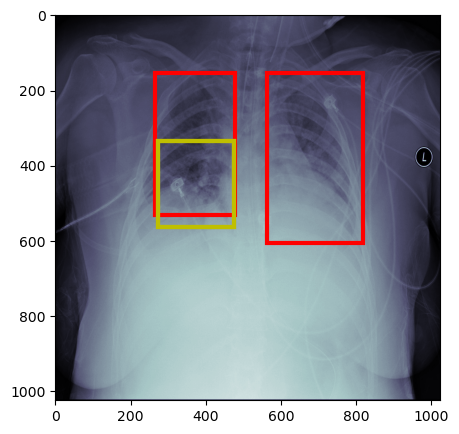

patientid 00704310-78a8-4b38-8475-49f4573b2dbb
1/1 [==============================] - 0s 65ms/step


<Figure size 640x480 with 0 Axes>

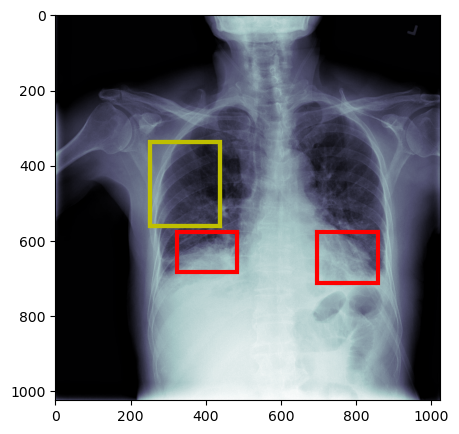

patientid 00aecb01-a116-45a2-956c-08d2fa55433f
1/1 [==============================] - 0s 64ms/step


<Figure size 640x480 with 0 Axes>

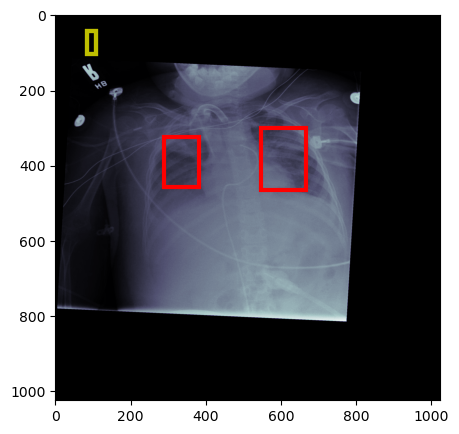

patientid 00c0b293-48e7-4e16-ac76-9269ba535a62
1/1 [==============================] - 0s 63ms/step


<Figure size 640x480 with 0 Axes>

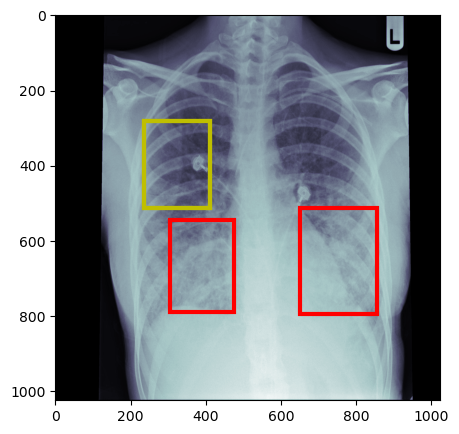

patientid 00f08de1-517e-4652-a04f-d1dc9ee48593
1/1 [==============================] - 0s 62ms/step


<Figure size 640x480 with 0 Axes>

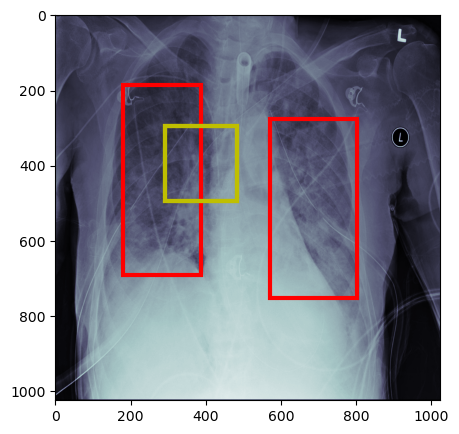

<Figure size 640x480 with 0 Axes>

In [183]:
gt_pb(base_model1, sample_data2)

In [184]:
samp_data_arr = np.array(samp_data)

In [185]:
samp_data_arr

array(['47cb6d42-b61b-4cdc-b865-b26f2196f979',
       '729f2aa0-9564-4228-b516-1d8d4be8bb55',
       '78c9b88e-a134-4470-b161-22e4a698206c',
       '2b70a757-4dff-4d97-baf5-f41b8d3ab4da',
       '88b5a0c7-4f3b-4a3a-9882-617c1b87c187',
       '05fe7d73-5c8c-4349-88c4-2071a00d6d81',
       '15cfe136-58ea-4e38-b3a8-d372ecad4ac7',
       '3162d754-7972-47b0-ae60-1ae6e2bb4150',
       '7bb1c647-d8d1-4640-b495-f41c4d2a34ca',
       '81d9d146-e9bb-478b-aeed-c2431780030e'], dtype=object)

patientid 47cb6d42-b61b-4cdc-b865-b26f2196f979
1/1 [==============================] - 0s 67ms/step


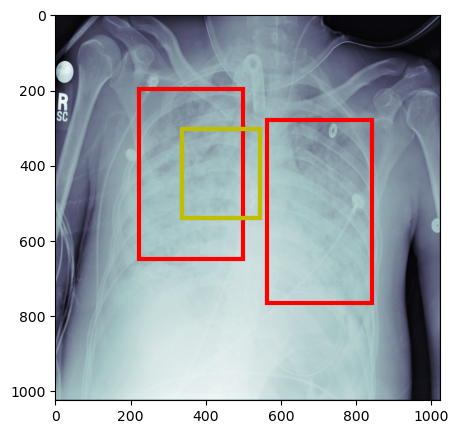

patientid 729f2aa0-9564-4228-b516-1d8d4be8bb55
1/1 [==============================] - 0s 67ms/step


<Figure size 640x480 with 0 Axes>

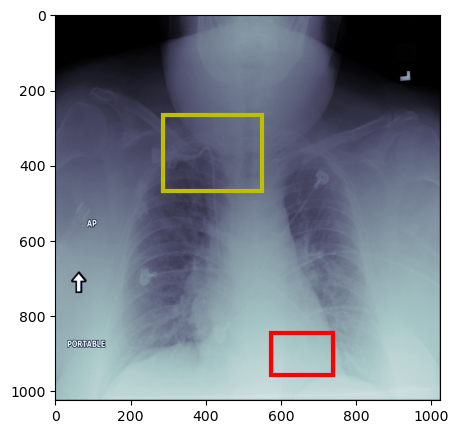

patientid 78c9b88e-a134-4470-b161-22e4a698206c
1/1 [==============================] - 0s 61ms/step


<Figure size 640x480 with 0 Axes>

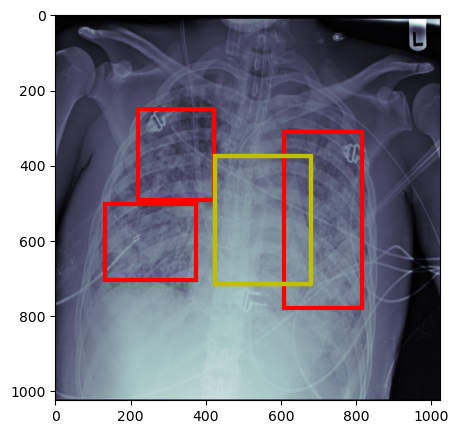

patientid 2b70a757-4dff-4d97-baf5-f41b8d3ab4da
1/1 [==============================] - 0s 65ms/step


<Figure size 640x480 with 0 Axes>

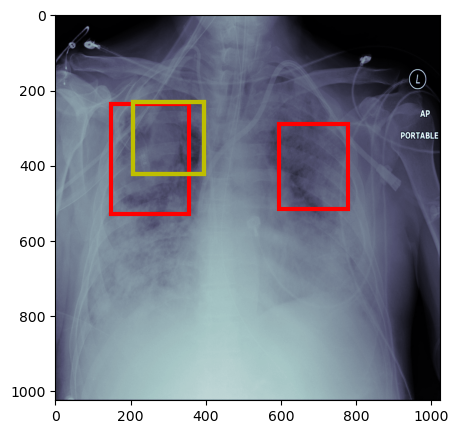

patientid 88b5a0c7-4f3b-4a3a-9882-617c1b87c187
1/1 [==============================] - 0s 68ms/step


<Figure size 640x480 with 0 Axes>

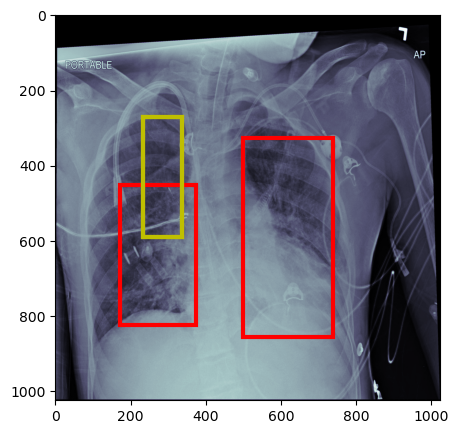

patientid 05fe7d73-5c8c-4349-88c4-2071a00d6d81
1/1 [==============================] - 0s 76ms/step


<Figure size 640x480 with 0 Axes>

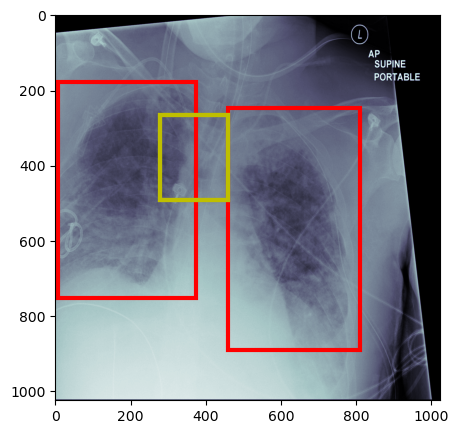

patientid 15cfe136-58ea-4e38-b3a8-d372ecad4ac7
1/1 [==============================] - 0s 73ms/step


<Figure size 640x480 with 0 Axes>

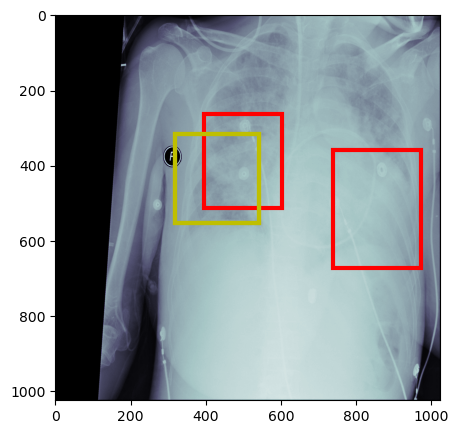

patientid 3162d754-7972-47b0-ae60-1ae6e2bb4150
1/1 [==============================] - 0s 69ms/step


<Figure size 640x480 with 0 Axes>

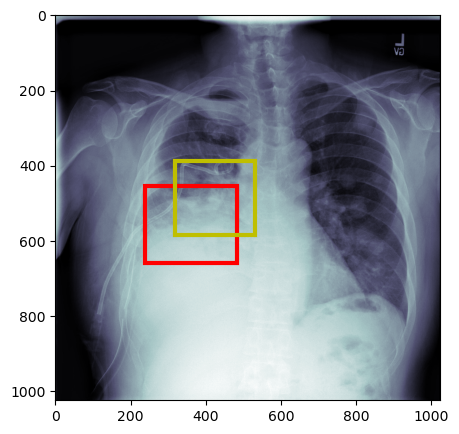

patientid 7bb1c647-d8d1-4640-b495-f41c4d2a34ca
1/1 [==============================] - 0s 87ms/step


<Figure size 640x480 with 0 Axes>

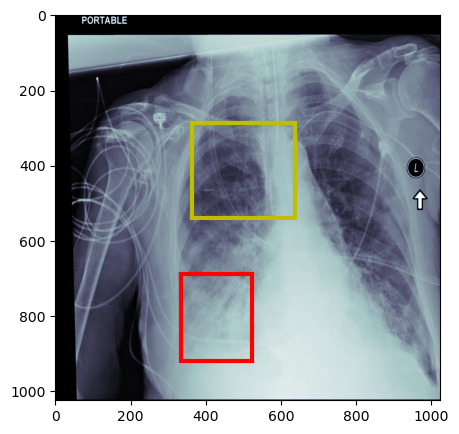

patientid 81d9d146-e9bb-478b-aeed-c2431780030e
1/1 [==============================] - 0s 81ms/step


<Figure size 640x480 with 0 Axes>

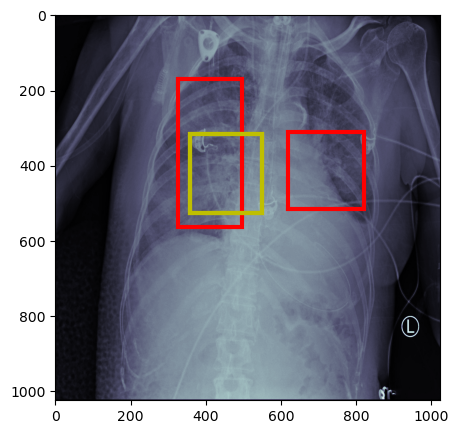

<Figure size 640x480 with 0 Axes>

In [186]:
gt_pb(base_model1, samp_data_arr)

In [187]:
# path of pretrained models weights
weights_path = "brucechou1983_CheXNet_Keras_0.3.0_weights.h5"

In [210]:
# from tensorflow.keras.applications.densenet.DenseNet import Densenet121
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Reshape

def create_model_new(trainable=True):
    model = tf.keras.applications.DenseNet121(weights=None,include_top=False,input_shape=(128,128,3))
    model.load_weights(weights_path,by_name= True)

    # to freeze layers, except the new top layer, of course, which will be added below
    for layer in model.layers:
        layer.trainable = trainable

    # Add new top layer which is a conv layer of the same size as the previous layer so that only 4 coords of BBox can be output
    x0 = model.layers[-1].output
    x1 = Conv2D(4, kernel_size=4, kernel_initializer='normal', kernel_regularizer=tf.keras.regularizers.l2(0.0015), 
                     activity_regularizer=tf.keras.regularizers.l1(0.0025), activation="relu", name="coords")(x0)
    x2 = Reshape((4,))(x1) # These are the 4 predicted coordinates of one BBox

    return Model(inputs=model.input, outputs=x2)

In [211]:
base_model2 = create_model_new(False)

In [212]:
# Compile the model

opt = Adam(learning_rate=0.00001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)
          
base_model2.compile(loss="mean_squared_error", optimizer=opt, metrics=[IoU_2]) # Regression loss is MSE

In [213]:
# Use earlystopping
callback2 = tf.keras.callbacks.EarlyStopping(monitor='val_IoU_2', patience=5, min_delta=0.01)

# Fit the model
base_model2.fit(X_train2, y_train2, validation_data=(X_val2, y_val2), epochs=40, batch_size=20, callbacks=[callback2])

Epoch 1/40
144/144 [==============================] - 500s 3s/step - loss: 2006.0892 - IoU_2: 0.1283 - val_loss: 845.5762 - val_IoU_2: 0.1521
Epoch 2/40
144/144 [==============================] - 476s 3s/step - loss: 757.3915 - IoU_2: 0.1580 - val_loss: 740.6445 - val_IoU_2: 0.1551
Epoch 3/40
144/144 [==============================] - 467s 3s/step - loss: 699.4479 - IoU_2: 0.1572 - val_loss: 704.5209 - val_IoU_2: 0.1522
Epoch 4/40
144/144 [==============================] - 462s 3s/step - loss: 667.6571 - IoU_2: 0.1515 - val_loss: 682.9375 - val_IoU_2: 0.1499
Epoch 5/40
144/144 [==============================] - 466s 3s/step - loss: 645.8419 - IoU_2: 0.1494 - val_loss: 666.6833 - val_IoU_2: 0.1383
Epoch 6/40
144/144 [==============================] - 392s 3s/step - loss: 630.7343 - IoU_2: 0.1424 - val_loss: 647.8849 - val_IoU_2: 0.1496
Epoch 7/40
144/144 [==============================] - 284s 2s/step - loss: 618.7048 - IoU_2: 0.1416 - val_loss: 648.3870 - val_IoU_2: 0.1419
Epoch 8/40
1

In [214]:
base_model2.evaluate(X_test2, y_test2)

29/29 [==============================] - 58s 2s/step - loss: 598.5198 - IoU_2: 0.1362


[598.519775390625, 0.1362275779247284]

In [215]:
y_pred = base_model2.predict(X_test2)

29/29 [==============================] - 57s 2s/step


In [216]:
pkl.dump(base_model2, open('densenet_objdet', 'wb'))

INFO:tensorflow:Assets written to: ram://2703cdd6-e8d6-4f40-b48b-6cfbe5a12d57/assets


INFO:tensorflow:Assets written to: ram://2703cdd6-e8d6-4f40-b48b-6cfbe5a12d57/assets


In [217]:
print(y_test2[1], y_pred[1],'\n')
print(y_test2[11], y_pred[11],'\n')
print(y_test2[111], y_pred[111],'\n')
print(y_test2[21], y_pred[21],'\n')

[75.75  39.    25.125 60.   ] [45.190815  48.243572   7.9350333 55.637497 ] 

[69.625 27.125 12.375 18.75 ] [54.278156 52.235233  0.       41.434162] 

[34.5   55.    33.875 60.125] [46.794376 39.954098  0.       50.356937] 

[68.25  24.625 32.25  54.875] [16.15029  52.620552 32.511173 29.475729] 



patientid 00436515-870c-4b36-a041-de91049b9ab4
1/1 [==============================] - 1s 843ms/step


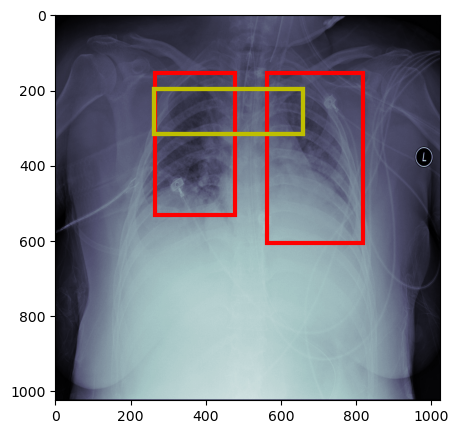

patientid 00704310-78a8-4b38-8475-49f4573b2dbb
1/1 [==============================] - 1s 764ms/step


<Figure size 640x480 with 0 Axes>

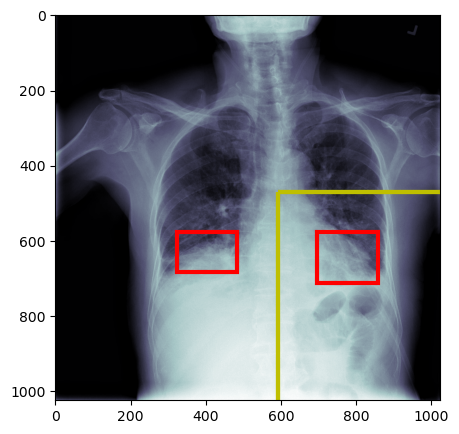

patientid 00aecb01-a116-45a2-956c-08d2fa55433f
1/1 [==============================] - 1s 857ms/step


<Figure size 640x480 with 0 Axes>

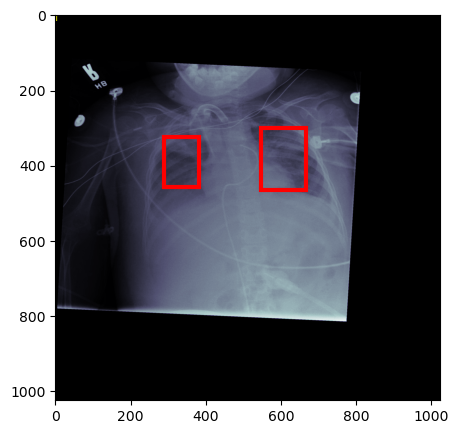

patientid 00c0b293-48e7-4e16-ac76-9269ba535a62
1/1 [==============================] - 1s 953ms/step


<Figure size 640x480 with 0 Axes>

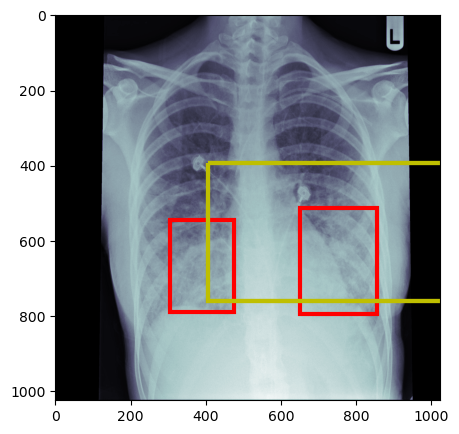

patientid 00f08de1-517e-4652-a04f-d1dc9ee48593
1/1 [==============================] - 1s 766ms/step


<Figure size 640x480 with 0 Axes>

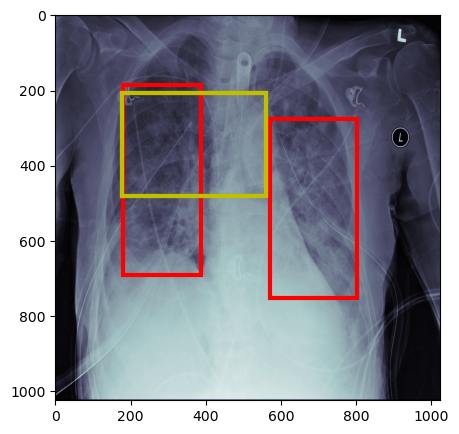

<Figure size 640x480 with 0 Axes>

In [218]:
gt_pb(base_model2, sample_data2)

patientid 47cb6d42-b61b-4cdc-b865-b26f2196f979
1/1 [==============================] - 1s 740ms/step


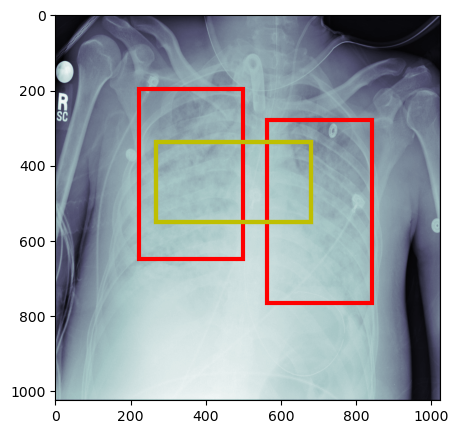

patientid 729f2aa0-9564-4228-b516-1d8d4be8bb55
1/1 [==============================] - 1s 963ms/step


<Figure size 640x480 with 0 Axes>

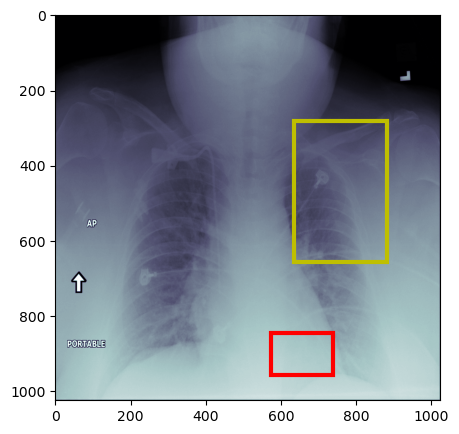

patientid 78c9b88e-a134-4470-b161-22e4a698206c
1/1 [==============================] - 1s 788ms/step


<Figure size 640x480 with 0 Axes>

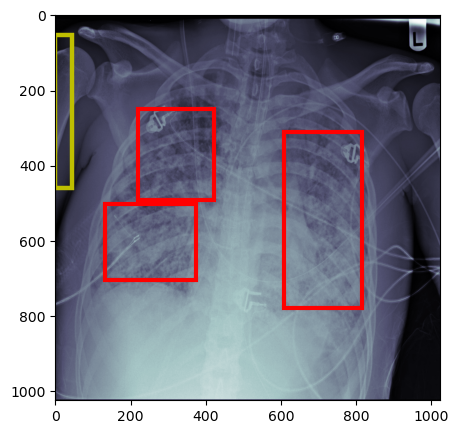

patientid 2b70a757-4dff-4d97-baf5-f41b8d3ab4da
1/1 [==============================] - 1s 824ms/step


<Figure size 640x480 with 0 Axes>

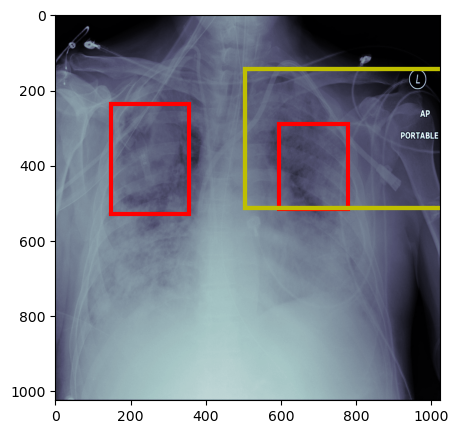

patientid 88b5a0c7-4f3b-4a3a-9882-617c1b87c187
1/1 [==============================] - 1s 878ms/step


<Figure size 640x480 with 0 Axes>

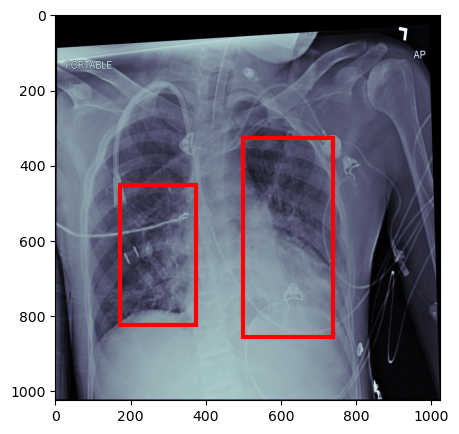

patientid 05fe7d73-5c8c-4349-88c4-2071a00d6d81
1/1 [==============================] - 1s 809ms/step


<Figure size 640x480 with 0 Axes>

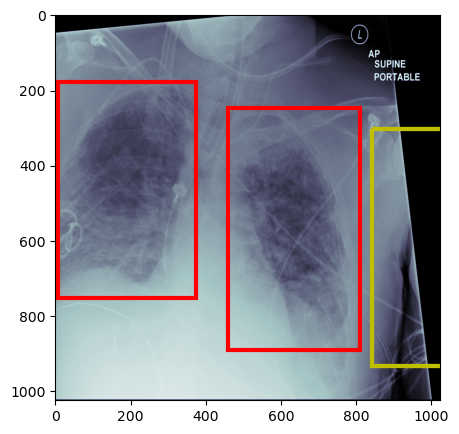

patientid 15cfe136-58ea-4e38-b3a8-d372ecad4ac7
1/1 [==============================] - 1s 816ms/step


<Figure size 640x480 with 0 Axes>

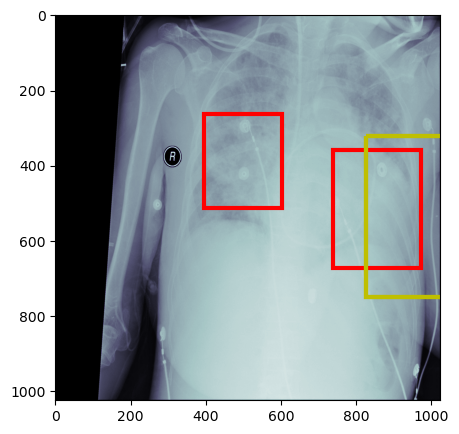

patientid 3162d754-7972-47b0-ae60-1ae6e2bb4150
1/1 [==============================] - 1s 770ms/step


<Figure size 640x480 with 0 Axes>

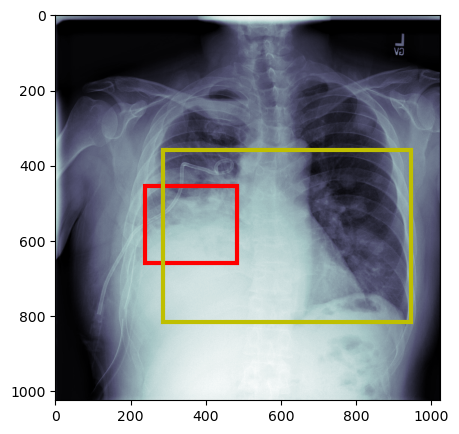

patientid 7bb1c647-d8d1-4640-b495-f41c4d2a34ca
1/1 [==============================] - 1s 1s/step


<Figure size 640x480 with 0 Axes>

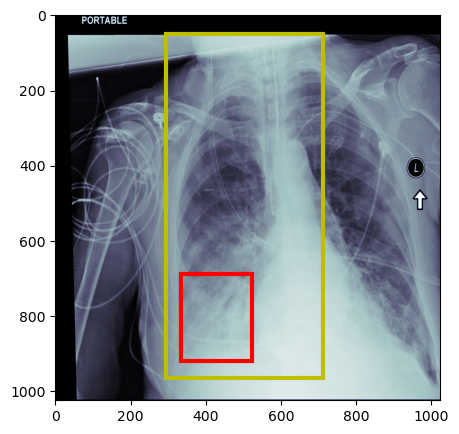

patientid 81d9d146-e9bb-478b-aeed-c2431780030e
1/1 [==============================] - 1s 835ms/step


<Figure size 640x480 with 0 Axes>

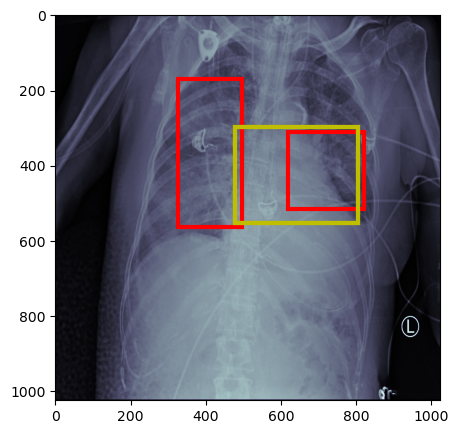

<Figure size 640x480 with 0 Axes>

In [219]:
gt_pb(base_model2, samp_data_arr)

# Faster RCNN

In [74]:
!pip install pycocotools

In [75]:
!git clone --depth 1 https://github.com/tensorflow/models

fatal: destination path 'models' already exists and is not an empty directory.


In [81]:
%%cmd
cd models/research/
protoc object_detection/protos/*.proto --python_out=.

Microsoft Windows [Version 10.0.22621.819]
(c) Microsoft Corporation. All rights reserved.

C:\Users\thril>cd models/research/

C:\Users\thril\models\research>protoc object_detection/protos/*.proto --python_out=.

C:\Users\thril\models\research>

In [82]:
!cd models

In [83]:
os.chdir("models/research")

In [9]:
%%cmd
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Microsoft Windows [Version 10.0.22621.819]
(c) Microsoft Corporation. All rights reserved.

C:\Users\thril\models\research>cd models/research/

C:\Users\thril\models\research>protoc object_detection/protos/*.proto --python_out=.

C:\Users\thril\models\research>cp object_detection/packages/tf2/setup.py .

C:\Users\thril\models\research>python -m pip install .
Processing c:\users\thril\models\research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached avro_python3-1.10.2-py3-none-any.whl
  Using cached apache_beam-2.43.0-cp39-cp39-win_amd64.whl (4.5 MB)
  Using cached lvis-0.5.3-py3-none-any.whl (14 kB)
  Using cached tf_models_official-2.11.0-py2.py3-none-any.whl (2.3 MB)
  Using cached sacrebleu-2.2.0-py3-none-any.whl (116 kB)
  Using cached immutabledict-2.2.3-py3-none-any.whl (4.0 kB)
  Using cached seqeval-1.2.2-py3-none-any.whl
  Using cached tensorflow-2.11.0-cp39-cp39-win_amd64.whl (1.9 kB)
  Using cached tf_models

The system cannot find the path specified.
ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Users\\thril\\anaconda3\\Lib\\site-packages\\google\\protobuf\\internal\\_api_implementation.cp39-win_amd64.pyd'
Consider using the `--user` option or check the permissions.



In [15]:
#pwd
#Run !cd.. 2 times after importing the models from the above code.
#This will point the project to the earlier project execution directory
#Otherwise we cannot execute the commands as the working directory is changed earlier
!cd..

In [10]:
# patch tf1 into `utils.ops`
utils_ops.tensorflow = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

In [7]:
import tarfile

with tarfile.open('faster_rcnn_nas_coco_2018_01_28.tar.gz') as tgf:
    tgf.extractall()
    tgf.close()

In [11]:
def load_model(model_name):

    model_dir = pathlib.Path(model_name)/"saved_model"
    model = tf.saved_model.load(str(model_dir))
    model = model.signatures['serving_default']
    
    return model

In [12]:
model_name = 'faster_rcnn_nas_coco_2018_01_28'
detection_model = load_model(model_name)

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [84]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = "labels.pbtxt"
print(PATH_TO_LABELS)
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

labels.pbtxt


In [14]:
detection_model.inputs

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]

In [15]:
detection_model.output_shapes

{'detection_scores': TensorShape([None, 100]),
 'num_detections': TensorShape([None]),
 'detection_classes': TensorShape([None, 100]),
 'detection_boxes': TensorShape([None, 100, 4])}

In [85]:
def run_inference_for_single_image(model, image):
    image = np.asarray(image)
    rgb = np.stack([image]*3,axis=2) # to convert into RGB
    input_tensor = tf.convert_to_tensor(rgb)
    input_tensor_new = input_tensor[tf.newaxis,...]

    # Run inference
    output_dict = detection_model(input_tensor_new)
    num_detections = int(output_dict.pop('num_detections'))
    output_dict = {key:value[0, :num_detections].numpy()
                   for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections

    # detection_classes should be ints.
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

    print("output_dict[detection_classes]",output_dict['detection_classes'])

    # Handle models with masks:
    if 'detection_masks' in output_dict:
        print("inside if statement")
        # Reframe the the bbox mask to the image size.
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(output_dict['detection_masks'], 
                                                                              output_dict['detection_boxes'],image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5, tf.uint8)
        output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

    return output_dict

In [98]:
def show_inference(model, image_path):

    # the array based representation of the image will be used later in order to prepare the result image with boxes and labels on it.
    image_np = np.array(Image.open(image_path))

    # Actual detection.
    output_dict = run_inference_for_single_image(model, image_np)

    image_np1 = np.stack([image_np]*3,axis=2) # to convert into RGB

    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np1,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index, 
        # instance_masks=output_dict.get('detection_masks_reframed', None),
        use_normalized_coordinates=True,
        line_thickness=8)

    fig, a = plt.subplots(1,1)
    fig.set_size_inches(3,3)

    imS = cv2.resize(image_np1, (224, 224))                # Resize image
    plt.imshow(imS)
    fig.tight_layout()
    plt.show()
    plt.figure().clear()
    plt.close()

In [74]:
PATH_TO_TEST_IMAGES_DIR = pathlib.Path("Testing_Images")
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[Path('Testing_Images/00d7c36e-3cdf-4df6-ac03-6c30cdc8e85b.jpg'),
 Path('Testing_Images/0100515c-5204-4f31-98e0-f35e4b00004a.jpg'),
 Path('Testing_Images/016fd98f-09a8-4b99-a8df-c3c26992f22e.jpg'),
 Path('Testing_Images/02743848-e50a-4faf-a3f4-a6215613a23d.jpg'),
 Path('Testing_Images/02cfa7d1-61e0-4d9e-8664-9a7469ccab76.jpg'),
 Path('Testing_Images/02de2d68-b7f9-428b-ac12-0cb8f56a0145.jpg'),
 Path('Testing_Images/02ea6b76-4189-47c5-a8bf-70590f84ebd8.jpg'),
 Path('Testing_Images/03d92597-3e33-4fdf-8db5-a27cf5b8d3eb.jpg'),
 Path('Testing_Images/03edb5ed-9e76-4abe-bc35-7bc95fea7e6a.jpg'),
 Path('Testing_Images/04558d1a-1f4d-47aa-bf07-a6f6595f9cec.jpg'),
 Path('Testing_Images/04a6aa6d-bd6d-48b1-822b-21b81c4bdf3a.jpg'),
 Path('Testing_Images/04dd9347-6215-4b34-a98f-a73e577aff9d.jpg'),
 Path('Testing_Images/04e9f692-f3d6-496b-ae0c-905137cc1f84.jpg'),
 Path('Testing_Images/04f9bcc7-8886-4e1a-a938-122d3a065e12.jpg'),
 Path('Testing_Images/050068ca-78f7-4394-b8de-6ebe347192e9.jpg'),
 Path('Tes

Testing_Images\00d7c36e-3cdf-4df6-ac03-6c30cdc8e85b.jpg
output_dict[detection_classes] [ 1  1  1 65  1]


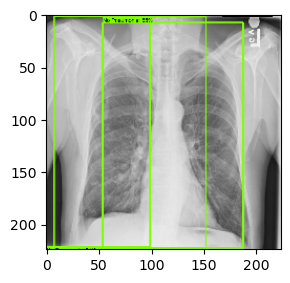

Testing_Images\0100515c-5204-4f31-98e0-f35e4b00004a.jpg
output_dict[detection_classes] [1]


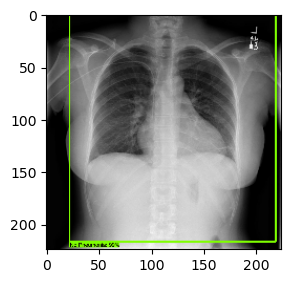

Testing_Images\016fd98f-09a8-4b99-a8df-c3c26992f22e.jpg
output_dict[detection_classes] [ 1 65  1 28]


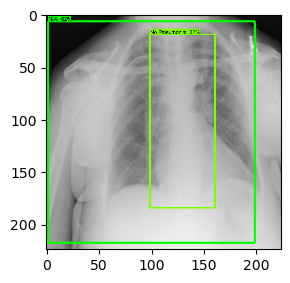

Testing_Images\02743848-e50a-4faf-a3f4-a6215613a23d.jpg
output_dict[detection_classes] [ 1 28]


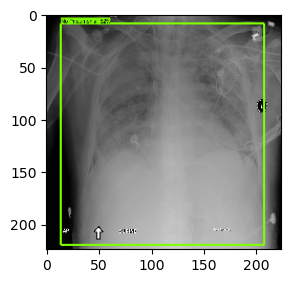

In [99]:
for image_path in TEST_IMAGE_PATHS[:4]:
    print(image_path)
    show_inference(detection_model, image_path)

# Step 4: Pickle the model for future prediction

In [ ]:
# Pickling the best classification model
# Densenet121 with ChexNet Weights gave the best classification accuracy of all models at >80%
pkl.dump(new_dense_model, open('new_dense_model_2.pkl', 'wb'))

In [ ]:
# Pickling the best object detection model
# MobileNet and DenseNet gave around same IoU, but MobileNet is much faster in execution and prediction
pkl.dump(base_model1, open('mobilenet_objdet', 'wb'))

    ******************** Pickling of models done ********************

# Importing the test images

In [58]:
test_submission = pd.read_csv("stage_2_sample_submission.csv")
test_submission.sample(5).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

,patientId,PredictionString
1222,1bb7ca9c-c1ea-4054-93ee-44009e6cc119,0.5 0 0 100 100
289,04176263-de7f-471b-9dc1-7a5af4e6d943,0.5 0 0 100 100
1860,243847a8-928b-4fb9-a7e5-20ec95e0445e,0.5 0 0 100 100
1388,1e3497cb-00c5-4333-9d35-a27fc9a49829,0.5 0 0 100 100
2865,c00a132f-6108-46e7-a67a-77efd3d2d0ef,0.5 0 0 100 100


In [59]:
#Loading the Test Dicom images

items_test = get_dicom_files('stage_2_test_images/')

items_test
items_test[2]
len(items_test)

sample_test1 = 1
xray_sample_1 = items_test[sample_test1].dcmread()
xray_sample_1

dicom_test = pd.DataFrame.from_dicoms(items_test)

dicom_test
dicom_test.dtypes

SpecificCharacterSet            object
SOPClassUID                     object
SOPInstanceUID                  object
StudyDate                       object
StudyTime                       object
AccessionNumber                 object
Modality                        object
ConversionType                  object
ReferringPhysicianName          object
SeriesDescription               object
PatientName                     object
PatientID                       object
PatientBirthDate                object
PatientSex                      object
PatientAge                      object
BodyPartExamined                object
ViewPosition                    object
StudyInstanceUID                object
SeriesInstanceUID               object
StudyID                         object
SeriesNumber                     int64
InstanceNumber                   int64
PatientOrientation              object
SamplesPerPixel                  int64
PhotometricInterpretation       object
Rows                     

In [60]:
dicom_test.to_csv("dicom_test.csv", index = False)

In [61]:
def test_submission_csv(pass_model,data):
    passed_sample = data
    test_submission_pred = pd.DataFrame()
    for loop_1 in passed_sample:
        pat_id_1 = loop_1
        fname = pat_id_1+".dcm"
        image_path = "stage_2_test_images/"+fname
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array
        img_for_prediction =img[tf.newaxis,...]
        #img_pred_128 = np.resize(img,(img_for_prediction.shape[0],128,128,3))
        img_pred_region = pass_model.predict(img_for_prediction) # Predict the BBox
        x0 = (img_pred_region[0,0])
        y0 = (img_pred_region[0,1])
        x1 = (img_pred_region[0,2])
        y1 = (img_pred_region[0,3])
        test_submission_pred = test_submission_pred.append([pat_id_1,x0,y0,x1,y1],ignore_index = True)
    test_submission.columns = ["patient_id","X","Y","Width","Height"]
    
    return test_submission.columns

In [62]:
dicom_test.columns

Index(['SpecificCharacterSet', 'SOPClassUID', 'SOPInstanceUID', 'StudyDate',
       'StudyTime', 'AccessionNumber', 'Modality', 'ConversionType',
       'ReferringPhysicianName', 'SeriesDescription', 'PatientName',
       'PatientID', 'PatientBirthDate', 'PatientSex', 'PatientAge',
       'BodyPartExamined', 'ViewPosition', 'StudyInstanceUID',
       'SeriesInstanceUID', 'StudyID', 'SeriesNumber', 'InstanceNumber',
       'PatientOrientation', 'SamplesPerPixel', 'PhotometricInterpretation',
       'Rows', 'Columns', 'MultiPixelSpacing', 'PixelSpacing', 'PixelSpacing1',
       'BitsAllocated', 'BitsStored', 'HighBit', 'PixelRepresentation',
       'LossyImageCompression', 'LossyImageCompressionMethod', 'fname',
       'img_min', 'img_max', 'img_mean', 'img_std', 'img_pct_window'],
      dtype='object')

In [63]:
dicom_test_final = pd.DataFrame(data = dicom_test['PatientID'],columns = ["PatientID"])

In [64]:
dicom_test_final["Image_file"] = dicom_test_final["PatientID"] + ".dcm"

dicom_test_final.sample(5)

,PatientID,Image_file
375,0550c5d5-941c-4995-9276-6401a8a4ffbe,0550c5d5-941c-4995-9276-6401a8a4ffbe.dcm
1535,1fe97b7f-62e1-4b0c-84b4-d41486039f01,1fe97b7f-62e1-4b0c-84b4-d41486039f01.dcm
1962,2598af1b-4bfa-470c-95d5-3ba472f033b6,2598af1b-4bfa-470c-95d5-3ba472f033b6.dcm
1170,1b06bd36-85c7-4495-b0a8-a9aacc29be17,1b06bd36-85c7-4495-b0a8-a9aacc29be17.dcm
2740,2ff6f390-1e4c-489e-91ac-6b18448a08db,2ff6f390-1e4c-489e-91ac-6b18448a08db.dcm


In [140]:
dicom_test_final["Full_filename"] = "stage_2_test_images"+"/"+dicom_test_final["Image_file"]

dicom_test_final.sample(5).style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

PatientID,Image_file,Full_filename
25e3c135-1274-407c-b34d-643460fbf617,25e3c135-1274-407c-b34d-643460fbf617.dcm,stage_2_test_images/25e3c135-1274-407c-b34d-643460fbf617.dcm
140e2cbb-3fc3-4a5d-830d-1709d1745efe,140e2cbb-3fc3-4a5d-830d-1709d1745efe.dcm,stage_2_test_images/140e2cbb-3fc3-4a5d-830d-1709d1745efe.dcm
19b8517b-24e4-457b-96c0-a457e30125bb,19b8517b-24e4-457b-96c0-a457e30125bb.dcm,stage_2_test_images/19b8517b-24e4-457b-96c0-a457e30125bb.dcm
0d000250-5968-40f7-bcab-8b6cffd8ccb3,0d000250-5968-40f7-bcab-8b6cffd8ccb3.dcm,stage_2_test_images/0d000250-5968-40f7-bcab-8b6cffd8ccb3.dcm
004b28ac-d188-427b-8a21-10501125f596,004b28ac-d188-427b-8a21-10501125f596.dcm,stage_2_test_images/004b28ac-d188-427b-8a21-10501125f596.dcm


In [137]:
# Print images randomly from test images

def show_images(passed_value):
    show_df = dicom_test_final.sample(n=passed_value)

    if passed_value/5 == 0:
        z = math.ceil(passed_value/5)
    else:
            z = math.ceil((passed_value)/5)

    fig, ax = plt.subplots(z,5,constrained_layout=True)
    fig.set_figheight(20)
    fig.set_figwidth(20)
    
    i = 0
    j = 0

    for index, row in show_df.iterrows():
        image_path = row['Full_filename']
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array

        height_1 = 224
        width_1 = 224
        dim = (width_1, height_1)
        img_resize = cv2.resize(img, dim, interpolation=cv2.INTER_LINEAR)

        ax[i][j].imshow(img_resize, cmap=plt.cm.bone)
        
        j = j+1
        if j == 5:
            i = i+1
            j = 0
    plt.figure().clear()
    plt.show()
    return(show_df)

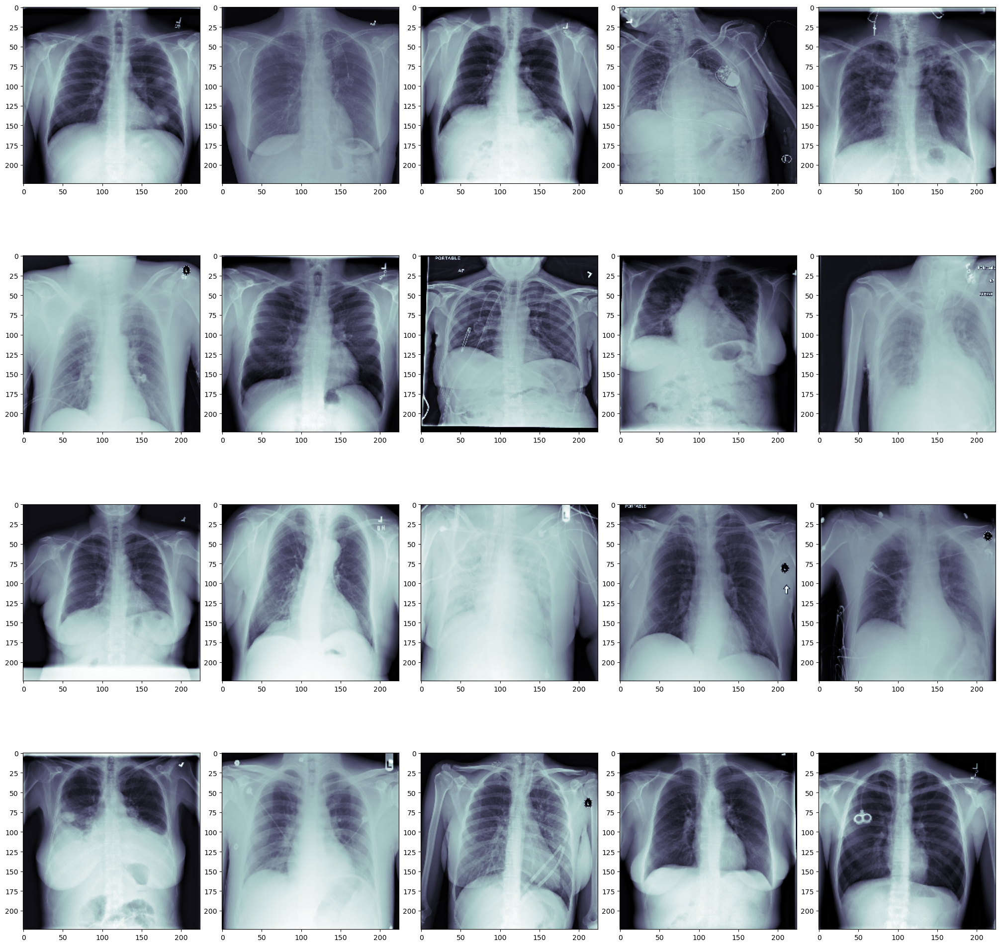

<Figure size 640x480 with 0 Axes>

,PatientID,Image_file,Full_filename
244,037d1b26-3dc7-48c2-b93c-214e7538c76d,037d1b26-3dc7-48c2-b93c-214e7538c76d.dcm,stage_2_test_images/037d1b26-3dc7-48c2-b93c-214e7538c76d.dcm
2540,2d682b94-2c9d-4bd3-8b59-bbf22616beab,2d682b94-2c9d-4bd3-8b59-bbf22616beab.dcm,stage_2_test_images/2d682b94-2c9d-4bd3-8b59-bbf22616beab.dcm
2144,282c7cf6-713a-45d3-921f-0a15c9e5ec1f,282c7cf6-713a-45d3-921f-0a15c9e5ec1f.dcm,stage_2_test_images/282c7cf6-713a-45d3-921f-0a15c9e5ec1f.dcm
1561,20214557-cbc9-45ec-a162-15b8ee795702,20214557-cbc9-45ec-a162-15b8ee795702.dcm,stage_2_test_images/20214557-cbc9-45ec-a162-15b8ee795702.dcm
327,04785916-0ae2-40b9-bd71-1698025326fa,04785916-0ae2-40b9-bd71-1698025326fa.dcm,stage_2_test_images/04785916-0ae2-40b9-bd71-1698025326fa.dcm
1143,1ad0b486-8d69-4573-9303-f0f7452676b3,1ad0b486-8d69-4573-9303-f0f7452676b3.dcm,stage_2_test_images/1ad0b486-8d69-4573-9303-f0f7452676b3.dcm
1874,245beb7f-d20b-49eb-8403-09360ec9f163,245beb7f-d20b-49eb-8403-09360ec9f163.dcm,stage_2_test_images/245beb7f-d20b-49eb-8403-09360ec9f163.dcm
301,043d020e-c61b-40ac-8704-be5ed7ded293,043d020e-c61b-40ac-8704-be5ed7ded293.dcm,stage_2_test_images/043d020e-c61b-40ac-8704-be5ed7ded293.dcm
2380,2b76e6cb-fe51-40da-bfc6-54253dee41f6,2b76e6cb-fe51-40da-bfc6-54253dee41f6.dcm,stage_2_test_images/2b76e6cb-fe51-40da-bfc6-54253dee41f6.dcm
129,018cb7c3-0ec3-484d-a6a3-bd7c376605d1,018cb7c3-0ec3-484d-a6a3-bd7c376605d1.dcm,stage_2_test_images/018cb7c3-0ec3-484d-a6a3-bd7c376605d1.dcm


In [138]:
show_images(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'})

In [66]:
img_rows=224
img_cols=224
dim = (img_rows, img_cols)

X_target = []
brk = 0
i = 1 # initialisation
for img in tqdm(dicom_test_final["Full_filename"].values): 
    
    ds_3 = dicom.dcmread(img)
    img_3 = ds_3.pixel_array
    rgb = apply_color_lut(img_3, palette='PET')
    train_img = rgb
    try:
        train_img_resize = cv2.resize(train_img, dim, interpolation=cv2.INTER_LINEAR)
    except:
        brk +=1
        print("breaking out for",img)
        break
    height_2, width_2, layers = train_img_resize.shape
    size=(width_2,height_2)
    X_target.append(train_img_resize)
    i += 1

100%|██████████████████████████████████████████████████████████████████████████████| 3000/3000 [01:12<00:00, 41.58it/s]


In [67]:
fileName = "X_test_submission.pkl"
fileObject = open(fileName, 'wb')

pkl.dump(X_target, fileObject)
fileObject.close()

In [68]:
dicom_test_final.to_pickle("dicom_test_final.pkl") # pickling the dicom test final data

In [69]:
X_target_test = np.array(X_target)

In [122]:
def test_submission_csv(pass_model,data):
    passed_sample = data
    test_submission_pred = pd.DataFrame()
    for loop_1 in passed_sample:
        pat_id_1 = loop_1
        fname = pat_id_1+".dcm"
        image_path = "stage_2_test_images/"+fname
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array
        img_for_prediction =img[tf.newaxis,...]
        img_pred_128 = np.resize(img,(img_for_prediction.shape[0],128,128,3))
        img_pred_region = pass_model.predict(img_pred_128) # Predict the BBox
        x0 = (img_pred_region[0,0])
        y0 = (img_pred_region[0,1])
        x1 = (img_pred_region[0,2])
        y1 = (img_pred_region[0,3])
        row = pd.Series([pat_id_1,x0*8,y0*8,x1*8,y1*8])
        test_submission_pred = test_submission_pred.append(row, ignore_index = True)
   
    return test_submission_pred

In [125]:
Final_Test_Submission_CSV = test_submission_csv(base_model1,dicom_test_final['PatientID'])

1/1 [==============================] - 0s 35ms/step


In [141]:
Final_Test_Submission_CSV.columns = ["Patient_ID","X","Y","Width","Height"]

In [142]:
Final_Test_Submission_CSV.to_csv("Test_Submission_Final.csv",index = False)

In [143]:
Final_Test_Submission_CSV.sample(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

Patient_ID,X,Y,Width,Height
22dc3067-7c66-4ae2-adb1-cf4754359d14,267.171570,216.469208,225.522995,249.607925
263db843-751f-4cd1-b392-548fe40d2636,388.249847,466.375885,235.598846,326.777222
c0471814-5d65-4868-94cb-e9ff37439619,283.811340,299.579376,185.577118,285.455994
1a5eef1c-c817-4c73-9e8b-d75eae0e4c0a,294.320740,272.951447,221.707230,280.564148
23c0da4c-d481-45d5-8cf8-ac77f20e424c,270.345032,302.309235,266.595032,241.008194
1a37de22-589c-4773-b97d-8334a2d674c4,294.136383,226.577957,210.520218,227.747040
04c2264b-9e77-464d-92e6-0c6cec3a2393,340.082642,294.464142,210.297058,286.055115
273bdee2-1dd4-4dd2-a29b-92a29023f6d3,189.841782,263.357239,208.102966,182.888489
2996eb94-ba9c-4d89-a9f4-531a15fec52f,342.560089,225.835434,230.418259,285.384766
1f0056d6-a405-42d6-a088-123ed42bf1c6,253.523209,268.426208,226.568756,277.237335


In [144]:
dicom_test_final.head(1)

,PatientID,Image_file,Full_filename
0,0000a175-0e68-4ca4-b1af-167204a7e0bc,0000a175-0e68-4ca4-b1af-167204a7e0bc.dcm,stage_2_test_images/0000a175-0e68-4ca4-b1af-167204a7e0bc.dcm


In [188]:
def predicted_bound_box(passed_sample):
    # Take a random sample of 5 images and print bounding box patch on images
    sample_data = random.sample(list(Final_Test_Submission_CSV['Patient_ID']), passed_sample)
    if passed_sample/5 == 0:
        z = math.ceil(passed_sample/5)
    else:
        z = math.ceil((passed_sample)/5)

    bounding_box_data = pd.DataFrame()

    fig, ax = plt.subplots(z,5,constrained_layout=True)
    fig.set_figheight(20)
    fig.set_figwidth(20)
    
    i = 0
    j = 0

    for loop_1 in sample_data:
        pat_id_1 = loop_1

        no_ind = dicom_test_final[dicom_test_final['PatientID'] == pat_id_1].index.values
        l_ind = len(no_ind)

        fname = pat_id_1+".dcm"
        image_path = "stage_2_test_images"+"/"+fname
        ds = dicom.dcmread(image_path)
        img = ds.pixel_array

        X = 0
        Y = 0
        width = 0
        height = 0
        rect = []

        for k in range(l_ind):
            X = Final_Test_Submission_CSV.iloc[no_ind[k],1]
            Y = Final_Test_Submission_CSV.iloc[no_ind[k],2]
            width = Final_Test_Submission_CSV.iloc[no_ind[k],3]
            height = Final_Test_Submission_CSV.iloc[no_ind[k],4]
            bounding_box_data = bounding_box_data.append(pd.Series([pat_id_1, l_ind,X,Y,width,height]), ignore_index = True)
            rect.append(patches.Rectangle((X, Y), width, height,linewidth = 3,edgecolor = 'y',facecolor = 'none'))
            ax[i][j].imshow(img, cmap=plt.cm.bone)
            ax[i][j].add_patch(rect[k])

        j = j+1
        if j == 5:
            i = i+1
            j = 0
    plt.figure().clear()
    plt.show()
    bounding_box_data.columns = ['Image Name','No. Of Bounding Boxes','X','Y','Width','Height']
    return(bounding_box_data)

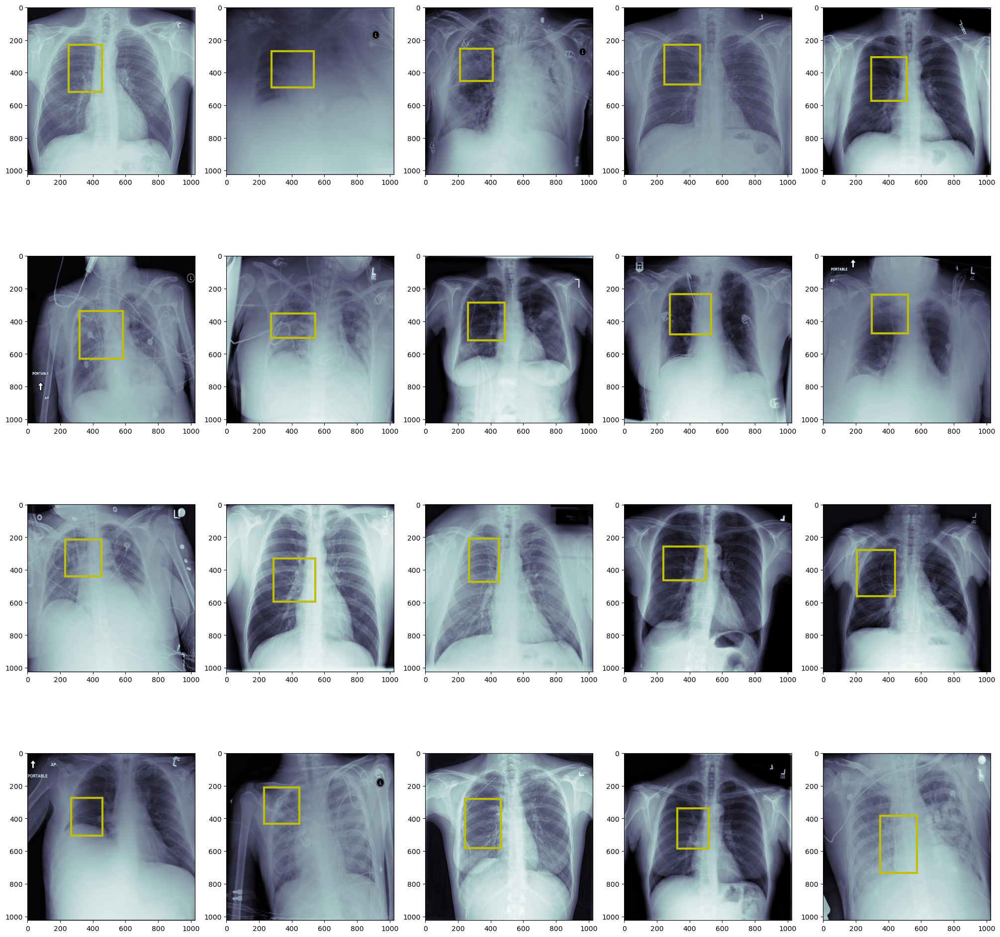

<Figure size 640x480 with 0 Axes>

Image Name,No. Of Bounding Boxes,X,Y,Width,Height
c028bb45-6dbc-4152-9bf5-3050e393c198,1,250.343033,230.100723,205.726562,289.238678
2cf1426e-9663-4c08-b37e-960e53f1225f,1,277.015747,268.668854,256.627655,222.374466
015a202d-5e18-4dcf-802c-0f7e75e14a38,1,212.086563,254.331543,201.897614,196.143906
c0a2978c-82f7-42e7-975d-c4eba156dfdd,1,244.088974,228.080078,220.683701,243.352509
24aeb8f6-24bd-488b-bef0-2e8fa59418fe,1,294.961884,306.318146,215.391434,267.564697
1ad5f416-0e7e-4f08-9e8d-abd19bbe25f5,1,318.210510,337.685699,265.675201,291.836395
1a583cd3-23d3-4789-a24f-bc7ae6fde815,1,273.241028,352.438049,269.918640,149.716599
0322a3ad-3e24-4e6d-8f24-b68e3c61d88f,1,260.395050,284.164093,225.033081,233.988403
1afcf486-18db-4ffb-93e4-3a3d6a943110,1,279.387115,234.771301,251.331192,244.148941
2179339d-e6f0-49ba-a405-bfb4845fdf5a,1,296.401459,237.253464,222.082657,237.527374


In [189]:
predicted_bound_box(20).style.set_properties(**{'border': '1.3px solid black','color': 'blue'}).hide_index()

# Step 5: Final Report

    * Final Report is submitted as seperate PDF file with all the steps performed over Milestone 1 & Milestone 2

# Observations:

    * We have 3000 images in test folder for which we have to predict the bounding box co-ordinates
    * We used MobileNet model for predicting the bounding boxes
    * After prediction, we have displayed the bounding boxes on the predicted images with yellow boxes.
    
    

# *********************************************************** THE END ********************************************************